# Experiments with Variational AutoEncoder

## Setup

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

import pandas as pd
from IPython.display import display

from torchvision.utils import make_grid
from torchvision.transforms.transforms import ToPILImage, ToTensor

from google.colab import drive
import os
import pickle

import numpy as np
import copy
import sys
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms
import torch.optim as optim

from torch.utils.data import DataLoader, random_split, ConcatDataset, SubsetRandomSampler
from sklearn.model_selection import KFold
from scipy.stats import norm
from torch.autograd import Variable
from torch.utils.data.dataloader import DataLoader
from torchvision.datasets import MNIST
from torchvision.utils import make_grid as make_image_grid
from matplotlib.backends.backend_pdf import PdfPages
from tqdm import tnrange

 ## Training and evaluation functions VAE

In [ ]:
def train_VAE_model(model, train_loader,val_loader, test_loader, VAE_criterion,eval_criterions, optimizer, device, epochs, VAE_likelihood, set_2_mean, var_2, beta, L, fold):
    outputs = []

    average_recons_losses = []  # List to store average reconstruction losses
    average_kld_losses = []     # List to store average KLD losses
    average_vae_losses = []         # List to store average total losses
    average_vae_val_losses = []
    average_recons_val_losses = []
    average_kld_val_losses = []
    average_val_losses = []

    for epoch in range(epochs):
        model.train()
        total_vae_loss = 0.0
        total_recons_loss = 0.0
        total_kld_loss = 0.0
        for images, _ in train_loader:
            x_in = images.view(images.size(0), -1).to(device)
            z_mu, z_logvar, z_samples, x_out  = model(x_in, L)
            recons_loss, kld_loss, vae_loss = VAE_criterion(x_out, x_in, z_mu, z_logvar,set_2_mean, var_2, L, VAE_likelihood, beta)
            optimizer.zero_grad()
            vae_loss.backward()
            optimizer.step()
            total_recons_loss += recons_loss.item()
            total_kld_loss += kld_loss.item()
            total_vae_loss += vae_loss.item()

        average_recons_loss = total_recons_loss / len(train_loader)
        average_kld_loss = total_kld_loss / len(train_loader)
        average_vae_loss = total_vae_loss / len(train_loader)

        average_recons_losses.append(average_recons_loss)
        average_kld_losses.append(average_kld_loss)
        average_vae_losses.append(average_vae_loss)


        print(f'Train Fold/Epoch: {fold + 1}/{epoch + 1}, Training Loss:{average_vae_loss:.6f}, Training Recons Loss: {average_recons_loss:.6f}, Training KLD Loss: {average_kld_loss:.6f}')


        # Validation phase

        #average_loss, average_vae_val_loss, average_recons_val_loss, average_kld_val_loss = eval_VAE_model(fold, model, val_loader, eval_criterions, VAE_likelihood, beta, L, device)
        average_loss, average_vae_val_loss, average_recons_val_loss, average_kld_val_loss = eval_VAE_model(fold, model, val_loader, eval_criterions, VAE_likelihood, beta, set_2_mean, var_2, L, device)
        average_loss_0 = {criterion_name_0: loss_value_0 for criterion_name_0, loss_value_0 in average_loss.items()}
        average_vae_val_losses_1 = {criterion_name_1: loss_value_1 for criterion_name_1, loss_value_1 in average_vae_val_loss.items()}
        average_recons_val_losses_2 = {criterion_name_2: loss_value_2 for criterion_name_2, loss_value_2 in average_recons_val_loss.items()}
        average_kld_val_losses_3 = {criterion_name_3: loss_value_3 for criterion_name_3, loss_value_3 in average_kld_val_loss.items()}


        average_val_losses.append(average_loss_0)
        average_vae_val_losses.append(average_vae_val_losses_1)
        average_recons_val_losses.append(average_recons_val_losses_2)
        average_kld_val_losses.append(average_kld_val_losses_3)

        print(f'Validation Fold/Epoch: {fold + 1}/{epoch + 1},  Validation Loss: {average_loss_0}, Validation VAE Loss: {average_vae_val_losses_1}, Validation Recons Loss: {average_recons_val_losses_2}, Validation KLD Loss: {average_kld_val_losses_3}')



        outputs.append((epoch, x_in, x_out))


    return outputs, average_vae_losses, average_recons_losses, average_kld_losses, average_val_losses, average_vae_val_losses, average_recons_val_losses, average_kld_val_losses

### Visualize reconstructions function VAE

In [ ]:
def VAE_visualize_original_images(test_loader, img_shape, num_samples=10, figure_size=(8, 2)):
    with torch.no_grad():
        for batch_features, _ in test_loader:
            batch_features = batch_features.view(-1, img_shape[0] * img_shape[1])
            break

    plt.figure(figsize=figure_size)
    plt.gray()

    plt.suptitle('Visualizing Original Images', fontsize=12)

    for i in range(num_samples):
        ax = plt.subplot(2, num_samples, i + 1)
        # Check if there is only one image in the batch
        if len(batch_features) == 1:
            plt.imshow(batch_features[0].numpy().reshape(img_shape))
        else:
            plt.imshow(batch_features[i].numpy().reshape(img_shape))
        plt.axis('off')

    plt.show()
def VAE_visualize_reconstructions(model, test_loader, img_shape, L, device, num_samples=10, fold_index=None, figure_size=(8, 2)):
    with torch.no_grad():
        for batch_features, _ in test_loader:
            batch_features = batch_features.to(device)
            x_in = batch_features.view(batch_features.size(0), -1)
            z_mu, z_logvar, z_samples, x_out = model(x_in, L)
            break

    plt.figure(figsize=figure_size)
    plt.gray()

    for i, (item_in, item_out) in enumerate(zip(x_in.cpu().numpy(), x_out.cpu().numpy())):
        if i >= num_samples:
            break
        # Plot original image
        if fold_index == 0:
          plt.subplot(2, num_samples, i + 1)
          item_in = item_in.reshape(img_shape)
          plt.imshow(item_in)
          plt.axis('off')

        # Plot reconstructed image for all folds
        plt.subplot(2, num_samples, num_samples + i + 1)
        item_out = item_out.reshape(img_shape)
        plt.imshow(item_out)
        plt.axis('off')

    plt.show()
img_shape = (28, 28)

### Evaluation functions VAE

In [ ]:
def eval_VAE_model(fold, model, test_loader, criterions, VAE_likelihood, beta, set_2_mean, var_2, L, device):
    model.eval()
    criterion_names = list(criterions.keys())

    average_vae_val_loss = {criterion_name: 0.0 for criterion_name in criterion_names}
    average_recons_val_loss = {criterion_name: 0.0 for criterion_name in criterion_names}
    average_kld_val_loss = {criterion_name: 0.0 for criterion_name in criterion_names}

    average_total_loss = {criterion_name: 0.0 for criterion_name in criterion_names}


    for name, criterion in criterions.items():
        total_recons_loss = 0.0
        total_kld_loss = 0.0
        total_vae_loss = 0.0

        total_loss = 0.0

        for (images, _) in test_loader:
            #x_in = Variable(images.view(images.size(0), -1))
            x_in = images.view(images.size(0), -1).to(device)
            z_mu, z_logvar, z_samples, x_out = model(x_in, L)
            x_out_flat = x_out.view(x_in.size()).to(device)

            loss = criterion(x_out_flat , x_in)

            #recons_loss, kld_loss, vae_loss = VAE_criterion(x_out, x_in, z_mu, z_logvar, L, VAE_likelihood, beta)
            recons_loss, kld_loss, vae_loss = VAE_criterion(x_out, x_in, z_mu, z_logvar, set_2_mean, var_2, L, VAE_likelihood, beta=1.0)

            total_recons_loss += recons_loss.item()
            total_kld_loss += kld_loss.item()
            total_vae_loss += vae_loss.item()

            total_loss += loss.item()

        # Calculate the average loss for this criterion
        average_recons_loss = total_recons_loss / len(test_loader)
        average_kld_loss = total_kld_loss / len(test_loader)
        average_vae_loss = total_vae_loss / len(test_loader)

        average_loss = total_loss / len(test_loader)

        # Update the dictionaries with the average values
        average_vae_val_loss[name] = average_vae_loss
        average_recons_val_loss[name] = average_recons_loss
        average_kld_val_loss[name] = average_kld_loss

        average_total_loss[name] = average_loss

    return average_total_loss, average_vae_val_loss, average_recons_val_loss, average_kld_val_loss


## Model definitions: Pytorch Classes

## Variational Autoencoder

Code Regis Djaha

In [ ]:
# Encoder class used in VAE below
# Note the forward pass, where we compute the mean and logvariance of the latent variable
class Encoder(nn.Module):
    def __init__(self, D_x, D_z, n_layers, activation):
        super(Encoder, self).__init__()
        self.D_x = D_x
        self.D_z = D_z
        self.n_layers=n_layers

        hidden_sizes = [D_x - (D_x - D_z) * i // n_layers for i in range(n_layers)] + [D_z]
        encoder_hidden_sizes = [D_x] + hidden_sizes

        encoder_layers = []
        for i in range(1, len(encoder_hidden_sizes) - 1):
            # Remove activation at the last layer of the encoder
            if i == len(encoder_hidden_sizes) - 2:
                self.fc_mean = nn.Linear(encoder_hidden_sizes[i], D_z)
                self.fc_logvar = nn.Linear(encoder_hidden_sizes[i], D_z)
            else:
                encoder_layers.extend([nn.Linear(encoder_hidden_sizes[i], encoder_hidden_sizes[i + 1]), activation()])
        #encoder_layers.pop()
        self.encoder = nn.Sequential(*encoder_layers)

    def forward(self, x_in):
        encoded = self.encoder(x_in)
        z_mean = self.fc_mean(encoded)
        z_logvar = self.fc_logvar(encoded)

        return z_mean,z_logvar


In [ ]:
# Decoder of the VAE below
# Note the forward pass, where we compute the mean and logvariance of the latent variable
class Decoder(nn.Module):
    def __init__(self, D_x, D_z, n_layers, activation):
        super(Decoder, self).__init__()
        self.D_x = D_x
        self.D_z = D_z
        self.n_layers=n_layers

        hidden_sizes = [D_x - (D_x - D_z) * i // n_layers for i in range(n_layers)] + [D_z]
        encoder_hidden_sizes = [D_x] + hidden_sizes
        decoder_hidden_sizes = encoder_hidden_sizes[::-1]

        decoder_layers = []
        for i in range(0, len(decoder_hidden_sizes) - 2):
            if i == len(decoder_hidden_sizes) - 3:
                decoder_layers.extend([nn.Linear(decoder_hidden_sizes[i], decoder_hidden_sizes[i + 1]), nn.Sigmoid()])
            else:
                decoder_layers.extend([nn.Linear(decoder_hidden_sizes[i], decoder_hidden_sizes[i + 1]), activation()])

        self.decoder = nn.Sequential(*decoder_layers)

    def forward(self, z):
      x_out = self.decoder(z)
      return x_out.view(-1, 1, int(self.D_x**0.5), int(self.D_x**0.5))


In [ ]:
# Full VAE model, based on encoder/decoder above
class VAE(nn.Module):
    def __init__(self, D_x=784, n_layers=1, D_z=2, activation=nn.ReLU):
        super(VAE, self).__init__()
        self.D_x = D_x
        self.D_z = D_z
        self.n_layers=n_layers

        encoder = Encoder(D_x, D_z, n_layers, activation)
        decoder = Decoder(D_x, D_z, n_layers, activation)

        self.encoder = encoder
        self.decoder = decoder

    def encode(self, x_in):
        return self.encoder(x_in)

    def decode(self, z):
        return self.decoder(z)

    def reparameterization(self, mean, logvar):
        sd = torch.exp(logvar * 0.5)
        epsilon = torch.randn_like(sd)
        z = epsilon.mul(sd).add_(mean)
        return z

    def forward(self, x_in, L=1):
        z_mean, z_logvar = self.encode(x_in)
        z_samples = []
        for _ in range(L):
            z = self.reparameterization(z_mean, z_logvar)
            z_samples.append(z)
        z_samples = torch.cat(z_samples, dim=0)
        x_out = self.decode(z_samples)
        x_out = x_out.view(-1, 1, int(self.D_x**0.5), int(self.D_x**0.5))
        return z_mean, z_logvar, z_samples, x_out

### VAE_criterion

In [ ]:
# VAE Criterion, as combination of reconstruction loss and KL divergence
# Note that the reconstruction loss can be based on the Gaussian or Bernoulli likelihood
# Note that the KL divergence term can be weighted by the input $\beta$ parameter
def VAE_criterion(x_out, x_in, z_mu, z_logvar, set_2_mean, var_2, L, VAE_likelihood, beta=1.0):
    recons_losses = []  # Store individual reconstruction losses

    if VAE_likelihood == "gaussian":
        for i in range(L):
            # Flatten x_in to match the shape of x_out
            x_in_flat = x_in.view(x_out[i::L].shape)
            # Calculate the mean squared error (MSE) loss for each sample
            recons_loss = F.mse_loss(x_out[i::L], x_in_flat, reduction='sum')
            recons_losses.append(recons_loss)
    elif VAE_likelihood == "bernoulli":
        for i in range(L):
            # Flatten x_in to match the shape of x_out
            x_in_flat = x_in.view(x_out[i::L].shape)
            # Calculate the binary cross-entropy loss for each sample
            recons_loss = F.binary_cross_entropy(x_out[i::L], x_in_flat, reduction='sum')
            recons_losses.append(recons_loss)

    # Calculate the mean loss over the L samples
    recons_loss = (1 / L) * sum(recons_losses)/ x_out.size(0)

    kld_loss = 0.5 * torch.sum(

        torch.pow(z_mu - set_2_mean, 2) / torch.exp(torch.log(var_2))

        + z_logvar.exp() / torch.exp(torch.log(var_2))

        - 1.0

        - z_logvar

        + torch.log(var_2)

    ) / x_out.size(0)
    loss = (recons_loss + beta * kld_loss)

    return recons_loss, kld_loss, loss


### latent space VAE model

In [ ]:
def latent_space_VAE_model(model, mean, std, test_loader, device, x,number_fold):
    model.eval()
    latent_variables = []
    labels = []

    for images, _ in test_loader:
        x_in = images.view(images.size(0), -1).to(device)
        with torch.no_grad():
            z_mean, z_logvar = model.encode(x_in)
            z = model.reparameterization(z_mean, z_logvar)
        latent_variables.append(z.cpu().numpy())
        labels.append(_.numpy())

    latent_variables = np.concatenate(latent_variables)
    labels = np.concatenate(labels)

    colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))
    colors = colormap(labels)

    # Create a figure with three subplots arranged horizontally
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))

    # Scatter plot for latent space on the left
    scatter_latent_variables = ax1.scatter(latent_variables[:, 0], latent_variables[:, 1], c=labels, cmap=colormap)
    ax1.set_xlabel("Latent Space 1")
    ax1.set_ylabel("Latent Space 2")
    ax1.set_title(f'Latent Space (z_size = {model.D_z}) for fold {number_fold}')
    cbar_mean = plt.colorbar(scatter_latent_variables)

    # Plot the distribution of the first latent variable (z[0]) in the middle subplot
    ax2.hist(latent_variables[:, 0], bins=50, density=True, alpha=0.5, color='blue', label='Latent Space 1')

    # Plot the distribution of the second latent variable (z[1]) in the right subplot
    ax3.hist(latent_variables[:, 1], bins=50, density=True, alpha=0.5, color='blue', label='Latent Space 2')

    # Overlay the normal distribution with mean=mu, std=sigma using an orange line
    mu1, mu2 = mean.numpy()[0]
    sigma1, sigma2 = std.numpy()[0]
    #x = np.linspace(-9, 9, 1000)
    y1 = (1 / (sigma1 * np.sqrt(2 * np.pi))) * np.exp(-0.5 * ((x - mu1) / sigma1) ** 2)
    y2 = (1 / (sigma2 * np.sqrt(2 * np.pi))) * np.exp(-0.5 * ((x - mu2) / sigma2) ** 2)
    ax2.plot(x, y1, color='orange', label=f'Normal Distribution (mu={mu1}, sigma={sigma1**2})')
    ax3.plot(x, y2, color='orange', label=f'Normal Distribution (mu={mu2}, sigma={sigma2**2})')


    ax2.set_xlabel("Latent Space")
    ax2.set_ylabel("Density")
    ax2.set_title(f'Distribution of Latent Space 1 (z_size = {model.D_z}) for fold {number_fold}')
    ax2.legend()


    ax3.set_xlabel("Latent Space")
    ax3.set_ylabel("Density")
    ax3.set_title(f'Distribution of Latent Space 2 (z_size = {model.D_z}) for fold {number_fold}')
    ax3.legend()

    plt.tight_layout()
    plt.show()


### Sample new data using the decoder.

In [ ]:
# def sample(model, D_z, image_to_sample=100, nrow=10):
#     with torch.no_grad():
#         z = torch.randn((image_to_sample, D_z)).to(device)
#         samples = model.decoder(z).cpu().view(image_to_sample, 1, 28, 28)
#         grid = make_grid(samples, nrow=nrow)

#         # Convert image to RGBA format and set background to white
#         image = ToPILImage()(grid)
#         image = image.convert("RGBA")
#         datas = image.getdata()
#         new_data = []
#         for item in datas:
#             # Set non-white pixels to white
#             if item[0] < 100 and item[1] < 100 and item[2] < 100:
#                 new_data.append((255, 255, 255, 0))
#             else:
#                 new_data.append(item)
#         image.putdata(new_data)
#         image = image.convert("RGB")

#         return image

In [ ]:
def sample(model, mu, std, D_z, image_to_sample=100, nrow=10):
    with torch.no_grad():
        z = torch.randn((image_to_sample, D_z)).to(device) * std + mu
        samples = model.decoder(z).cpu().view(image_to_sample, 1, 28, 28)
        grid = make_grid(samples, nrow=nrow)

        # Convert image to RGBA format and set background to white
        image = ToPILImage()(grid)
        image = image.convert("RGBA")
        datas = image.getdata()
        new_data = []
        for item in datas:
            # Set non-white pixels to white
            if item[0] < 100 and item[1] < 100 and item[2] < 100:
                new_data.append((255, 255, 255, 0))
            else:
                new_data.append(item)
        image.putdata(new_data)
        image = image.convert("RGB")

        return image

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

In [ ]:
def VAE_visualize_latent_space(model, device):
    z1_range = np.linspace(-2, 2, 21)
    z2_range = np.linspace(-2, 2, 21)
    results = []

    with torch.no_grad():
        for z1 in z1_range:
            for z2 in z2_range:
                results.append(model.decoder(torch.tensor([[z1, z2]], device=device, dtype=torch.float32)).view(-1, 1, 28, 28))

    image = ToPILImage()(make_grid(torch.cat(results, dim=0), 21))

    # Convert image to RGBA format and set background to white
    image = image.convert("RGBA")
    datas = image.getdata()
    new_data = []
    for item in datas:
        # Set non-white pixels to white
        if item[0] < 100 and item[1] < 100 and item[2] < 100:
            new_data.append((255, 255, 255, 50))
        else:
            new_data.append(item)
    image.putdata(new_data)
    image = image.convert("RGB")

    plt.imshow(image)
    plt.xticks([2 + (28/2) + (28+2) * ii for ii in range(len(z2_range))], [f'{x:.1f}' for x in z2_range])
    plt.yticks([2 + (28/2) + (28+2) * ii for ii in range(len(z1_range))], [f'{x:.1f}' for x in z1_range])
    plt.xticks([])
    plt.yticks([])
    plt.xlabel(r'$z_2$')
    plt.ylabel(r'$z_1$')
    plt.show()

### VAE k_fold_cross_validation

In [ ]:
def VAE_k_fold_cross_validation(model_class, model_config, train_dataset, test_dataset, VAE_criterion, learning_rate, training_setup, beta, set_2_mean, var_2, L, k_folds, batch_size,
                            eval_criterions={
        'MSE': torch.nn.MSELoss(),
        'L1 Loss': torch.nn.L1Loss(),
        'BCE': torch.nn.BCELoss()
    }):
    # Set up k-fold cross-validation
    kf = KFold(n_splits=k_folds, shuffle=True, random_state=42)

    # Initialize a list to store models and losses
    models = []
    fold_results = []

    # Perform k-fold cross-validation
    for fold, (train_indices, val_indices) in enumerate(kf.split(train_dataset)):
        print(f"Fold {fold + 1}/{k_folds}")

        # Split dataset into training and validation sets
        train_subset = torch.utils.data.Subset(train_dataset, train_indices)
        val_subset = torch.utils.data.Subset(train_dataset, val_indices)

        # Create data loaders
        train_loader_fold = DataLoader(train_subset, batch_size=batch_size, shuffle=True)
        print(len(train_loader_fold.dataset))
        val_loader_fold = DataLoader(val_subset, batch_size=batch_size, shuffle=False)
        print(len(val_loader_fold.dataset))
        test_loader_fold = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
        print(test_loader_fold.dataset)

        # Initialize autoencoder model

        model = model_class(**model_config).to(training_setup['device'])

        # Define loss function and optimizer after initializing the model
        criterion = VAE_criterion
        optimizer = optim.Adam(model.parameters(), lr=learning_rate)

        # Initialize test_losses_fold
        test_losses_fold_1 = []
        test_vae_losses_fold_1 = []
        test_recons_losses_fold_1 = []
        test_kld_losses_fold_1 = []
        val_losses_fold_1 = []
        val_vae_losses_fold_1 = []
        val_recons_losses_fold_1 = []
        val_kld_losses_fold_1 = []

        # Train the model for k-fold cross-validation
        train_outputs_fold, train_vae_losses_fold, train_recons_losses_fold, train_kld_losses_fold, val_losses_fold, val_vae_losses_fold, val_recons_losses_fold, val_kld_losses_fold = train_VAE_model(
            model,
            train_loader_fold,
            val_loader_fold,
            test_loader_fold,
            criterion,
            eval_criterions,
            optimizer,
            training_setup['device'],
            training_setup['epochs'],
            training_setup['VAE_likelihood'],
            set_2_mean,
            var_2,
            beta,
            L,
            fold
        )
        # Test and validate the model for k-fold cross-validation
        val_losses_fold_1, val_vae_losses_fold_1, val_recons_losses_fold_1, val_kld_losses_fold_1 = eval_VAE_model(fold,
                                           model,
                                           val_loader_fold,
                                           eval_criterions,
                                           training_setup['VAE_likelihood'],
                                           beta,
                                           set_2_mean,
                                           var_2,
                                           L,
                                           training_setup['device'])
        val_losses_0 = {criterion_name_0: loss_value_0 for criterion_name_0, loss_value_0 in val_losses_fold_1.items()}
        val_vae_losses_1 = {criterion_name_1: loss_value_1 for criterion_name_1, loss_value_1 in val_vae_losses_fold_1.items()}
        recons_val_losses_2 = {criterion_name_2: loss_value_2 for criterion_name_2, loss_value_2 in val_recons_losses_fold_1.items()}
        kld_val_losses_3 = {criterion_name_3: loss_value_3 for criterion_name_3, loss_value_3 in val_kld_losses_fold_1.items()}
        print(f'Validation results for fold {fold +1}, Validation Loss: {val_losses_0}, Validation Average VAE Loss: {val_vae_losses_1}, Validation Average Recons Loss: {recons_val_losses_2}, Validation Average KLD Loss: {kld_val_losses_3}')

        test_losses_fold_1, test_vae_losses_fold_1, test_recons_losses_fold_1, test_kld_losses_fold_1 = eval_VAE_model(fold,
                                                                                   model,
                                                                                   test_loader_fold,
                                                                                   eval_criterions,
                                                                                   training_setup['VAE_likelihood'],
                                                                                   beta,
                                                                                   set_2_mean,
                                                                                   var_2,
                                                                                   L,
                                                                                   training_setup['device'])
        test_losses_0 = {criterion_name_0: loss_value_0 for criterion_name_0, loss_value_0 in test_losses_fold_1.items()}
        test_vae_losses_1 = {criterion_name_1: loss_value_1 for criterion_name_1, loss_value_1 in test_vae_losses_fold_1.items()}
        recons_test_losses_2 = {criterion_name_2: loss_value_2 for criterion_name_2, loss_value_2 in test_recons_losses_fold_1.items()}
        kld_test_losses_3 = {criterion_name_3: loss_value_3 for criterion_name_3, loss_value_3 in test_kld_losses_fold_1.items()}
        print(f'Test results for fold {fold +1}, Testing Loss: {test_losses_0}, Testing Average VAE Loss: {test_vae_losses_1}, Testing Average Recons Loss: {recons_test_losses_2}, Testing Average KLD Loss: {kld_test_losses_3}')


        # Save the model from this fold
        models.append(model)
        fold_results.append({
            "outputs": train_outputs_fold,
            "train_recons_losses_fold": train_recons_losses_fold,
            "train_kld_losses_fold": train_kld_losses_fold,
            "train_losses_fold": train_vae_losses_fold,
            "val_fold": val_losses_fold,
            "val_losses_fold": val_vae_losses_fold,
            "val_recons_losses_fold": val_recons_losses_fold,
            "val_kld_losses_fold": val_kld_losses_fold,
            "metrics_val_results": val_losses_0,
            "val_results": val_vae_losses_1 ,
            "val_recons_results": recons_val_losses_2,
            "val_kld_results": kld_val_losses_3,
            "metrics_test_results": test_losses_0,
            "test_results": test_vae_losses_1,
            "test_recons_results": recons_test_losses_2,
            "test_kld_results": kld_test_losses_3,
        })

    return models, fold_results


## plot mean and std VAE

In [ ]:
def VAE_plot_mean_std(data, title, ax, label, epochs, plot_std=True):
    mean_data = np.mean(data, axis=0)
    std_data = np.std(data, axis=0)
    ax.plot(epochs, mean_data, label=label)

    if plot_std:
        ax.fill_between(
            epochs,
            mean_data - std_data,
            mean_data + std_data,
            alpha=0.3,
            label='Standard Deviation'
        )

    ax.set_title(title)
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))  # x-axis ticks to integers

def VAE_plot_results(kfold_results, loss_type='MSE'):

    # trin each epoch
    train_losses = []
    train_recons_losses = []
    train_kld_losses = []

    # valid each epoch
    val_losses = []
    val_recons_losses = []
    val_kld_losses = []

    # valid result
    valid_result = []
    recons_valid_result = []
    kld_valid_result = []

    # test result
    test_result = []
    recons_test_result = []
    kld_test_result = []

    # valid results metrics
    valid_metrics = []

    # test result metrics
    test_metrics = []

    epochs = None

    for fold_result in kfold_results:
        train_losses.append(fold_result['train_losses_fold'])
        train_recons_losses.append(fold_result['train_recons_losses_fold'])
        train_kld_losses.append(fold_result['train_kld_losses_fold'])


        if isinstance(fold_result['val_losses_fold'], list):
            val_losses.append([val[loss_type] for val in fold_result['val_losses_fold']])
        else:
            val_losses.append(fold_result['val_losses_fold'][loss_type])

        if isinstance(fold_result['val_recons_losses_fold'], list):
            val_recons_losses.append([val[loss_type] for val in fold_result['val_recons_losses_fold']])
        else:
            val_recons_losses.append(fold_result['val_recons_losses_fold'][loss_type])

        if isinstance(fold_result['val_kld_losses_fold'], list):
            val_kld_losses.append([val[loss_type] for val in fold_result['val_kld_losses_fold']])
        else:
            val_kld_losses.append(fold_result['val_kld_losses_fold'][loss_type])

            # valid result

        if isinstance(fold_result['val_results'], list):
            valid_result.append([val[loss_type] for val in fold_result['val_results']])
        else:
            valid_result.append(fold_result['val_results'][loss_type])

        if isinstance(fold_result['val_recons_results'], list):
            recons_valid_result.append([val[loss_type] for val in fold_result['val_recons_results']])
        else:
            recons_valid_result.append(fold_result['val_recons_results'][loss_type])

        if isinstance(fold_result['val_kld_results'], list):
            kld_valid_result.append([val[loss_type] for val in fold_result['val_kld_results']])
        else:
            kld_valid_result.append(fold_result['val_kld_results'][loss_type])

        # test result
        if isinstance(fold_result['test_results'], list):
            test_result.append([val[loss_type] for val in fold_result['test_results']])
        else:
            test_result.append(fold_result['test_results'][loss_type])

        if isinstance(fold_result['test_recons_results'], list):
            recons_test_result.append([val[loss_type] for val in fold_result['test_recons_results']])
        else:
            recons_test_result.append(fold_result['test_recons_results'][loss_type])

        if isinstance(fold_result['test_kld_results'], list):
            kld_test_result.append([val[loss_type] for val in fold_result['test_kld_results']])
        else:
            kld_test_result.append(fold_result['test_kld_results'][loss_type])

            # valid results metrics

         # valid result
        if isinstance(fold_result['metrics_val_results'], list):
            valid_metrics.append([val[loss_type] for val in fold_result['metrics_val_results']])
        else:
            valid_metrics.append(fold_result['metrics_val_results'][loss_type])

        # test result
        if isinstance(fold_result['metrics_test_results'], list):
            test_metrics.append([val[loss_type] for val in fold_result['metrics_test_results']])
        else:
            test_metrics.append(fold_result['metrics_test_results'][loss_type])

        if epochs is None:
            epochs = np.arange(1, len(train_recons_losses[0]) + 1)

    # Convert lists to numpy arrays
    train_losses = np.array(train_losses)
    train_recons_losses = np.array(train_recons_losses)
    train_kld_losses = np.array(train_kld_losses)


    val_losses = np.array(val_losses)
    val_recons_losses = np.array(val_recons_losses)
    val_kld_losses = np.array(val_kld_losses)

    valid_result = np.array(valid_result)
    recons_valid_result = np.array(recons_valid_result)
    kld_valid_result = np.array(kld_valid_result)

    test_result = np.array(test_result)
    recons_test_result = np.array(recons_test_result)
    kld_test_result = np.array(kld_test_result)

    valid_metrics = np.array(valid_metrics)
    test_metrics = np.array(test_metrics)

     # Calculate mean for validation
    mean_valid_metrics = np.mean(valid_metrics)
    std_valid_metrics = np.std(valid_metrics)

    mean_valid_result = np.mean(valid_result)
    std_valid_result = np.std(valid_result)

    mean_recons_valid_result = np.mean(recons_valid_result)
    std_recons_valid_result = np.std(recons_valid_result)

    mean_kld_valid_result = np.mean(kld_valid_result)
    std_kld_valid_result = np.std(kld_valid_result)

    # Calculate mean for testing
    mean_test_metrics = np.mean(test_metrics)
    std_test_metrics = np.std(test_metrics)

    mean_test_result = np.mean(test_result)
    std_test_result = np.std(test_result)

    mean_recons_test_result = np.mean(recons_test_result)
    std_recons_test_result = np.std(recons_test_result)

    mean_kld_test_result = np.mean(kld_test_result)
    std_kld_test_result = np.std(kld_test_result)

    return {
        'mean_valid_metrics': mean_valid_metrics,
        'std_valid_metrics': std_valid_metrics,
        'mean_valid_result': mean_valid_result,
        'std_valid_result': std_valid_result,
        'mean_recons_valid_result': mean_recons_valid_result,
        'std_recons_valid_result': std_recons_valid_result,
        'mean_kld_valid_result': mean_kld_valid_result,
        'std_kld_valid_result': std_kld_valid_result,
        'mean_test_metrics ': mean_test_metrics ,
        'std_test_metrics': std_test_metrics,
        'mean_test_result': mean_test_result,
        'std_test_result': std_test_result,
        'mean_recons_test_result': mean_recons_test_result,
        'std_recons_test_result': std_recons_test_result,
        'mean_kld_test_result': mean_kld_test_result,
        'std_kld_test_result': std_kld_test_result,
        'epochs': epochs,
        'train_losses': train_losses,
        'train_recons_losses':train_recons_losses,
        'train_kld_losses': train_kld_losses,
        'val_losses': val_losses,
        'val_recons_losses': val_recons_losses,
        'val_kld_losses': val_kld_losses,
        'valid_result': valid_result,
        'recons_valid_result': recons_valid_result,
        'kld_valid_result': kld_valid_result,
        'test_result': test_result,
        'recons_test_result': recons_test_result,
        'kld_test_result': kld_test_result,
        'valid_metrics': valid_metrics,
        'test_metrics': test_metrics,
    }
def highlight_min(s):
    is_min = s == s.min()
    return ['background-color: lightgreen' if v else '' for v in is_min]

def print_evaluation_table(valid_metrics, test_metrics, valid_result, test_result, recons_valid_result, recons_test_result,kld_valid_result, kld_test_result):
    # Calculate mean and standard deviation for Validation Loss and Test Loss
    mean_valid_metrics_loss = np.mean(valid_metrics)
    std_valid_metrics_loss = np.std(valid_metrics)
    mean_valid_loss = np.mean(valid_result)
    std_valid_loss = np.std(valid_result)
    mean_recons_valid_result_loss = np.mean(recons_valid_result)
    std_recons_valid_result_loss = np.std(recons_valid_result)
    mean_kld_valid_result_loss = np.mean(kld_valid_result)
    std_kld_valid_result_loss = np.std(kld_valid_result)

    mean_test_metrics_loss = np.mean(test_metrics)
    std_test_metrics_loss = np.std(test_metrics)
    mean_test_loss = np.mean(test_result)
    std_test_loss = np.std(test_result)
    mean_recons_test_result_loss = np.mean(recons_valid_result)
    std_recons_test_result_loss = np.std(recons_valid_result)
    mean_kld_test_result_loss = np.mean(kld_test_result)
    std_kld_test_result_loss = np.std(kld_test_result)

    # Create a DataFrame for mean and standard deviation
    evaluation_summary_dict = {
    'Metric': ['Mean', 'Standard Deviation'],
    'Validation Metrics Loss': [mean_valid_metrics_loss, std_valid_metrics_loss],
    'Test Metrics Loss': [mean_test_metrics_loss, std_test_metrics_loss],
    'Validation VAE Loss': [mean_valid_loss, std_valid_loss],
    'Test VAE Loss': [mean_test_loss, std_test_loss],
    'Validation Recons Loss': [mean_recons_valid_result_loss, std_recons_valid_result_loss],
    'Test Recons Loss': [mean_recons_test_result_loss, std_recons_test_result_loss],
    'Validation KLD Loss': [mean_kld_valid_result_loss, std_kld_valid_result_loss],
    'Test KLD Loss': [mean_kld_test_result_loss, std_kld_test_result_loss]
}

    df_summary = pd.DataFrame(evaluation_summary_dict)

    # Print the mean and standard deviation table
    print("\nMean and Standard Deviation Table:")
    print(df_summary.to_string(index=False))


    # Print the detailed evaluation table with highlighted rows
    min_val_loss_index = np.argmin(valid_result)
    evaluation_dict = {
        'Fold': np.arange(1, len(valid_result) + 1),
        'Validation Metrics Loss': valid_metrics,
        'Test Metrics Loss': test_metrics,
        'Validation Loss': valid_result,
        'Test Loss': test_result
    }

    df = pd.DataFrame(evaluation_dict)


    # Display the Detailed Evaluation Table with proper styling
    styles = [
        dict(selector=f'.row{min_val_loss_index + 2}', props=[('background-color', 'lightgreen')])
    ]
    #df_styled = df.style.set_table_styles(styles, axis=1)
    df_styled = df.style.apply(highlight_min, subset=['Validation Loss'], axis=0)

    print("\nDetailed Evaluation Table:")
    display(df_styled)

## Experiments with MNIST

### Set our seed and other configurations for reproducibility.

In [ ]:
seed = 42
torch.manual_seed(seed)
torch.backends.cudnn.benchmark = False
torch.backends.cudnn.deterministic = True

### Dataset

#### We load our MNIST dataset using the torchvision package.

#### We need to specify the batch size for the dataloader first

In [ ]:
batch_size=64

In [ ]:
# Load MNIST Training data
# Note that we shuffle the training data
train_loader = DataLoader(
    MNIST(
      root='./data',
      train=True,
      download=True,
      transform=transforms.ToTensor()),
       batch_size=batch_size,
       shuffle=True
    )

100%|██████████| 9912422/9912422 [00:00<00:00, 34878718.30it/s]


Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw



100%|██████████| 28881/28881 [00:00<00:00, 45746107.94it/s]


Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 30869967.36it/s]


Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 14676832.64it/s]

Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw



In [ ]:
# Load MNIST Test data
# Note that we DO NOT shuffle the test data
test_loader = DataLoader(
    MNIST(
      root='./data',
      train=False,
      download=True,
      transform=transforms.ToTensor()),
      batch_size=batch_size,
      shuffle=False
    )

#### Total number of images in the training and testing sets

In [ ]:
print("Total number of training images:", len(train_loader.dataset))
print("Total number of testing images:", len(test_loader.dataset))

Total number of training images: 60000
Total number of testing images: 10000


In [ ]:
examples = iter(train_loader)
example_data, example_targets = next(examples)
print(example_data.shape)
print(example_targets)

torch.Size([64, 1, 28, 28])
tensor([1, 2, 8, 5, 2, 6, 9, 9, 9, 4, 0, 3, 9, 9, 5, 6, 7, 8, 8, 9, 2, 6, 9, 3,
        0, 5, 0, 7, 6, 1, 2, 0, 7, 4, 6, 0, 6, 9, 7, 0, 7, 3, 2, 5, 9, 0, 4, 8,
        3, 6, 4, 0, 3, 2, 6, 6, 3, 2, 2, 3, 6, 7, 8, 4])


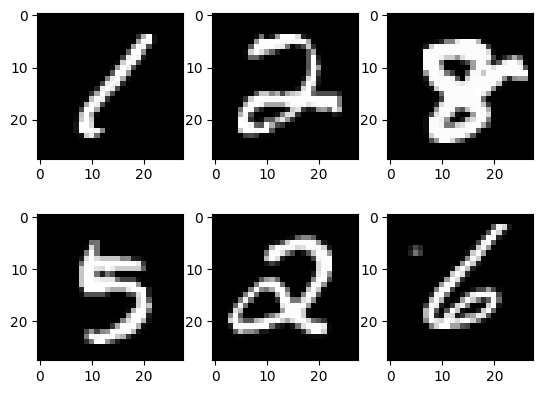

In [ ]:
for i in range(6):
    plt.subplot(2,3,i+1)
    plt.imshow(example_data[i][0], cmap='gray')
plt.show()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Experiments 1 : AE with n_layers =1

- We evaluate the performance of both the autoencoder and the variational autoencoder by systematically varying the latent space dimensionality (Dz) across different values, specifically {2, 8, 16, 32, 64}. Additionally, for this assessment, we set the number of layers (n_layer) to be equal to 1, considering likelihoods modeled as Gaussian and Bernoulli.

### Experiments with MNIST: Variational Autoencoder

## Test 3 VAE: MSE

### Experiment 3.1 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=2, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_1 = 'VAE'
model_config_3_1 = {'D_x': 784, 'n_layers': 1, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
#set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
set_2_mean = torch.tensor([5,10], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)
#std_2 = torch.tensor([0.5,0.2], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_3_1, fold_results_3_1 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_1),
                                                model_config=model_config_3_1,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=1,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })


Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:319.406822, Training Recons Loss: 300.752928, Training KLD Loss: 18.653895
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.06784257241227526, 'L1 Loss': 0.15495751956675916, 'BCE': 0.2679924560671157}, Validation VAE Loss: {'MSE': 215.85098055575756, 'L1 Loss': 215.85719299316406, 'BCE': 215.86182858081574}, Validation Recons Loss: {'MSE': 210.0952377319336, 'L1 Loss': 210.10145049399517, 'BCE': 210.10608608164685}, Validation KLD Loss: {'MSE': 5.755741974140736, 'L1 Loss': 5.755741974140736, 'BCE': 5.755741974140736}
Train Fold/Epoch: 1/2, Training Loss:212.814289, Training Recons Loss: 207.651423, Training KLD Loss: 5.162865
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.06583597511053085, 'L1 Loss': 0.14888494287399537, 'BCE': 0.26052153062947253}, Validation VAE Loss: {'MSE': 20

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_1.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_1.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_1, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_1, f)


## Visualizing reconstructions for all fold

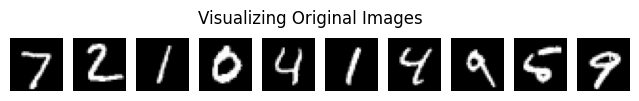

Visualizing reconstructions for fold 1


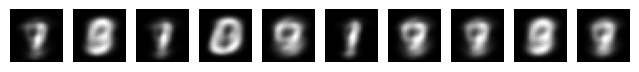

Visualizing reconstructions for fold 2


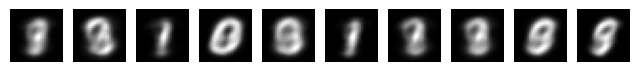

Visualizing reconstructions for fold 3


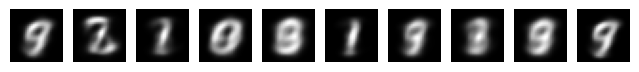

Visualizing reconstructions for fold 4


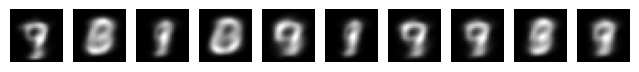

Visualizing reconstructions for fold 5


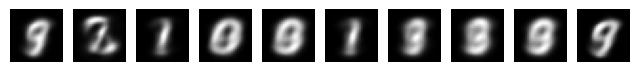

Visualizing reconstructions for fold 6


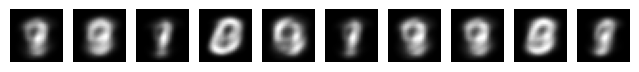

Visualizing reconstructions for fold 7


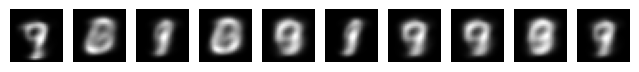

Visualizing reconstructions for fold 8


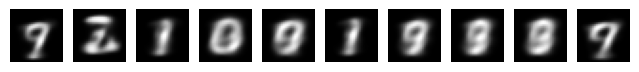

Visualizing reconstructions for fold 9


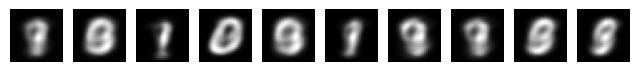

Visualizing reconstructions for fold 10


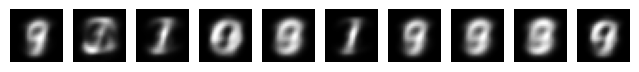

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_1.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_1 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_1):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

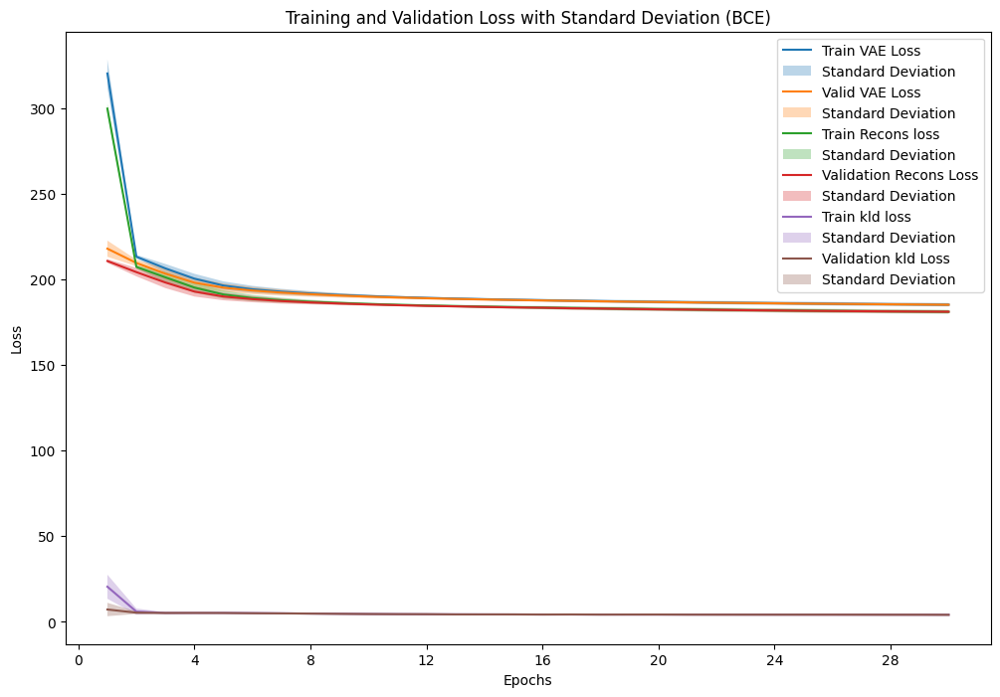

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_1.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_1 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_1_1 = VAE_plot_results(fold_results_3_1, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_1_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_1_1['epochs'])
    VAE_plot_mean_std(result_data_3_1_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_1_1['epochs'])
    VAE_plot_mean_std(result_data_3_1_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_1_1['epochs'])
    VAE_plot_mean_std(result_data_3_1_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_1_1['epochs'])
    VAE_plot_mean_std(result_data_3_1_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_1_1['epochs'])
    VAE_plot_mean_std(result_data_3_1_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_1_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_1_1['valid_metrics'],
    result_data_3_1_1['test_metrics'],
    result_data_3_1_1['valid_result'],
    result_data_3_1_1['test_result'],
    result_data_3_1_1['recons_valid_result'],
    result_data_3_1_1['recons_test_result'],
    result_data_3_1_1['kld_valid_result'],
    result_data_3_1_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.231019           0.230375            185.20831     184.707077              181.118769        181.118769             4.089541       4.093151
Standard Deviation                 0.001165           0.001520              0.82530       1.022661                0.913125          0.913125             0.219437       0.197776

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.232123,0.231537,185.806182,185.427623
1,2,0.231808,0.231531,185.704865,185.432612
2,3,0.231580,0.230171,185.774215,184.682633
3,4,0.229317,0.228899,183.890493,183.562972
4,5,0.231360,0.231103,185.423070,185.220780
5,6,0.232534,0.231584,186.414946,185.637980
6,7,0.228777,0.228236,183.708752,183.260731
7,8,0.230345,0.227512,185.141178,182.887099
8,9,0.230638,0.231087,184.676356,185.045450
9,10,0.231707,0.232088,185.543039,185.912893


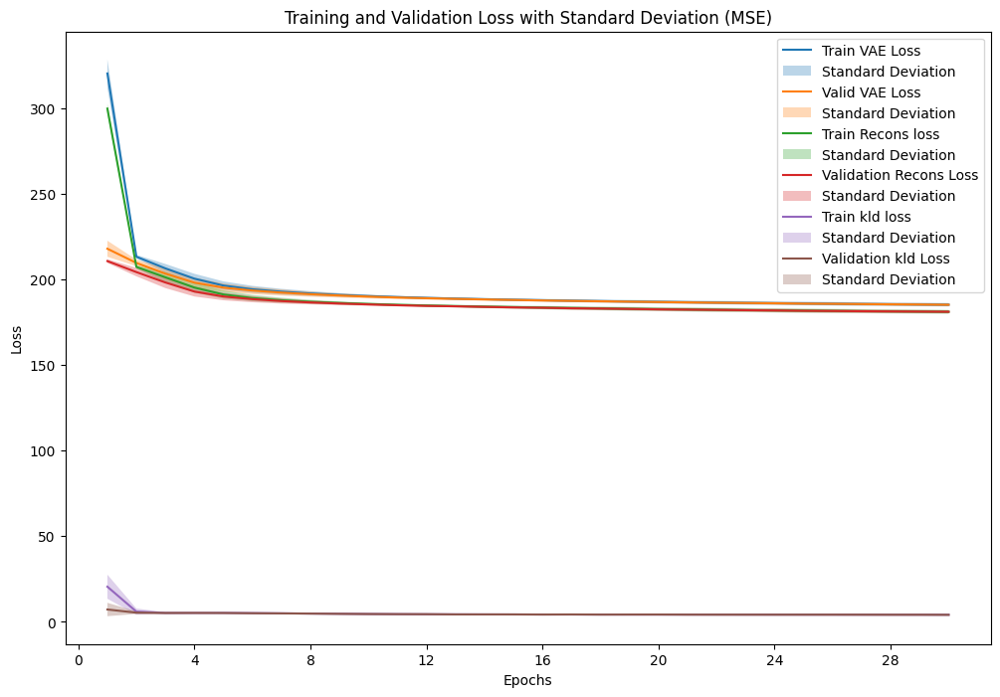

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_1.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_1 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_1_2 = VAE_plot_results(fold_results_3_1, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_1_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_1_2['epochs'])
    VAE_plot_mean_std(result_data_3_1_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_1_2['epochs'])
    VAE_plot_mean_std(result_data_3_1_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_1_2['epochs'])
    VAE_plot_mean_std(result_data_3_1_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_1_2['epochs'])
    VAE_plot_mean_std(result_data_3_1_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_1_2['epochs'])
    VAE_plot_mean_std(result_data_3_1_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_1_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_1_2['valid_metrics'],
    result_data_3_1_2['test_metrics'],
    result_data_3_1_2['valid_result'],
    result_data_3_1_2['test_result'],
    result_data_3_1_2['recons_valid_result'],
    result_data_3_1_2['recons_test_result'],
    result_data_3_1_2['kld_valid_result'],
    result_data_3_1_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.056962           0.056939           185.222936     184.707554              181.133395        181.133395             4.089541       4.093151
Standard Deviation                 0.000246           0.000404             0.804006       1.011850                0.887970          0.887970             0.219437       0.197776

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.057090,0.057113,185.799394,185.412862
1,2,0.057267,0.057423,185.637997,185.466451
2,3,0.057014,0.056851,185.791879,184.739271
3,4,0.056641,0.056646,183.888784,183.573432
4,5,0.056891,0.057103,185.457531,185.177367
5,6,0.057386,0.057289,186.424081,185.648788
6,7,0.056561,0.056463,183.796022,183.233596
7,8,0.056852,0.056078,185.196015,182.933635
8,9,0.057086,0.057280,184.731690,185.018488
9,10,0.056828,0.057148,185.505971,185.871646


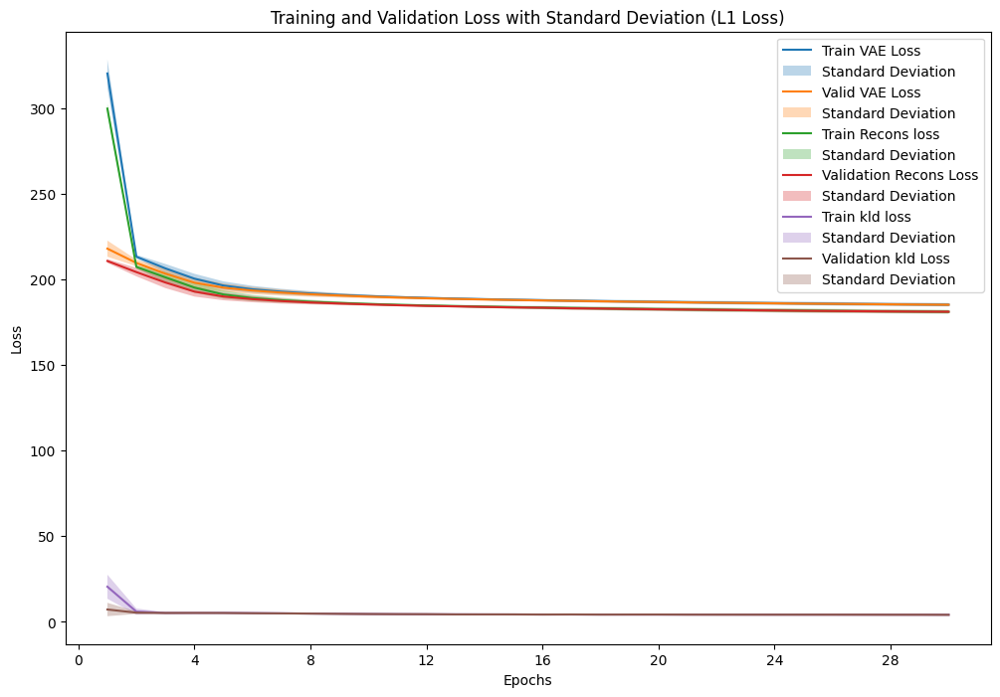

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_1.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_1 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_1_3 = VAE_plot_results(fold_results_3_1, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_1_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_1_3['epochs'])
    VAE_plot_mean_std(result_data_3_1_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_1_3['epochs'])
    VAE_plot_mean_std(result_data_3_1_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_1_3['epochs'])
    VAE_plot_mean_std(result_data_3_1_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_1_3['epochs'])
    VAE_plot_mean_std(result_data_3_1_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_1_3['epochs'])
    VAE_plot_mean_std(result_data_3_1_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_1_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_1_3['valid_metrics'],
    result_data_3_1_3['test_metrics'],
    result_data_3_1_3['valid_result'],
    result_data_3_1_3['test_result'],
    result_data_3_1_3['recons_valid_result'],
    result_data_3_1_3['recons_test_result'],
    result_data_3_1_3['kld_valid_result'],
    result_data_3_1_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.129646           0.129661           185.208487     184.701773              181.118946        181.118946             4.089541       4.093151
Standard Deviation                 0.000488           0.000673             0.808462       1.021136                0.895536          0.895536             0.219437       0.197776

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.129997,0.130048,185.827425,185.437578
1,2,0.129571,0.129820,185.631638,185.483551
2,3,0.129043,0.128841,185.756404,184.728756
3,4,0.129237,0.129242,183.914940,183.576651
4,5,0.129497,0.129763,185.397597,185.190887
5,6,0.130680,0.130557,186.449634,185.610342
6,7,0.128943,0.128899,183.776235,183.223112
7,8,0.129674,0.128647,185.133447,182.887228
8,9,0.129870,0.130396,184.684507,185.006893
9,10,0.129944,0.130402,185.513048,185.872728


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_1 = sum(p.numel() for p in models_3_1[0].parameters())
print(f"Number of parameters in the model: {total_params_3_1}")

Number of parameters in the model: 5492


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


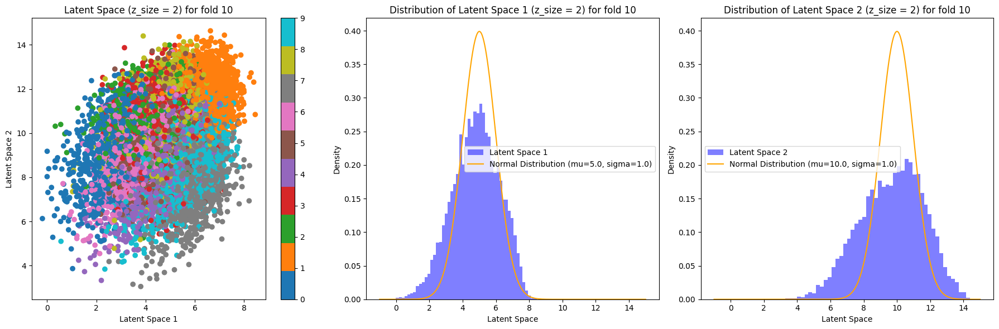

In [ ]:
x = np.linspace(-1, 15, 1000)
set_2_mean = torch.tensor([[5,10]], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_1[6], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

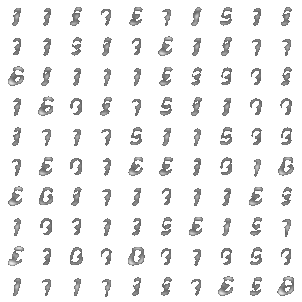

In [ ]:
set_2_mean = torch.tensor([5,10], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_1[6], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

In [ ]:
def VAE_visualize_latent_space(model, device):
    z1_range = np.linspace(-1, 15, 21)
    z2_range = np.linspace(-1, 15, 21)
    results = []

    with torch.no_grad():
        for z1 in z1_range:
            for z2 in z2_range:
                results.append(model.decoder(torch.tensor([[z1, z2]], device=device, dtype=torch.float32)).view(-1, 1, 28, 28))

    image = ToPILImage()(make_grid(torch.cat(results, dim=0), 21))

    # Convert image to RGBA format and set background to white
    image = image.convert("RGBA")
    datas = image.getdata()
    new_data = []
    for item in datas:
        # Set non-white pixels to white
        if item[0] < 100 and item[1] < 100 and item[2] < 100:
            new_data.append((255, 255, 255, 50))
        else:
            new_data.append(item)
    image.putdata(new_data)
    image = image.convert("RGB")

    plt.imshow(image)
    plt.xticks([2 + (28/2) + (28+2) * ii for ii in range(len(z2_range))], [f'{x:.1f}' for x in z2_range])
    plt.yticks([2 + (28/2) + (28+2) * ii for ii in range(len(z1_range))], [f'{x:.1f}' for x in z1_range])
    plt.xticks([])
    plt.yticks([])
    plt.xlabel(r'$z_2$')
    plt.ylabel(r'$z_1$')
    plt.show()

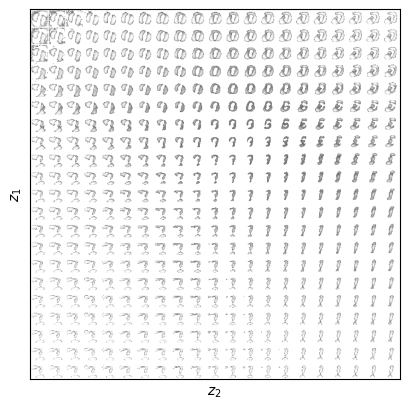

In [ ]:
VAE_visualize_latent_space(models_3_1[6], device)

### Experiment 3.2 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=8, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_2 = 'VAE'
model_config_3_2 = {'D_x': 784, 'n_layers': 1, 'D_z': 32, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
#set_2_mean = torch.ones((1, 32), dtype=torch.float32)
#set_2_mean = torch.tensor([5,10], dtype=torch.float32)
set_2_mean = torch.randn([1, 32], dtype=torch.float32)

std_2 = torch.ones((1, 32), dtype=torch.float32)
#std_2 = torch.tensor([0.5,0.2], dtype=torch.float32)
#std_2 = torch.randn([1, 32], dtype=torch.float32)
models_3_2, fold_results_3_2 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_2),
                                                model_config=model_config_3_2,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=10,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })

Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:250.679256, Training Recons Loss: 236.299088, Training KLD Loss: 1.438017
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.06382317868794532, 'L1 Loss': 0.14994156408183118, 'BCE': 0.25733331559186284}, Validation VAE Loss: {'MSE': 202.9100608014046, 'L1 Loss': 202.63409683552194, 'BCE': 202.74063094118807}, Validation Recons Loss: {'MSE': 201.9187503571206, 'L1 Loss': 201.64278639123796, 'BCE': 201.7493204969041}, Validation KLD Loss: {'MSE': 0.9913105026204535, 'L1 Loss': 0.9913105026204535, 'BCE': 0.9913105026204535}
Train Fold/Epoch: 1/2, Training Loss:206.750126, Training Recons Loss: 194.571192, Training KLD Loss: 1.217894
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.05926986843189026, 'L1 Loss': 0.13538156370533275, 'BCE': 0.24069079217758585}, Validation VAE Loss: {'MSE': 1

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_2.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_2.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_2, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_2, f)


## Visualizing reconstructions for all fold

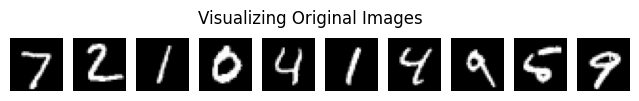

Visualizing reconstructions for fold 1


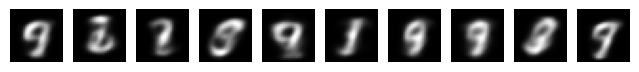

Visualizing reconstructions for fold 2


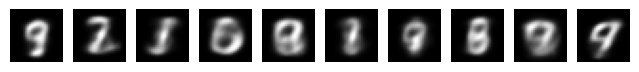

Visualizing reconstructions for fold 3


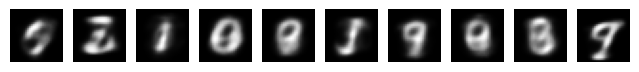

Visualizing reconstructions for fold 4


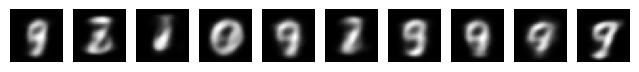

Visualizing reconstructions for fold 5


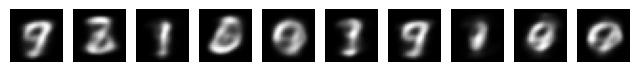

Visualizing reconstructions for fold 6


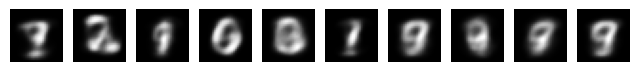

Visualizing reconstructions for fold 7


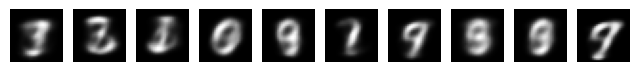

Visualizing reconstructions for fold 8


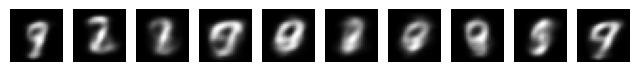

Visualizing reconstructions for fold 9


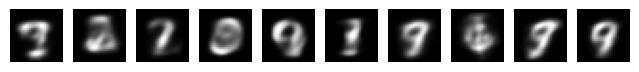

Visualizing reconstructions for fold 10


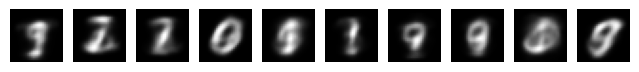

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_2.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_2 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_2):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

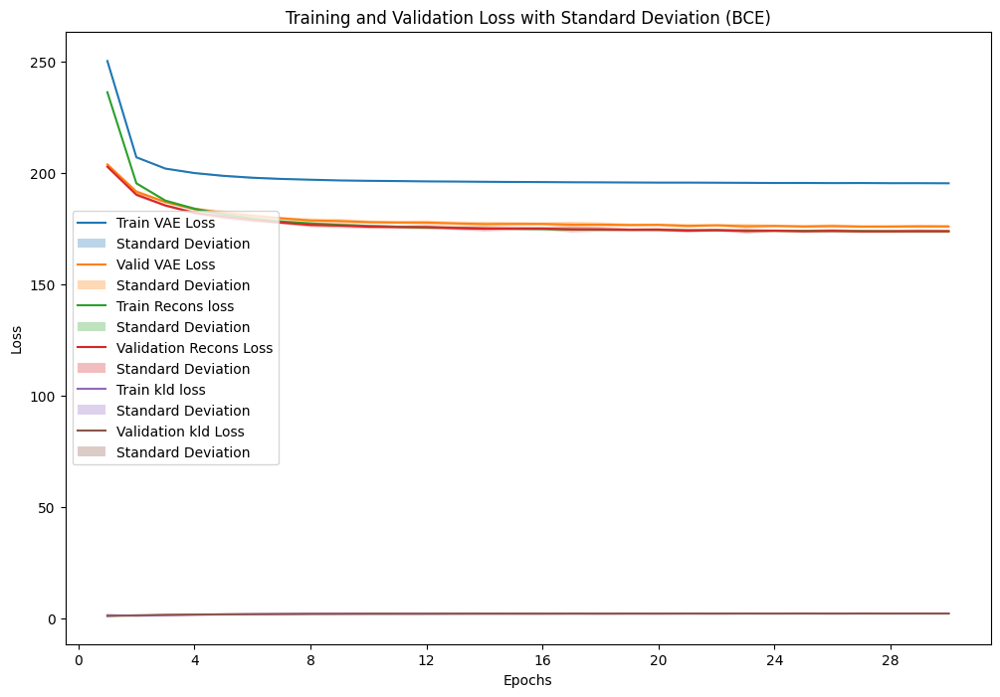

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_2.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_2 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_2_1 = VAE_plot_results(fold_results_3_2, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_2_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_2_1['epochs'])
    VAE_plot_mean_std(result_data_3_2_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_2_1['epochs'])
    VAE_plot_mean_std(result_data_3_2_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_2_1['epochs'])
    VAE_plot_mean_std(result_data_3_2_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_2_1['epochs'])
    VAE_plot_mean_std(result_data_3_2_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_2_1['epochs'])
    VAE_plot_mean_std(result_data_3_2_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_2_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_2_1['valid_metrics'],
    result_data_3_2_1['test_metrics'],
    result_data_3_2_1['valid_result'],
    result_data_3_2_1['test_result'],
    result_data_3_2_1['recons_valid_result'],
    result_data_3_2_1['recons_test_result'],
    result_data_3_2_1['kld_valid_result'],
    result_data_3_2_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.221544           0.220668           175.845467     175.177485              173.690150        173.690150             2.155316       2.174164
Standard Deviation                 0.000867           0.000604             0.661905       0.433103                0.680057          0.680057             0.043486       0.045449

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.221320,0.220879,175.633294,175.332942
1,2,0.221072,0.220537,175.482667,175.076328
2,3,0.221529,0.220407,175.885645,175.003100
3,4,0.221684,0.221557,175.897825,175.815341
4,5,0.221434,0.220133,175.769227,174.792008
5,6,0.221555,0.219608,175.901803,174.385004
6,7,0.222981,0.221475,176.888927,175.728721
7,8,0.223098,0.221358,177.072821,175.673903
8,9,0.220519,0.220384,175.088189,175.016465
9,10,0.220244,0.220338,174.834268,174.951039


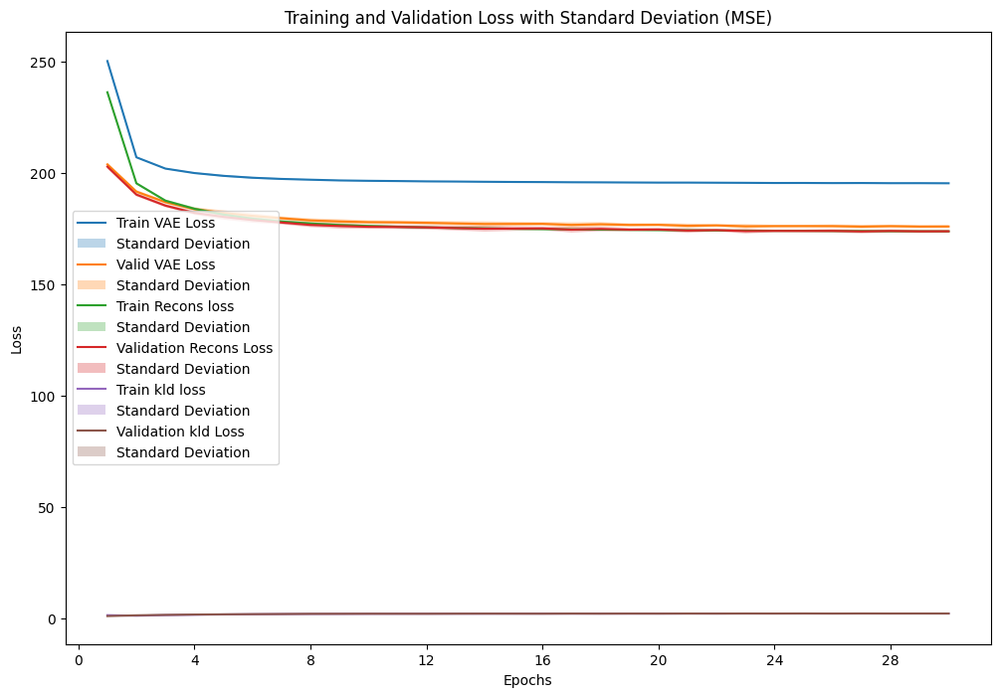

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_2.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_2 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_2_2 = VAE_plot_results(fold_results_3_2, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_2_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_2_2['epochs'])
    VAE_plot_mean_std(result_data_3_2_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_2_2['epochs'])
    VAE_plot_mean_std(result_data_3_2_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_2_2['epochs'])
    VAE_plot_mean_std(result_data_3_2_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_2_2['epochs'])
    VAE_plot_mean_std(result_data_3_2_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_2_2['epochs'])
    VAE_plot_mean_std(result_data_3_2_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_2_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_2_2['valid_metrics'],
    result_data_3_2_2['test_metrics'],
    result_data_3_2_2['valid_result'],
    result_data_3_2_2['test_result'],
    result_data_3_2_2['recons_valid_result'],
    result_data_3_2_2['recons_test_result'],
    result_data_3_2_2['kld_valid_result'],
    result_data_3_2_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.053696           0.053537           175.913111     175.257907              173.757794        173.757794             2.155316       2.174164
Standard Deviation                 0.000299           0.000240             0.669216       0.466709                0.692639          0.692639             0.043486       0.045449

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.053818,0.053554,176.323224,175.341822
1,2,0.053614,0.053518,175.762501,175.270437
2,3,0.053563,0.053349,175.709473,174.934173
3,4,0.053822,0.053829,176.143262,175.805083
4,5,0.053449,0.053302,175.446993,174.827426
5,6,0.053645,0.053253,176.091778,174.673390
6,7,0.054093,0.053880,176.685716,175.939320
7,8,0.054282,0.053907,177.086582,175.917646
8,9,0.053263,0.053290,174.741762,174.678442
9,10,0.053408,0.053489,175.139815,175.191331


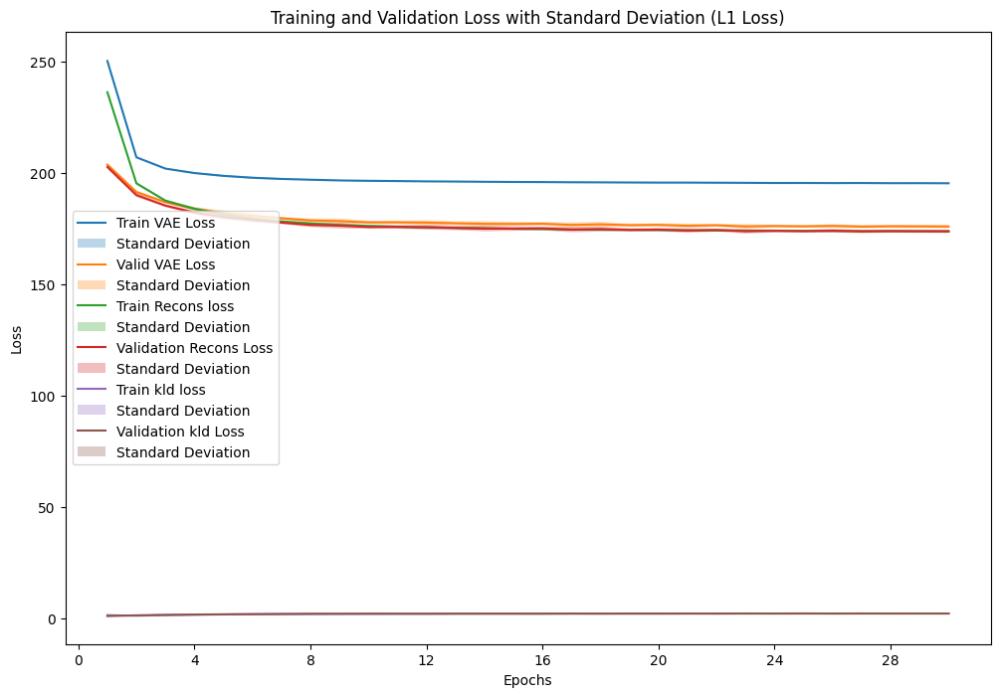

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_2.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_2 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_2_3 = VAE_plot_results(fold_results_3_2, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_2_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_2_3['epochs'])
    VAE_plot_mean_std(result_data_3_2_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_2_3['epochs'])
    VAE_plot_mean_std(result_data_3_2_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_2_3['epochs'])
    VAE_plot_mean_std(result_data_3_2_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_2_3['epochs'])
    VAE_plot_mean_std(result_data_3_2_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_2_3['epochs'])
    VAE_plot_mean_std(result_data_3_2_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_2_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_2_3['valid_metrics'],
    result_data_3_2_3['test_metrics'],
    result_data_3_2_3['valid_result'],
    result_data_3_2_3['test_result'],
    result_data_3_2_3['recons_valid_result'],
    result_data_3_2_3['recons_test_result'],
    result_data_3_2_3['kld_valid_result'],
    result_data_3_2_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.122482           0.122374           175.925195     175.153515              173.769879        173.769879             2.155316       2.174164
Standard Deviation                 0.000304           0.000324             0.737264       0.471241                0.753973          0.753973             0.043486       0.045449

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.122464,0.122396,176.027480,175.092779
1,2,0.122500,0.122655,175.853895,175.336149
2,3,0.122486,0.122039,175.912802,174.645327
3,4,0.122124,0.122235,176.018540,175.674914
4,5,0.121909,0.121843,175.479343,174.829228
5,6,0.122545,0.121960,176.246513,174.586324
6,7,0.122754,0.122427,176.892317,175.882036
7,8,0.123089,0.122669,177.165853,175.843130
8,9,0.122574,0.122767,175.163144,174.848887
9,10,0.122379,0.122746,174.492066,174.796374


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_2 = sum(p.numel() for p in models_3_2[0].parameters())
print(f"Number of parameters in the model: {total_params_3_2}")

Number of parameters in the model: 76112


### Sample new data using the decoder.

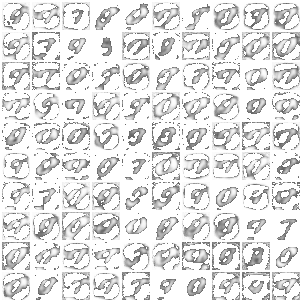

In [ ]:
set_2_mean = torch.randn([1, 32], dtype=torch.float32)

std_2 = torch.ones((1, 32), dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_2[9], mu, std, D_z=32, image_to_sample=100, nrow=10)

### Experiment 3.3 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=16, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_3 = 'VAE'
model_config_3_3 = {'D_x': 784, 'n_layers': 2, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
#set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
set_2_mean = torch.tensor([5,10], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)
#std_2 = torch.tensor([0.5,0.2], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_3_3, fold_results_3_3 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_3),
                                                model_config=model_config_3_3,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=10,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })

Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:227.637676, Training Recons Loss: 198.236904, Training KLD Loss: 2.940077
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.06092204589475977, 'L1 Loss': 0.13932147574551562, 'BCE': 0.24433492155785255}, Validation VAE Loss: {'MSE': 192.62037236639793, 'L1 Loss': 192.84134170856882, 'BCE': 192.72224101614444}, Validation Recons Loss: {'MSE': 191.4567093544818, 'L1 Loss': 191.67767869665266, 'BCE': 191.5585780042283}, Validation KLD Loss: {'MSE': 1.1636628013976076, 'L1 Loss': 1.1636628013976076, 'BCE': 1.1636628013976076}
Train Fold/Epoch: 1/2, Training Loss:201.019158, Training Recons Loss: 190.322783, Training KLD Loss: 1.069638
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.05991153529983886, 'L1 Loss': 0.13606429036627424, 'BCE': 0.2402775265434955}, Validation VAE Loss: {'MSE': 1

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_3.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_3.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_3, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_3, f)


## Visualizing reconstructions for all fold

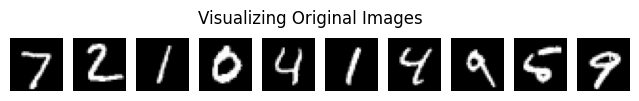

Visualizing reconstructions for fold 1


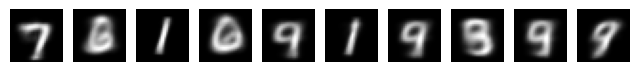

Visualizing reconstructions for fold 2


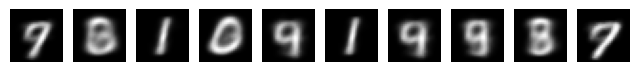

Visualizing reconstructions for fold 3


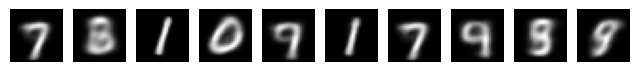

Visualizing reconstructions for fold 4


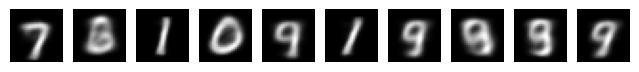

Visualizing reconstructions for fold 5


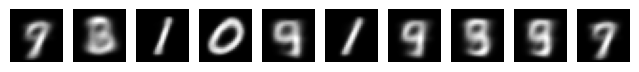

Visualizing reconstructions for fold 6


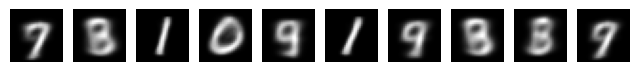

Visualizing reconstructions for fold 7


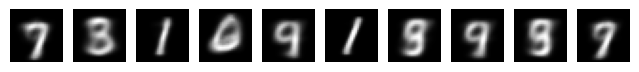

Visualizing reconstructions for fold 8


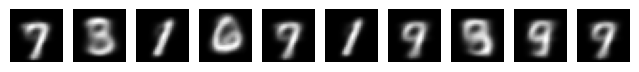

Visualizing reconstructions for fold 9


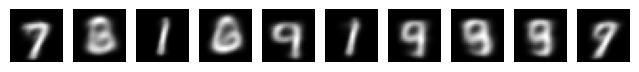

Visualizing reconstructions for fold 10


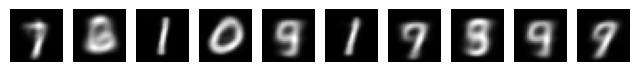

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_3.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_3 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_3):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

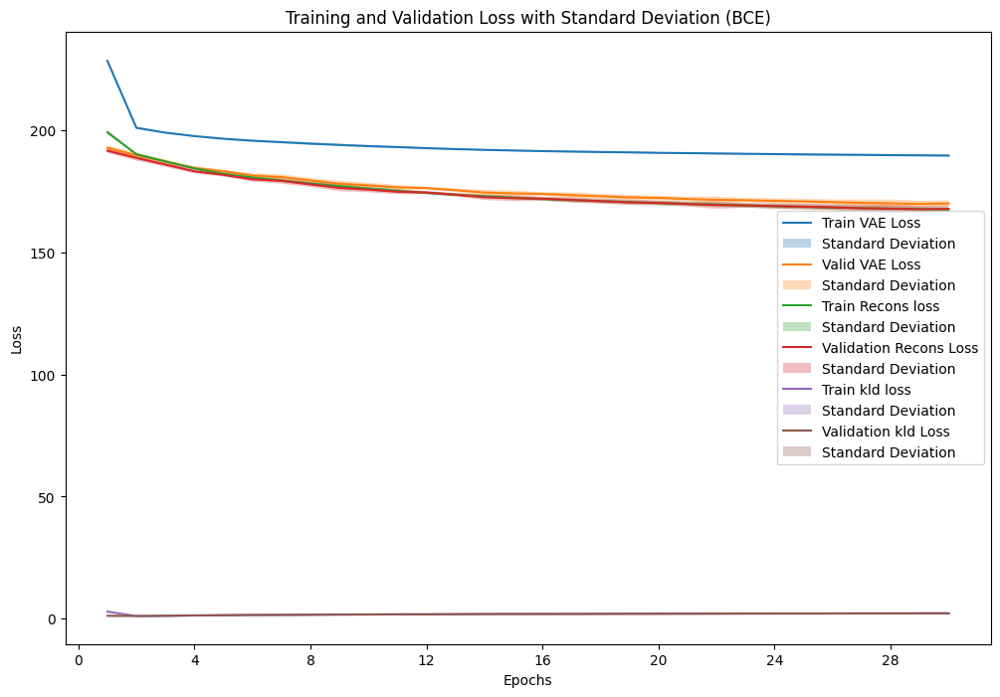

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_3.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_3 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_3_1 = VAE_plot_results(fold_results_3_3, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_3_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_3_1['epochs'])
    VAE_plot_mean_std(result_data_3_3_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_3_1['epochs'])
    VAE_plot_mean_std(result_data_3_3_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_3_1['epochs'])
    VAE_plot_mean_std(result_data_3_3_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_3_1['epochs'])
    VAE_plot_mean_std(result_data_3_3_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_3_1['epochs'])
    VAE_plot_mean_std(result_data_3_3_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_3_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_3_1['valid_metrics'],
    result_data_3_3_1['test_metrics'],
    result_data_3_3_1['valid_result'],
    result_data_3_3_1['test_result'],
    result_data_3_3_1['recons_valid_result'],
    result_data_3_3_1['recons_test_result'],
    result_data_3_3_1['kld_valid_result'],
    result_data_3_3_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.213786           0.213673           169.831980     169.727551              167.607884        167.607884             2.224097       2.208036
Standard Deviation                 0.001673           0.001599             1.228573       1.169760                1.311954          1.311954             0.104993       0.100792

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.213779,0.214059,169.798679,170.022792
1,2,0.216504,0.216414,171.922905,171.839290
2,3,0.215451,0.214413,171.004797,170.160780
3,4,0.214674,0.214957,170.415341,170.629815
4,5,0.213754,0.213088,169.794421,169.277593
5,6,0.214566,0.214238,170.430631,170.145928
6,7,0.211442,0.211441,168.174601,168.137970
7,8,0.212250,0.210900,168.799863,167.715748
8,9,0.214495,0.214698,170.295573,170.440063
9,10,0.210942,0.212520,167.682992,168.905536


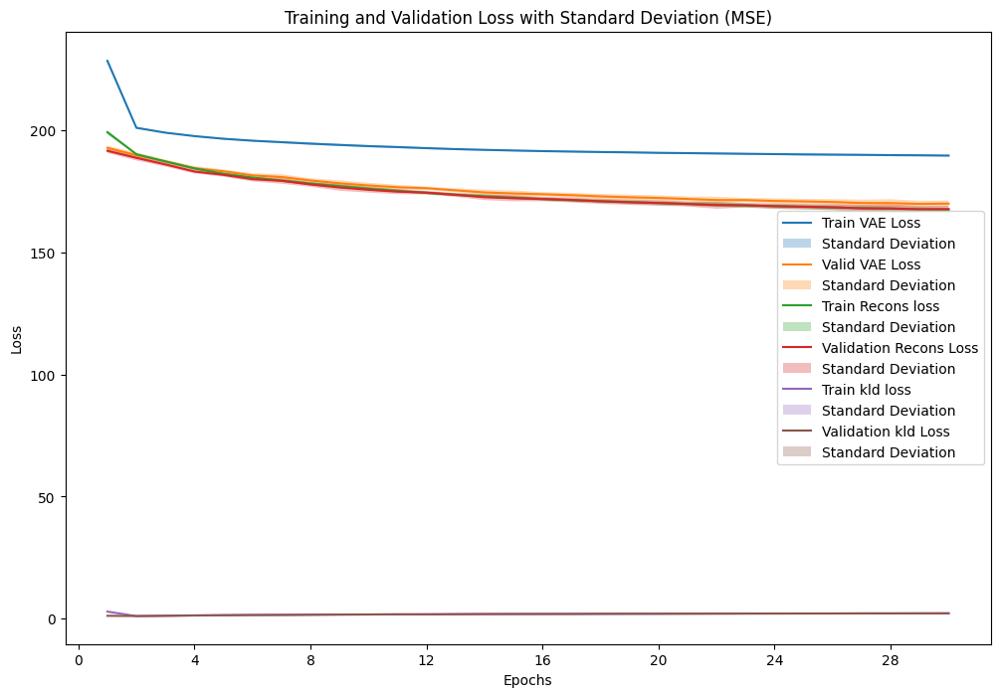

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_3.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_3 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_3_2 = VAE_plot_results(fold_results_3_3, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_3_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_3_2['epochs'])
    VAE_plot_mean_std(result_data_3_3_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_3_2['epochs'])
    VAE_plot_mean_std(result_data_3_3_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_3_2['epochs'])
    VAE_plot_mean_std(result_data_3_3_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_3_2['epochs'])
    VAE_plot_mean_std(result_data_3_3_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_3_2['epochs'])
    VAE_plot_mean_std(result_data_3_3_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_3_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_3_2['valid_metrics'],
    result_data_3_3_2['test_metrics'],
    result_data_3_3_2['valid_result'],
    result_data_3_3_2['test_result'],
    result_data_3_3_2['recons_valid_result'],
    result_data_3_3_2['recons_test_result'],
    result_data_3_3_2['kld_valid_result'],
    result_data_3_3_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.051653           0.051700           169.984432     169.731568              167.760336        167.760336             2.224097       2.208036
Standard Deviation                 0.000527           0.000508             1.200065       1.153337                1.285265          1.285265             0.104993       0.100792

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.051632,0.051750,169.960996,169.746251
1,2,0.052420,0.052457,171.740226,171.657973
2,3,0.052210,0.052095,171.155591,170.511660
3,4,0.052079,0.052111,170.866903,170.566027
4,5,0.051569,0.051528,169.936189,169.425001
5,6,0.051831,0.051891,170.600713,170.167016
6,7,0.050886,0.051064,168.139829,168.356510
7,8,0.051239,0.050769,169.238678,167.647516
8,9,0.051917,0.052080,170.381609,170.552321
9,10,0.050743,0.051258,167.823587,168.685404


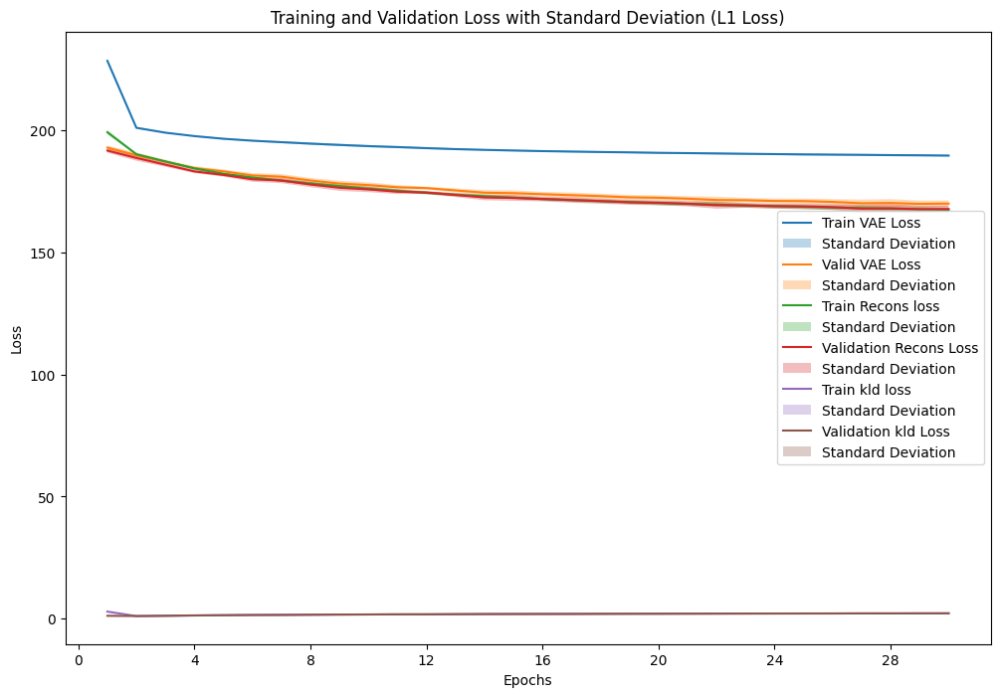

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_3.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_3 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_3_3 = VAE_plot_results(fold_results_3_3, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_3_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_3_3['epochs'])
    VAE_plot_mean_std(result_data_3_3_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_3_3['epochs'])
    VAE_plot_mean_std(result_data_3_3_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_3_3['epochs'])
    VAE_plot_mean_std(result_data_3_3_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_3_3['epochs'])
    VAE_plot_mean_std(result_data_3_3_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_3_3['epochs'])
    VAE_plot_mean_std(result_data_3_3_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_3_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_3_3['valid_metrics'],
    result_data_3_3_3['test_metrics'],
    result_data_3_3_3['valid_result'],
    result_data_3_3_3['test_result'],
    result_data_3_3_3['recons_valid_result'],
    result_data_3_3_3['recons_test_result'],
    result_data_3_3_3['kld_valid_result'],
    result_data_3_3_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.118384           0.118652           169.920692     169.687611              167.696596        167.696596             2.224097       2.208036
Standard Deviation                 0.001862           0.001708             1.312146       1.147712                1.396057          1.396057             0.104993       0.100792

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.117769,0.118307,169.799914,169.873792
1,2,0.122261,0.122398,172.038214,171.773625
2,3,0.119080,0.119113,171.072846,170.403359
3,4,0.118940,0.118766,171.197957,170.402437
4,5,0.119634,0.119602,169.662822,169.517547
5,6,0.119119,0.119484,170.173833,170.005200
6,7,0.115208,0.116081,167.916178,168.459309
7,8,0.117099,0.116573,169.234448,167.609514
8,9,0.118499,0.119003,170.404931,170.326190
9,10,0.116232,0.117191,167.705778,168.505134


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_3 = sum(p.numel() for p in models_3_3[0].parameters())
print(f"Number of parameters in the model: {total_params_3_3}")

Number of parameters in the model: 620156


## Latent Space Visualization

<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


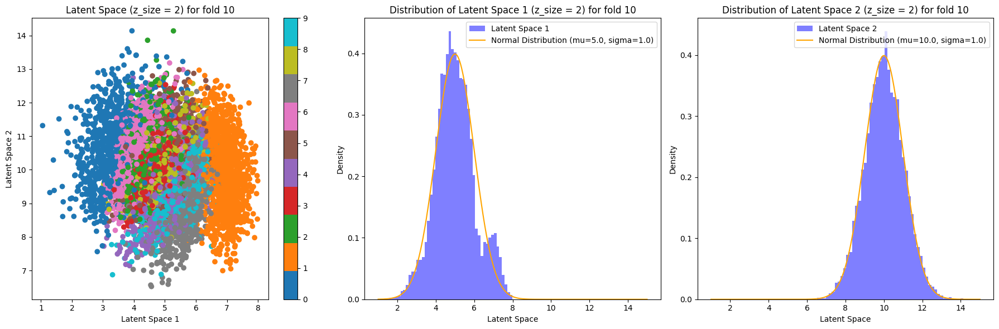

In [ ]:
x = np.linspace(1, 15, 1000)
set_2_mean = torch.tensor([[5,10]], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_3[9], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

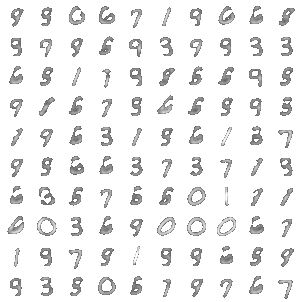

In [ ]:
set_2_mean = torch.tensor([5,10], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_3[9], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

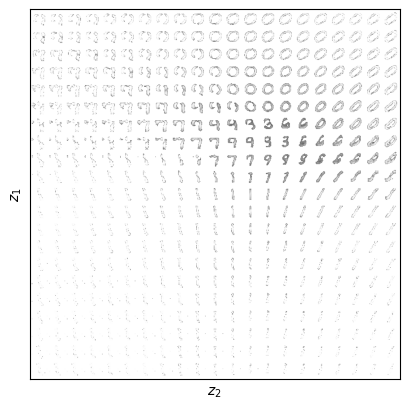

In [ ]:
VAE_visualize_latent_space(models_3_3[9], device)

### Experiment 3.4 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=32, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_4 = 'VAE'
model_config_3_4 = {'D_x': 784, 'n_layers': 2, 'D_z': 32, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
#set_2_mean = torch.ones((1, 32), dtype=torch.float32)
#set_2_mean = torch.tensor([5,10], dtype=torch.float32)
set_2_mean = torch.randn([1, 32], dtype=torch.float32)

std_2 = torch.ones((1, 32), dtype=torch.float32)
#std_2 = torch.tensor([0.5,0.2], dtype=torch.float32)
#std_2 = torch.randn([1, 32], dtype=torch.float32)
models_3_4, fold_results_3_4 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_4),
                                                model_config=model_config_3_4,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=10,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })

Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:207.660583, Training Recons Loss: 192.331693, Training KLD Loss: 1.532889
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.054811066095816326, 'L1 Loss': 0.12459091905583726, 'BCE': 0.22488923941520936}, Validation VAE Loss: {'MSE': 178.21607127088183, 'L1 Loss': 178.3886553175906, 'BCE': 178.29672614564288}, Validation Recons Loss: {'MSE': 176.23250839558054, 'L1 Loss': 176.40509227996176, 'BCE': 176.31316310801404}, Validation KLD Loss: {'MSE': 1.9835623223730858, 'L1 Loss': 1.9835623223730858, 'BCE': 1.9835623223730858}
Train Fold/Epoch: 1/2, Training Loss:193.319262, Training Recons Loss: 170.616905, Training KLD Loss: 2.270236
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.05072312913042434, 'L1 Loss': 0.11611829642602738, 'BCE': 0.21211482156464395}, Validation VAE Loss: {'MSE'

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_4.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_4.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_4, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_4, f)


## Visualizing reconstructions for all fold

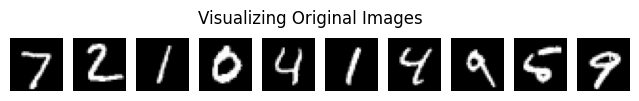

Visualizing reconstructions for fold 1


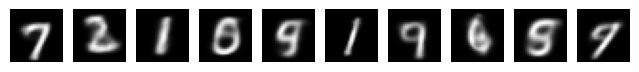

Visualizing reconstructions for fold 2


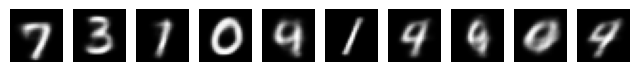

Visualizing reconstructions for fold 3


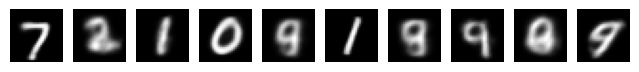

Visualizing reconstructions for fold 4


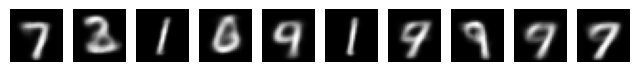

Visualizing reconstructions for fold 5


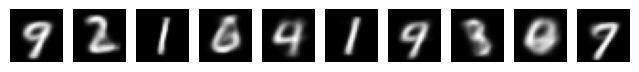

Visualizing reconstructions for fold 6


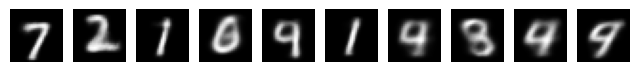

Visualizing reconstructions for fold 7


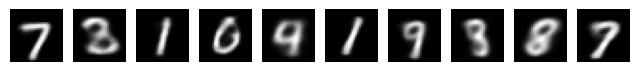

Visualizing reconstructions for fold 8


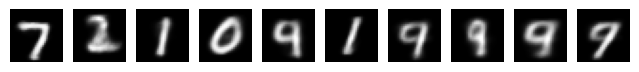

Visualizing reconstructions for fold 9


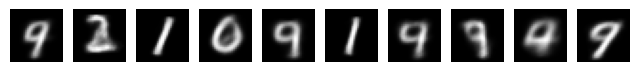

Visualizing reconstructions for fold 10


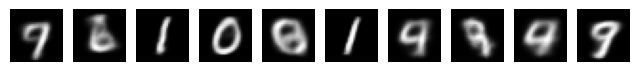

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_4.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_4 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_4):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

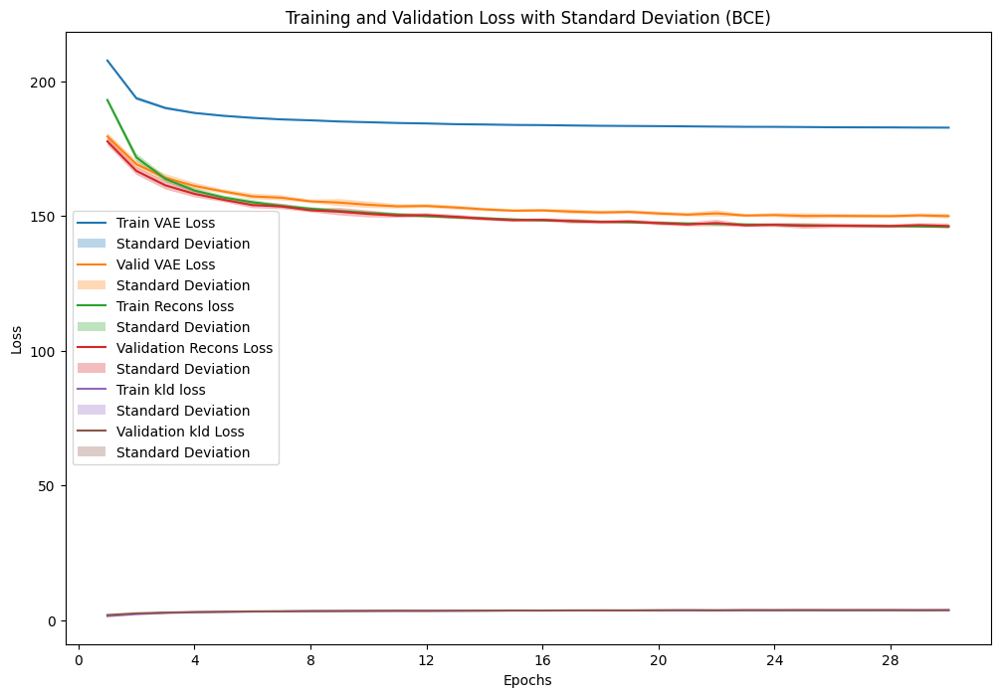

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_4.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_4 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_4_1 = VAE_plot_results(fold_results_3_4, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_4_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_4_1['epochs'])
    VAE_plot_mean_std(result_data_3_4_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_4_1['epochs'])
    VAE_plot_mean_std(result_data_3_4_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_4_1['epochs'])
    VAE_plot_mean_std(result_data_3_4_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_4_1['epochs'])
    VAE_plot_mean_std(result_data_3_4_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_4_1['epochs'])
    VAE_plot_mean_std(result_data_3_4_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_4_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_4_1['valid_metrics'],
    result_data_3_4_1['test_metrics'],
    result_data_3_4_1['valid_result'],
    result_data_3_4_1['test_result'],
    result_data_3_4_1['recons_valid_result'],
    result_data_3_4_1['recons_test_result'],
    result_data_3_4_1['kld_valid_result'],
    result_data_3_4_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.186382           0.186008           149.794128     149.500005              146.123168        146.123168             3.670960       3.669477
Standard Deviation                 0.001411           0.001159             1.028697       0.819801                1.106167          1.106167             0.096569       0.093205

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.187354,0.186204,150.490277,149.609810
1,2,0.186714,0.186801,150.008636,150.077472
2,3,0.188636,0.187399,151.483181,150.483386
3,4,0.185483,0.185567,149.118073,149.178426
4,5,0.186372,0.186241,149.745266,149.659559
5,6,0.183759,0.183392,147.968877,147.672769
6,7,0.186614,0.185759,149.954265,149.270229
7,8,0.186646,0.185695,150.088650,149.317741
8,9,0.187825,0.187752,150.800633,150.756274
9,10,0.184413,0.185273,148.283424,148.974385


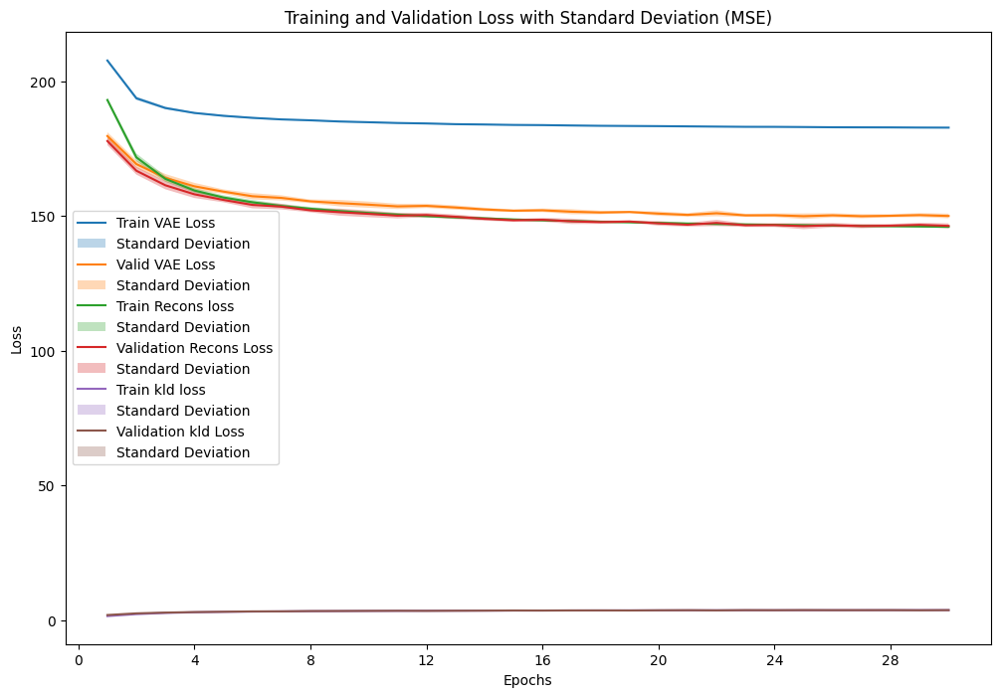

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_4.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_4 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_4_2 = VAE_plot_results(fold_results_3_4, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_4_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_4_2['epochs'])
    VAE_plot_mean_std(result_data_3_4_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_4_2['epochs'])
    VAE_plot_mean_std(result_data_3_4_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_4_2['epochs'])
    VAE_plot_mean_std(result_data_3_4_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_4_2['epochs'])
    VAE_plot_mean_std(result_data_3_4_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_4_2['epochs'])
    VAE_plot_mean_std(result_data_3_4_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_4_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_4_2['valid_metrics'],
    result_data_3_4_2['test_metrics'],
    result_data_3_4_2['valid_result'],
    result_data_3_4_2['test_result'],
    result_data_3_4_2['recons_valid_result'],
    result_data_3_4_2['recons_test_result'],
    result_data_3_4_2['kld_valid_result'],
    result_data_3_4_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.042071           0.041999           149.968063     149.582836              146.297102        146.297102             3.670960       3.669477
Standard Deviation                 0.000400           0.000415             0.805072       0.856850                0.877806          0.877806             0.096569       0.093205

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.042350,0.042122,150.700718,149.906373
1,2,0.042327,0.042156,150.446476,149.903221
2,3,0.042613,0.042474,151.057852,150.525480
3,4,0.041821,0.041871,149.361331,149.295635
4,5,0.042266,0.042223,150.408005,150.093955
5,6,0.041210,0.041109,148.478560,147.755625
6,7,0.042096,0.042101,149.987104,149.858841
7,8,0.042137,0.041712,150.365758,148.961467
8,9,0.042320,0.042599,150.153690,150.772782
9,10,0.041570,0.041620,148.721132,148.754982


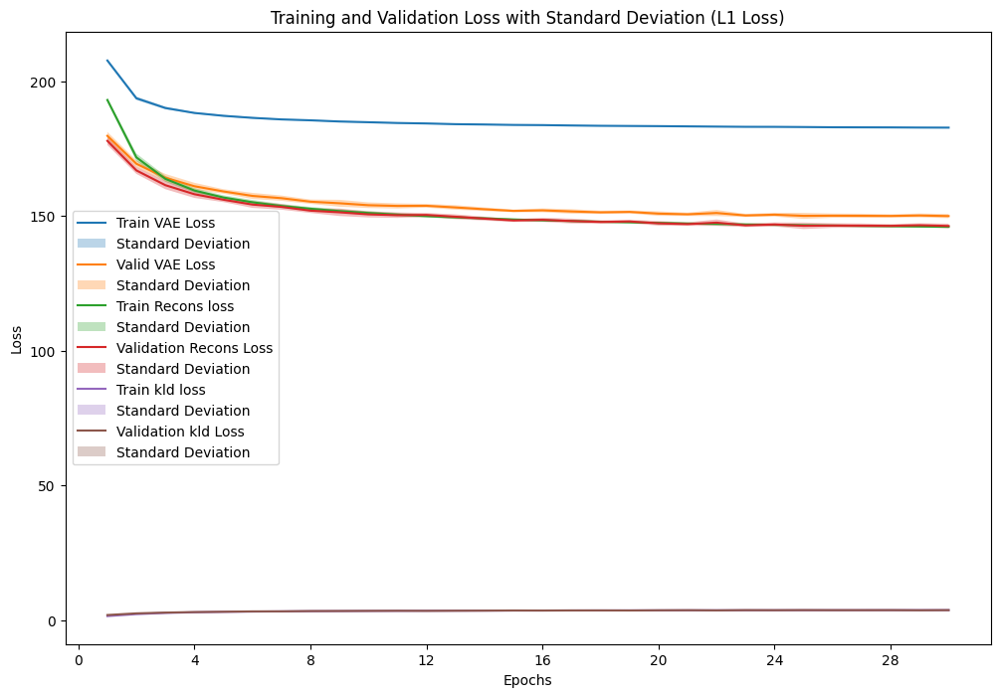

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_4.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_4 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_4_3 = VAE_plot_results(fold_results_3_4, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_4_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_4_3['epochs'])
    VAE_plot_mean_std(result_data_3_4_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_4_3['epochs'])
    VAE_plot_mean_std(result_data_3_4_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_4_3['epochs'])
    VAE_plot_mean_std(result_data_3_4_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_4_3['epochs'])
    VAE_plot_mean_std(result_data_3_4_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_4_3['epochs'])
    VAE_plot_mean_std(result_data_3_4_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_4_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_4_3['valid_metrics'],
    result_data_3_4_3['test_metrics'],
    result_data_3_4_3['valid_result'],
    result_data_3_4_3['test_result'],
    result_data_3_4_3['recons_valid_result'],
    result_data_3_4_3['recons_test_result'],
    result_data_3_4_3['kld_valid_result'],
    result_data_3_4_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.098695           0.098780           149.877472     149.555847              146.206512        146.206512             3.670960       3.669477
Standard Deviation                 0.001029           0.001003             0.841685       0.884827                0.920420          0.920420             0.096569       0.093205

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.098106,0.098199,150.149850,149.788985
1,2,0.098879,0.099057,149.762819,149.729023
2,3,0.099963,0.099995,150.824196,150.435046
3,4,0.098581,0.098909,149.035322,149.363733
4,5,0.099056,0.099140,150.467156,150.358195
5,6,0.096842,0.096894,148.353586,147.527000
6,7,0.098601,0.098634,149.893541,149.645112
7,8,0.098661,0.098304,150.244491,149.053167
8,9,0.100653,0.100675,151.149904,150.768509
9,10,0.097607,0.097989,148.893859,148.889697


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_4 = sum(p.numel() for p in models_3_4[0].parameters())
print(f"Number of parameters in the model: {total_params_3_4}")

Number of parameters in the model: 680576


### Sample new data using the decoder.

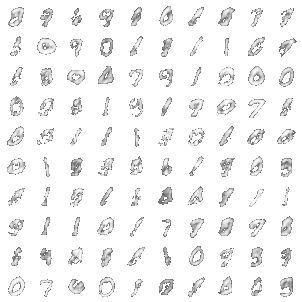

In [ ]:
set_2_mean = torch.randn([1, 32], dtype=torch.float32)

std_2 = torch.ones((1, 32), dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_4[5], mu, std, D_z=32, image_to_sample=100, nrow=10)

### Experiment 3.5 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=64, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

### Experiment 4.1 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=2, activation is RELU
- Loss: Bernoulli likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_4_1 = 'VAE'
model_config_4_1 = {'D_x': 784, 'n_layers': 1, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
#set_2_mean = torch.tensor([5,10], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)

#std_2 = torch.ones((1, 2), dtype=torch.float32)
std_2 = torch.tensor([0.5,0.2], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_4_1, fold_results_4_1 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_4_1),
                                                model_config=model_config_4_1,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=10,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })

Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:413.600060, Training Recons Loss: 379.038919, Training KLD Loss: 3.456114
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.08375299325648775, 'L1 Loss': 0.2381882797530357, 'BCE': 0.34956711086821046}, Validation VAE Loss: {'MSE': 277.84459799908575, 'L1 Loss': 278.74247514440657, 'BCE': 278.1662490520072}, Validation Recons Loss: {'MSE': 273.7389633503366, 'L1 Loss': 274.63684033332987, 'BCE': 274.060614403258}, Validation KLD Loss: {'MSE': 4.105634925213266, 'L1 Loss': 4.105634925213266, 'BCE': 4.105634925213266}
Train Fold/Epoch: 1/2, Training Loss:286.506588, Training Recons Loss: 249.863286, Training KLD Loss: 3.664330
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.0706838791040664, 'L1 Loss': 0.18891816950858908, 'BCE': 0.29654566626599493}, Validation VAE Loss: {'MSE': 236.577

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_4_1.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_4_1.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_4_1, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_4_1, f)


## Visualizing reconstructions for all fold

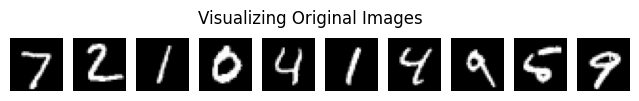

Visualizing reconstructions for fold 1


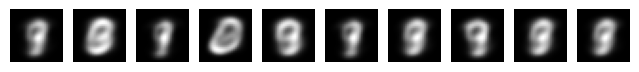

Visualizing reconstructions for fold 2


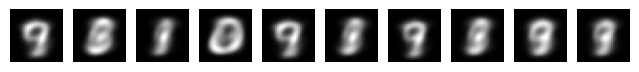

Visualizing reconstructions for fold 3


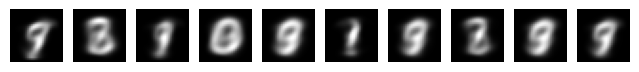

Visualizing reconstructions for fold 4


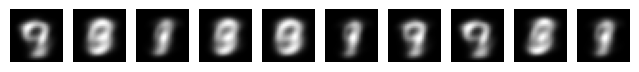

Visualizing reconstructions for fold 5


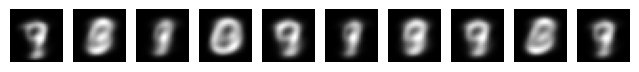

Visualizing reconstructions for fold 6


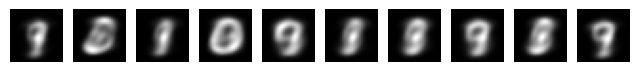

Visualizing reconstructions for fold 7


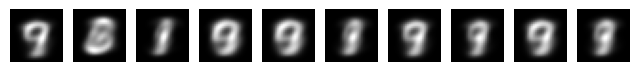

Visualizing reconstructions for fold 8


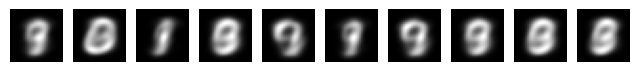

Visualizing reconstructions for fold 9


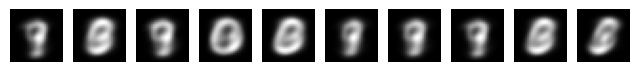

Visualizing reconstructions for fold 10


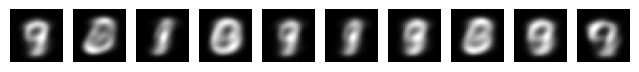

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_4_1.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_4_1 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_4_1):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

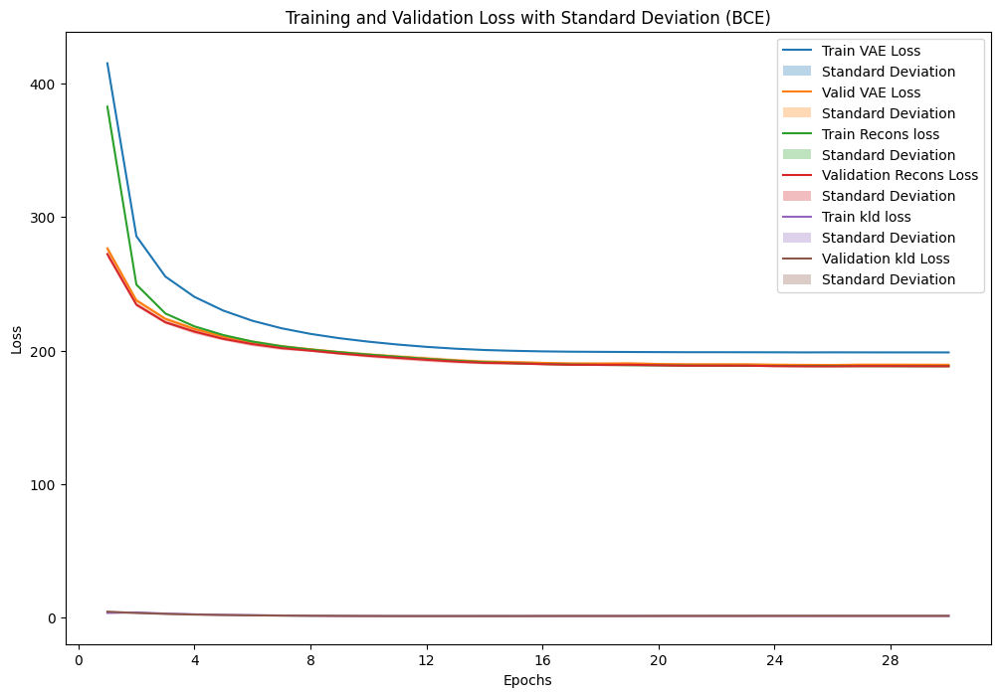

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_4_1.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_4_1 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_4_1_1 = VAE_plot_results(fold_results_4_1, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_4_1_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_4_1_1['epochs'])
    VAE_plot_mean_std(result_data_4_1_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_4_1_1['epochs'])
    VAE_plot_mean_std(result_data_4_1_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_4_1_1['epochs'])
    VAE_plot_mean_std(result_data_4_1_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_4_1_1['epochs'])
    VAE_plot_mean_std(result_data_4_1_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_4_1_1['epochs'])
    VAE_plot_mean_std(result_data_4_1_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_4_1_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_4_1_1['valid_metrics'],
    result_data_4_1_1['test_metrics'],
    result_data_4_1_1['valid_result'],
    result_data_4_1_1['test_result'],
    result_data_4_1_1['recons_valid_result'],
    result_data_4_1_1['recons_test_result'],
    result_data_4_1_1['kld_valid_result'],
    result_data_4_1_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.240252           0.239581           189.392641     188.873380              188.357886        188.357886             1.034754       1.041722
Standard Deviation                 0.001207           0.000829             0.911411       0.601819                0.946439          0.946439             0.054147       0.050669

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.240276,0.239906,189.371551,189.099108
1,2,0.239150,0.238411,188.577776,188.010591
2,3,0.241475,0.240359,190.329417,189.455384
3,4,0.240836,0.240519,189.807806,189.566992
4,5,0.238301,0.237992,187.967408,187.741157
5,6,0.242212,0.240138,190.861336,189.251463
6,7,0.241369,0.240273,190.232042,189.384244
7,8,0.240610,0.238961,189.749216,188.421578
8,9,0.239319,0.239955,188.640368,189.141528
9,10,0.238976,0.239298,188.389485,188.661756


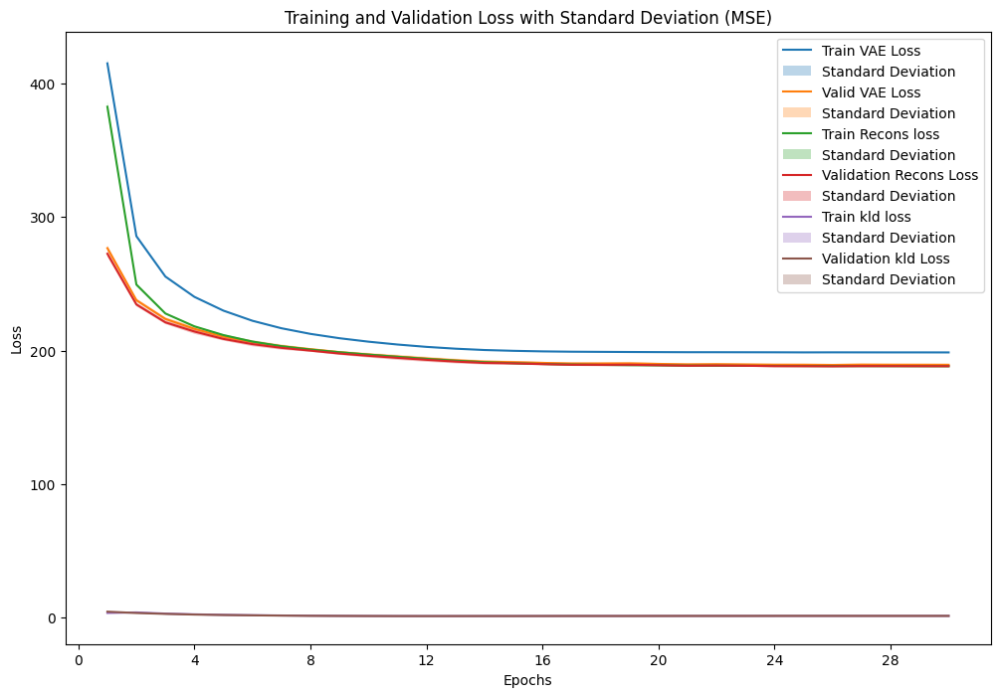

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_4_1.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_4_1 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_4_1_2 = VAE_plot_results(fold_results_4_1, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_4_1_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_4_1_2['epochs'])
    VAE_plot_mean_std(result_data_4_1_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_4_1_2['epochs'])
    VAE_plot_mean_std(result_data_4_1_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_4_1_2['epochs'])
    VAE_plot_mean_std(result_data_4_1_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_4_1_2['epochs'])
    VAE_plot_mean_std(result_data_4_1_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_4_1_2['epochs'])
    VAE_plot_mean_std(result_data_4_1_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_4_1_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_4_1_2['valid_metrics'],
    result_data_4_1_2['test_metrics'],
    result_data_4_1_2['valid_result'],
    result_data_4_1_2['test_result'],
    result_data_4_1_2['recons_valid_result'],
    result_data_4_1_2['recons_test_result'],
    result_data_4_1_2['kld_valid_result'],
    result_data_4_1_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.060202           0.060204           189.350685     188.931687              188.315931        188.315931             1.034754       1.041722
Standard Deviation                 0.000376           0.000274             0.903280       0.575206                0.936267          0.936267             0.054147       0.050669

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.060245,0.060394,189.390613,189.189335
1,2,0.059878,0.059832,188.654430,188.156575
2,3,0.060524,0.060364,190.407495,189.432597
3,4,0.060400,0.060540,189.649261,189.596660
4,5,0.059542,0.059700,187.881331,187.815799
5,6,0.060627,0.060243,190.575671,189.121225
6,7,0.060624,0.060467,190.205637,189.547315
7,8,0.060405,0.060086,189.824822,188.599126
8,9,0.060142,0.060426,188.819693,189.227112
9,10,0.059632,0.059986,188.097893,188.631126


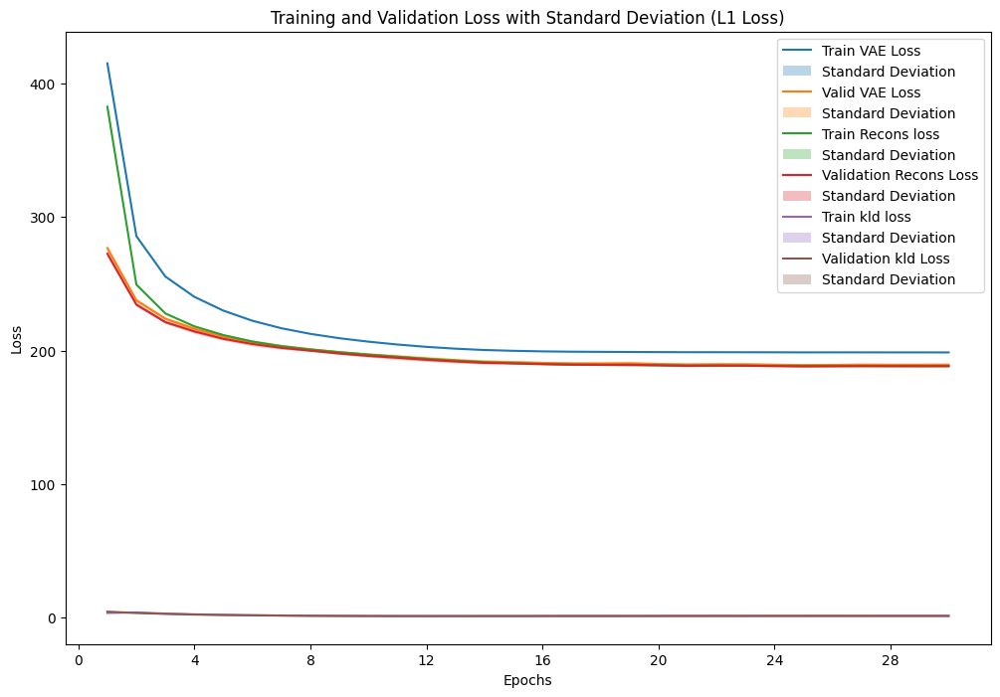

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_4_1.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_4_1 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_4_1_3 = VAE_plot_results(fold_results_4_1, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_4_1_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_4_1_3['epochs'])
    VAE_plot_mean_std(result_data_4_1_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_4_1_3['epochs'])
    VAE_plot_mean_std(result_data_4_1_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_4_1_3['epochs'])
    VAE_plot_mean_std(result_data_4_1_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_4_1_3['epochs'])
    VAE_plot_mean_std(result_data_4_1_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_4_1_3['epochs'])
    VAE_plot_mean_std(result_data_4_1_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_4_1_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_4_1_3['valid_metrics'],
    result_data_4_1_3['test_metrics'],
    result_data_4_1_3['valid_result'],
    result_data_4_1_3['test_result'],
    result_data_4_1_3['recons_valid_result'],
    result_data_4_1_3['recons_test_result'],
    result_data_4_1_3['kld_valid_result'],
    result_data_4_1_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.135032           0.135168           189.250554     188.870145              188.215800        188.215800             1.034754       1.041722
Standard Deviation                 0.000648           0.000552             0.911151       0.586821                0.939543          0.939543             0.054147       0.050669

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.135221,0.135742,189.066916,189.124990
1,2,0.135025,0.135161,188.426283,188.172460
2,3,0.135893,0.135711,190.487495,189.476867
3,4,0.134040,0.134496,189.452189,189.569295
4,5,0.134167,0.134340,187.929960,187.714042
5,6,0.136097,0.135752,190.437259,189.118706
6,7,0.134502,0.134480,189.965630,189.373656
7,8,0.135519,0.134839,189.949130,188.366592
8,9,0.135013,0.135696,188.844665,189.145918
9,10,0.134840,0.135469,187.946016,188.638928


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_4_1 = sum(p.numel() for p in models_4_1[0].parameters())
print(f"Number of parameters in the model: {total_params_4_1}")

Number of parameters in the model: 5492


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


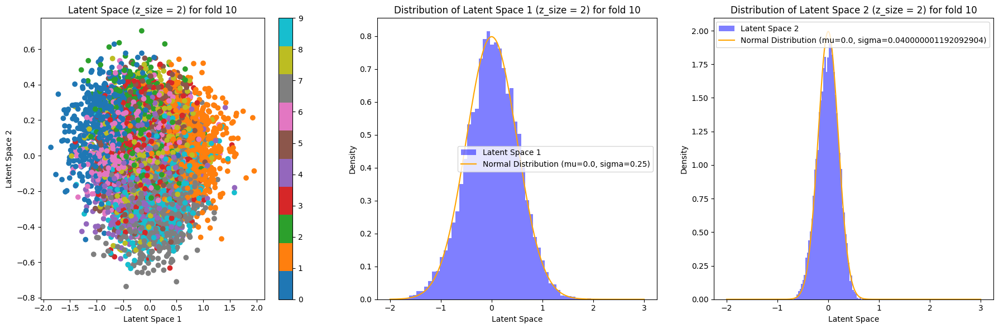

In [ ]:
x = np.linspace(-2, 3, 1000)
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)

std_2 = torch.tensor([[0.5,0.2]], dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_4_1[4], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

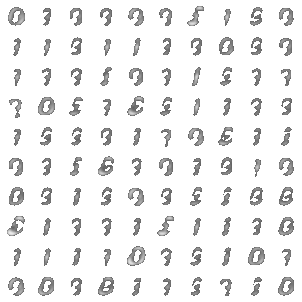

In [ ]:
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)

std_2 = torch.tensor([[0.5,0.2]], dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_4_1[4], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

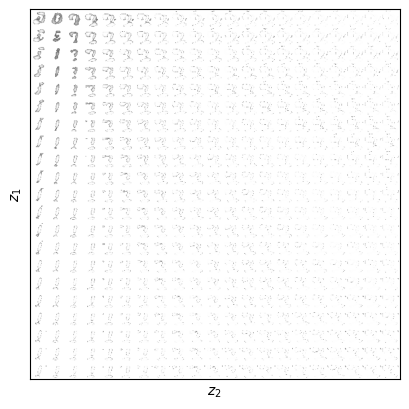

In [ ]:
VAE_visualize_latent_space(models_4_1[1], device)

### Experiment 3.2 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=8, activation is RELU
- Loss: Bernoulli likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_4_2 = 'VAE'
model_config_4_2 = {'D_x': 784, 'n_layers': 2, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
#set_2_mean = torch.tensor([5,10], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)

#std_2 = torch.ones((1, 2), dtype=torch.float32)
std_2 = torch.tensor([0.5,0.2], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_4_2, fold_results_4_2 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_4_2),
                                                model_config=model_config_4_2,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=10,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })

Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:207.129540, Training Recons Loss: 196.424867, Training KLD Loss: 1.070467
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.05699848918680181, 'L1 Loss': 0.1318439949066081, 'BCE': 0.23143137801200786}, Validation VAE Loss: {'MSE': 182.8732718609749, 'L1 Loss': 183.17097976359915, 'BCE': 182.81378254991895}, Validation Recons Loss: {'MSE': 181.50168934274228, 'L1 Loss': 181.79939724536652, 'BCE': 181.44220003168633}, Validation KLD Loss: {'MSE': 1.3715829278560394, 'L1 Loss': 1.3715829278560394, 'BCE': 1.3715829278560394}
Train Fold/Epoch: 1/2, Training Loss:193.676190, Training Recons Loss: 177.499321, Training KLD Loss: 1.617687
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.05536639131605625, 'L1 Loss': 0.12536756353492431, 'BCE': 0.22539943551763575}, Validation VAE Loss: {'MSE': 

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_4_2.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_4_2.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_4_2, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_4_2, f)


## Visualizing reconstructions for all fold

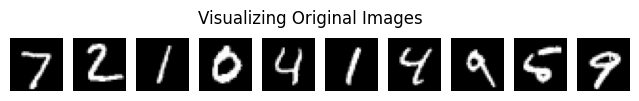

Visualizing reconstructions for fold 1


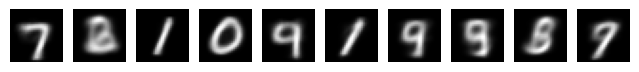

Visualizing reconstructions for fold 2


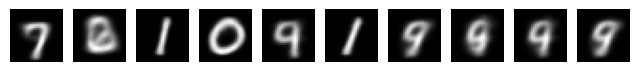

Visualizing reconstructions for fold 3


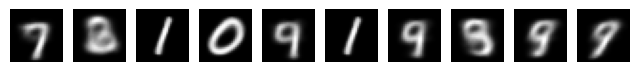

Visualizing reconstructions for fold 4


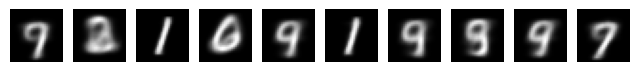

Visualizing reconstructions for fold 5


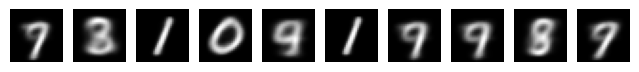

Visualizing reconstructions for fold 6


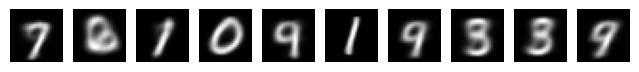

Visualizing reconstructions for fold 7


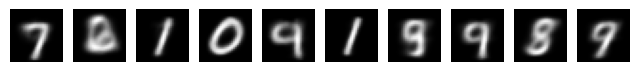

Visualizing reconstructions for fold 8


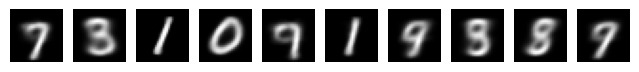

Visualizing reconstructions for fold 9


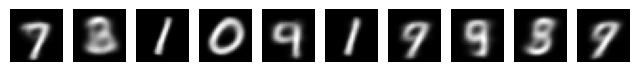

Visualizing reconstructions for fold 10


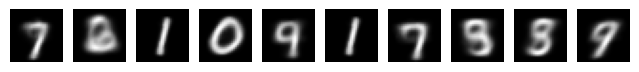

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_4_2.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_4_2 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_4_2):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

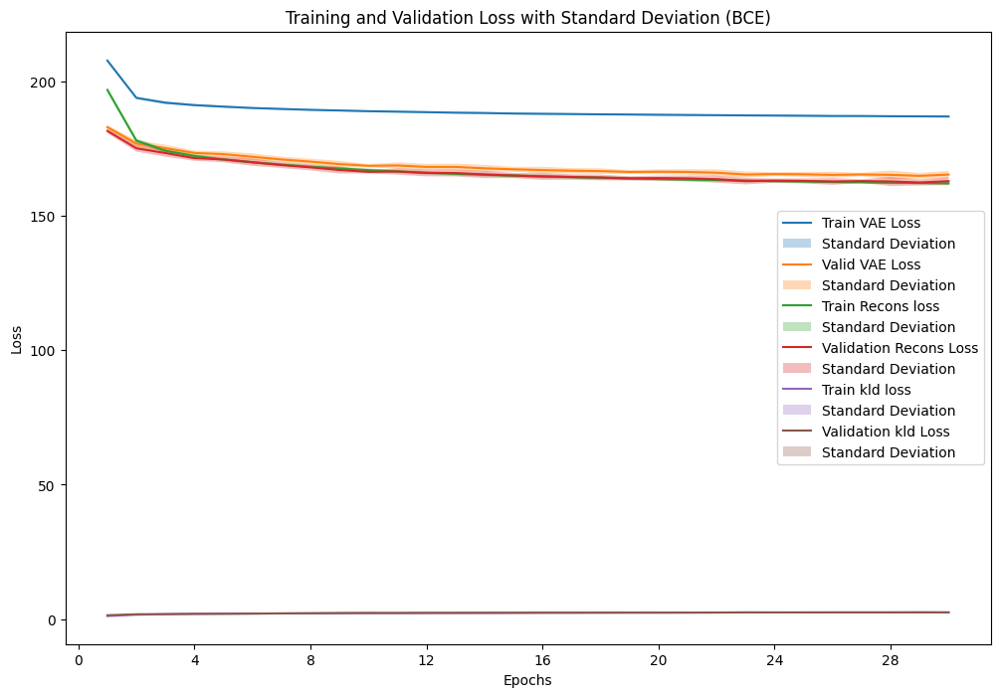

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_4_2.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_4_2 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_4_2_1 = VAE_plot_results(fold_results_4_2, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_4_2_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_4_2_1['epochs'])
    VAE_plot_mean_std(result_data_4_2_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_4_2_1['epochs'])
    VAE_plot_mean_std(result_data_4_2_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_4_2_1['epochs'])
    VAE_plot_mean_std(result_data_4_2_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_4_2_1['epochs'])
    VAE_plot_mean_std(result_data_4_2_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_4_2_1['epochs'])
    VAE_plot_mean_std(result_data_4_2_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_4_2_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_4_2_1['valid_metrics'],
    result_data_4_2_1['test_metrics'],
    result_data_4_2_1['valid_result'],
    result_data_4_2_1['test_result'],
    result_data_4_2_1['recons_valid_result'],
    result_data_4_2_1['recons_test_result'],
    result_data_4_2_1['kld_valid_result'],
    result_data_4_2_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.207604           0.207294           165.207263     164.952363              162.761811        162.761811             2.445452       2.433707
Standard Deviation                 0.001856           0.001444             1.374194       1.037799                1.454968          1.454968             0.096276       0.098903

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.209446,0.209145,166.491080,166.251809
1,2,0.207945,0.207500,165.492641,165.153252
2,3,0.211505,0.210038,168.079607,166.898066
3,4,0.207392,0.207617,165.023646,165.183746
4,5,0.207856,0.207717,165.414409,165.301832
5,6,0.208339,0.207794,165.776736,165.329984
6,7,0.205391,0.205968,163.564060,163.993764
7,8,0.207386,0.205422,165.161000,163.604247
8,9,0.205799,0.205848,163.855773,163.885988
9,10,0.204984,0.205893,163.213676,163.920938


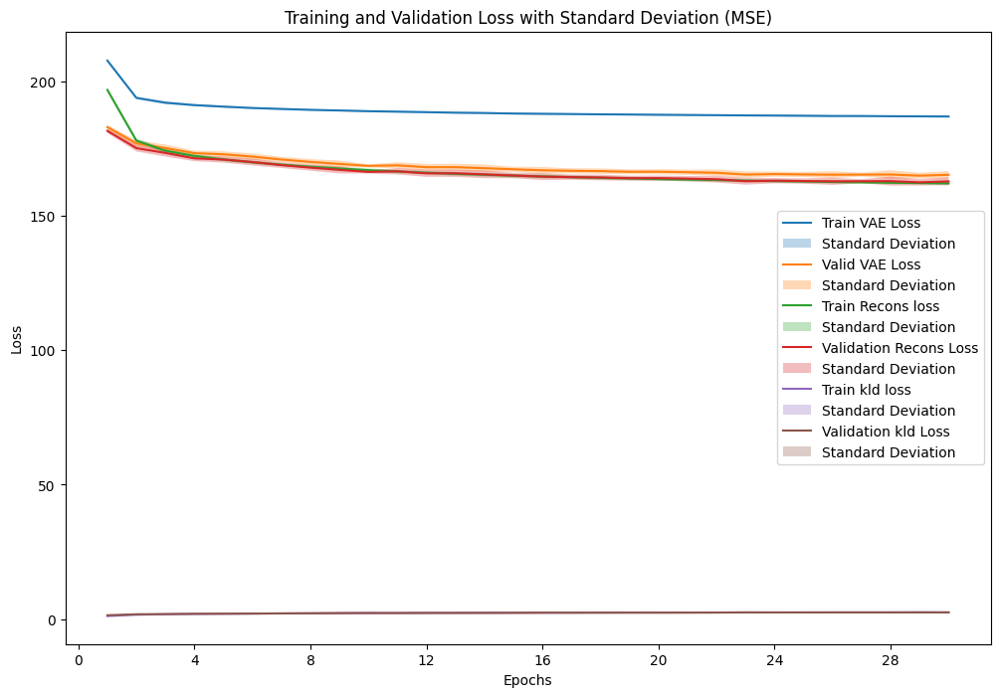

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_4_2.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_4_2 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_4_2_2 = VAE_plot_results(fold_results_4_2, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_4_2_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_4_2_2['epochs'])
    VAE_plot_mean_std(result_data_4_2_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_4_2_2['epochs'])
    VAE_plot_mean_std(result_data_4_2_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_4_2_2['epochs'])
    VAE_plot_mean_std(result_data_4_2_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_4_2_2['epochs'])
    VAE_plot_mean_std(result_data_4_2_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_4_2_2['epochs'])
    VAE_plot_mean_std(result_data_4_2_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_4_2_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_4_2_2['valid_metrics'],
    result_data_4_2_2['test_metrics'],
    result_data_4_2_2['valid_result'],
    result_data_4_2_2['test_result'],
    result_data_4_2_2['recons_valid_result'],
    result_data_4_2_2['recons_test_result'],
    result_data_4_2_2['kld_valid_result'],
    result_data_4_2_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.049434           0.049410           165.318230     164.935830              162.872778        162.872778             2.445452       2.433707
Standard Deviation                 0.000623           0.000525             1.413549       1.137343                1.492490          1.492490             0.096276       0.098903

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.050074,0.050037,166.665543,166.175331
1,2,0.049299,0.049291,165.567867,165.136406
2,3,0.050840,0.050546,168.237196,167.371251
3,4,0.049299,0.049313,165.056118,164.699354
4,5,0.049389,0.049633,165.304801,165.336762
5,6,0.049679,0.049576,166.001455,165.304853
6,7,0.048813,0.048969,163.705090,163.883905
7,8,0.049388,0.048775,165.399630,163.494517
8,9,0.049061,0.049039,164.208133,164.145010
9,10,0.048501,0.048925,163.036467,163.810908


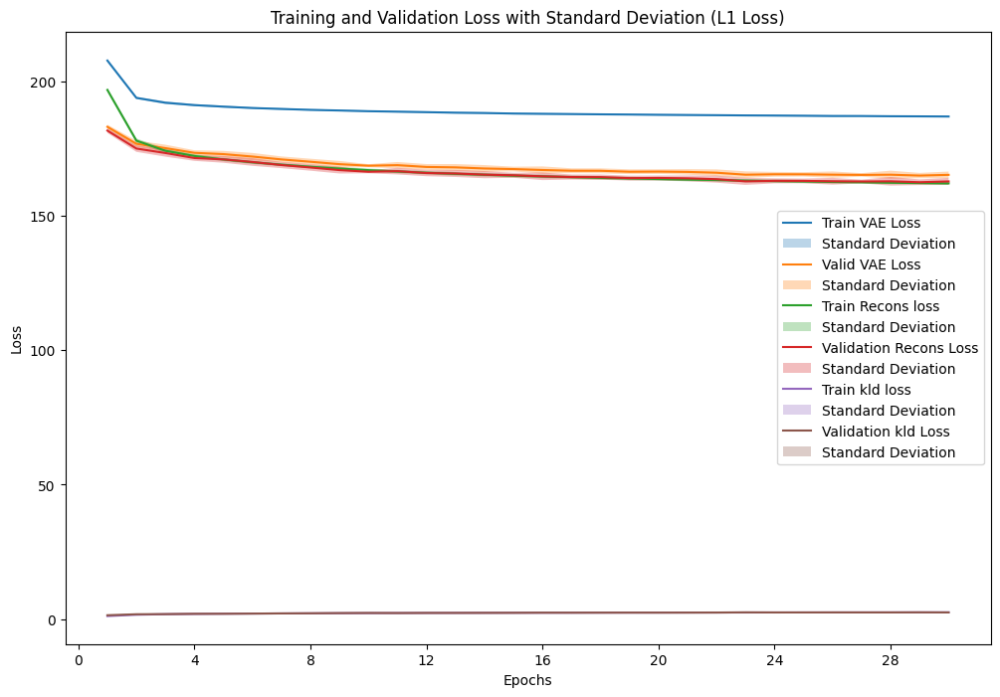

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_4_2.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_4_2 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_4_2_3 = VAE_plot_results(fold_results_4_2, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_4_2_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_4_2_3['epochs'])
    VAE_plot_mean_std(result_data_4_2_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_4_2_3['epochs'])
    VAE_plot_mean_std(result_data_4_2_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_4_2_3['epochs'])
    VAE_plot_mean_std(result_data_4_2_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_4_2_3['epochs'])
    VAE_plot_mean_std(result_data_4_2_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_4_2_3['epochs'])
    VAE_plot_mean_std(result_data_4_2_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_4_2_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_4_2_3['valid_metrics'],
    result_data_4_2_3['test_metrics'],
    result_data_4_2_3['valid_result'],
    result_data_4_2_3['test_result'],
    result_data_4_2_3['recons_valid_result'],
    result_data_4_2_3['recons_test_result'],
    result_data_4_2_3['kld_valid_result'],
    result_data_4_2_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.113680           0.113888           165.218600     164.935273              162.773148        162.773148             2.445452       2.433707
Standard Deviation                 0.000918           0.000887             1.400882       1.072942                1.480478          1.480478             0.096276       0.098903

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.114542,0.114849,166.419341,166.113177
1,2,0.114081,0.114257,165.596617,165.112275
2,3,0.115397,0.115115,168.151641,167.150421
3,4,0.114046,0.114113,165.370680,164.983246
4,5,0.114120,0.114454,165.278129,165.515930
5,6,0.113658,0.113845,165.604185,165.081805
6,7,0.112356,0.112937,163.427439,163.988778
7,8,0.112535,0.111927,165.282403,163.578489
8,9,0.113450,0.113908,163.935138,163.958877
9,10,0.112619,0.113475,163.120425,163.869733


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_4_2 = sum(p.numel() for p in models_4_2[0].parameters())
print(f"Number of parameters in the model: {total_params_4_2}")

Number of parameters in the model: 620156


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


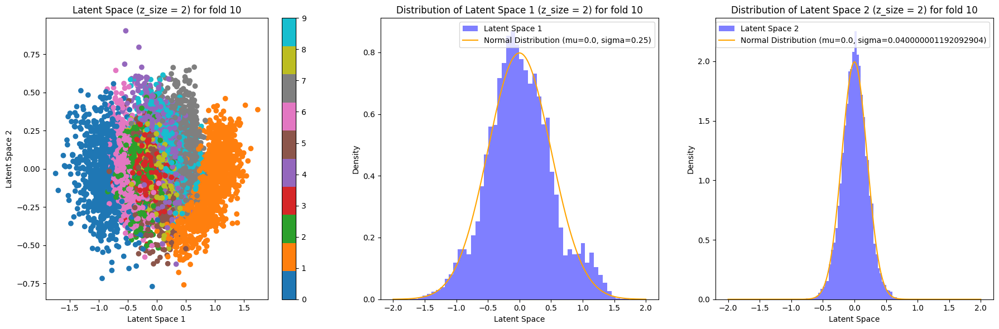

In [ ]:
x = np.linspace(-2, 2, 1000)
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)

std_2 = torch.tensor([[0.5,0.2]], dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_4_2[9], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

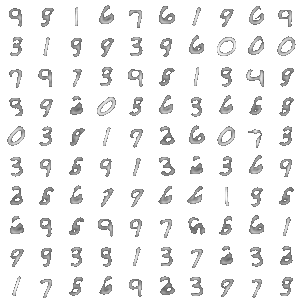

In [ ]:
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)

std_2 = torch.tensor([[0.5,0.2]], dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_4_2[9], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

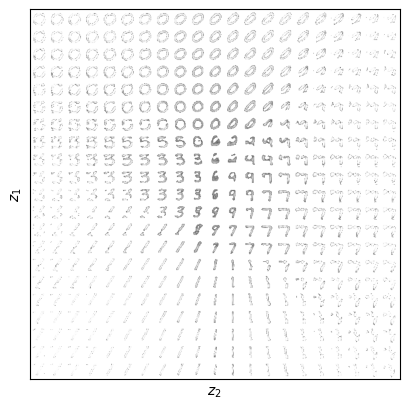

In [ ]:
VAE_visualize_latent_space(models_4_2[1], device)

### Experiment 3.3 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=16, activation is RELU
- Loss: Bernoulli likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_4_3 = 'VAE'
model_config_4_3 = {'D_x': 784, 'n_layers': 1, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset

#set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
set_2_mean = torch.tensor([5,10], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)
#set_2_mean = torch.tensor([-5,-1], dtype=torch.float32)

#std_2 = torch.ones((1, 2), dtype=torch.float32)
std_2 = torch.tensor([15,43], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_4_3, fold_results_4_3 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_4_3),
                                                model_config=model_config_4_3,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=10,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })

Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:358.517403, Training Recons Loss: 305.996460, Training KLD Loss: 5.252094
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.0695296124099417, 'L1 Loss': 0.15521343337728621, 'BCE': 0.2755049605001795}, Validation VAE Loss: {'MSE': 219.7947457496156, 'L1 Loss': 219.639740477217, 'BCE': 220.0238780569523}, Validation Recons Loss: {'MSE': 215.7667562606487, 'L1 Loss': 215.6117509882501, 'BCE': 215.9958887303129}, Validation KLD Loss: {'MSE': 4.027989732458236, 'L1 Loss': 4.027989732458236, 'BCE': 4.027989732458236}
Train Fold/Epoch: 1/2, Training Loss:245.236841, Training Recons Loss: 208.605253, Training KLD Loss: 3.663159
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.06364165472381926, 'L1 Loss': 0.1450622000909866, 'BCE': 0.2555705836795746}, Validation VAE Loss: {'MSE': 204.29225710

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_4_3.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_4_3.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_4_3, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_4_3, f)


## Visualizing reconstructions for all fold

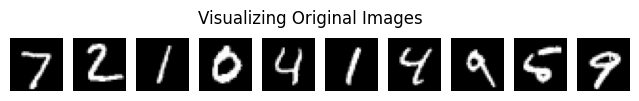

Visualizing reconstructions for fold 1


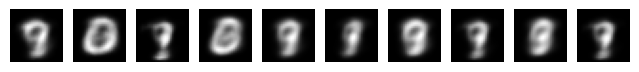

Visualizing reconstructions for fold 2


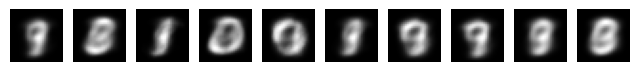

Visualizing reconstructions for fold 3


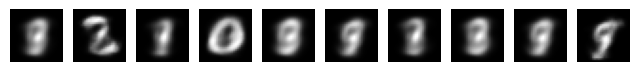

Visualizing reconstructions for fold 4


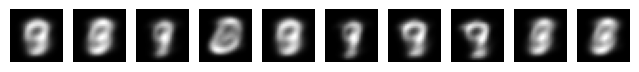

Visualizing reconstructions for fold 5


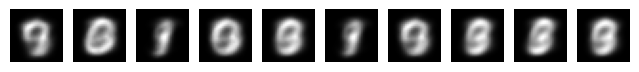

Visualizing reconstructions for fold 6


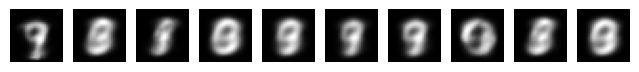

Visualizing reconstructions for fold 7


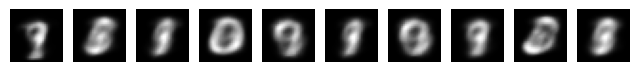

Visualizing reconstructions for fold 8


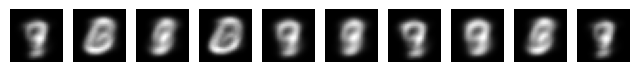

Visualizing reconstructions for fold 9


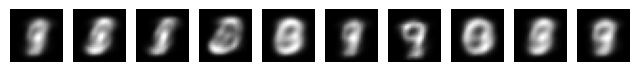

Visualizing reconstructions for fold 10


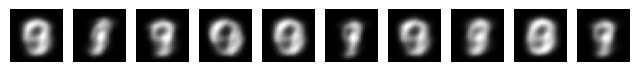

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_4_3.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_4_3 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_4_3):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

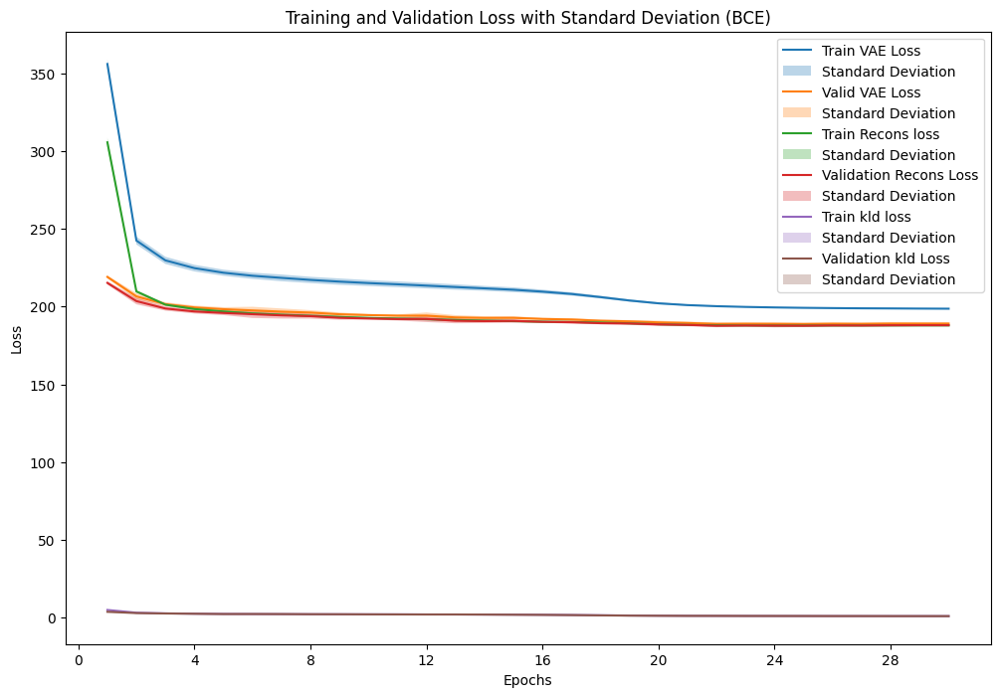

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_4_3.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_4_3 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_4_3_1 = VAE_plot_results(fold_results_4_3, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_4_3_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_4_3_1['epochs'])
    VAE_plot_mean_std(result_data_4_3_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_4_3_1['epochs'])
    VAE_plot_mean_std(result_data_4_3_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_4_3_1['epochs'])
    VAE_plot_mean_std(result_data_4_3_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_4_3_1['epochs'])
    VAE_plot_mean_std(result_data_4_3_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_4_3_1['epochs'])
    VAE_plot_mean_std(result_data_4_3_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_4_3_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_4_3_1['valid_metrics'],
    result_data_4_3_1['test_metrics'],
    result_data_4_3_1['valid_result'],
    result_data_4_3_1['test_result'],
    result_data_4_3_1['recons_valid_result'],
    result_data_4_3_1['recons_test_result'],
    result_data_4_3_1['kld_valid_result'],
    result_data_4_3_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.239779           0.239445           189.048114     188.785526              187.987118        187.987118             1.060996       1.060490
Standard Deviation                 0.000805           0.000440             0.632076       0.320044                0.631177          0.631177             0.031833       0.028079

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.239878,0.239788,189.069277,189.013872
1,2,0.239771,0.239487,189.018420,188.802467
2,3,0.241449,0.240209,190.328404,189.343615
3,4,0.238799,0.239153,188.305442,188.581524
4,5,0.239407,0.238917,188.766316,188.395445
5,6,0.240250,0.238750,189.459403,188.287847
6,7,0.239481,0.239113,188.834299,188.540257
7,8,0.240774,0.239406,189.867165,188.764287
8,9,0.239151,0.239859,188.556617,189.109664
9,10,0.238836,0.239769,188.275798,189.016283


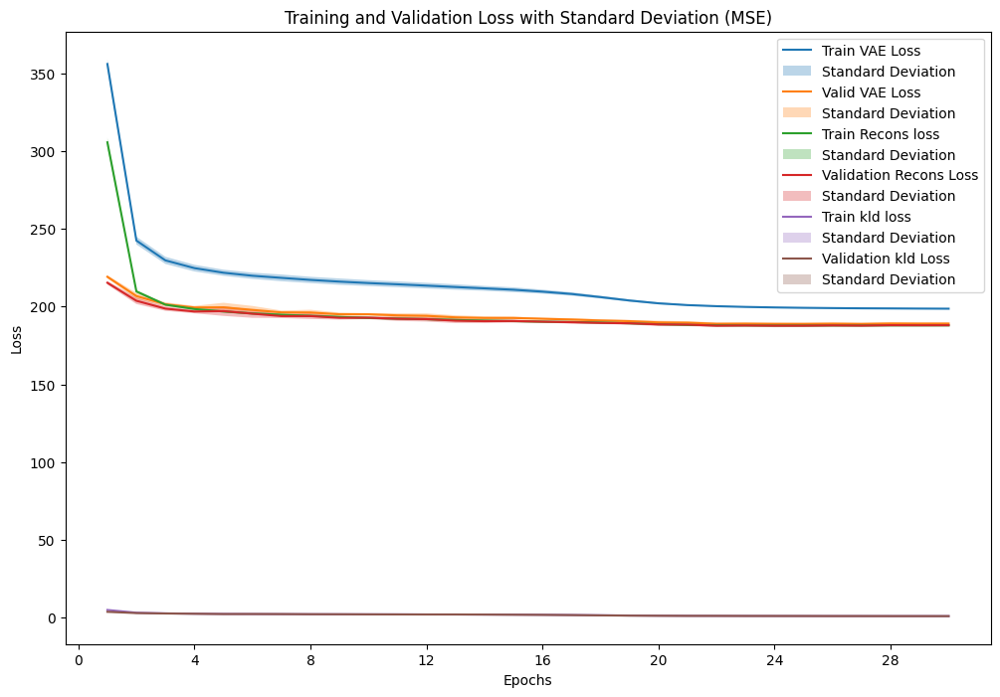

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_4_3.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_4_3 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_4_3_2 = VAE_plot_results(fold_results_4_3, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_4_3_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_4_3_2['epochs'])
    VAE_plot_mean_std(result_data_4_3_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_4_3_2['epochs'])
    VAE_plot_mean_std(result_data_4_3_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_4_3_2['epochs'])
    VAE_plot_mean_std(result_data_4_3_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_4_3_2['epochs'])
    VAE_plot_mean_std(result_data_4_3_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_4_3_2['epochs'])
    VAE_plot_mean_std(result_data_4_3_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_4_3_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_4_3_2['valid_metrics'],
    result_data_4_3_2['test_metrics'],
    result_data_4_3_2['valid_result'],
    result_data_4_3_2['test_result'],
    result_data_4_3_2['recons_valid_result'],
    result_data_4_3_2['recons_test_result'],
    result_data_4_3_2['kld_valid_result'],
    result_data_4_3_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.060113           0.060191           189.045504     188.796586              187.984508        187.984508             1.060996       1.060490
Standard Deviation                 0.000246           0.000170             0.662121       0.407431                0.659578          0.659578             0.031833       0.028079

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.060032,0.060336,189.013846,189.132510
1,2,0.060192,0.060182,189.130654,188.800242
2,3,0.060504,0.060523,190.246207,189.695468
3,4,0.059847,0.060067,188.428203,188.531063
4,5,0.059935,0.059956,188.697840,188.277094
5,6,0.060193,0.059925,189.476734,188.195204
6,7,0.060059,0.060151,188.775896,188.694132
7,8,0.060591,0.060259,190.079577,188.818263
8,9,0.059882,0.060257,188.273702,188.910559
9,10,0.059896,0.060257,188.332383,188.911320


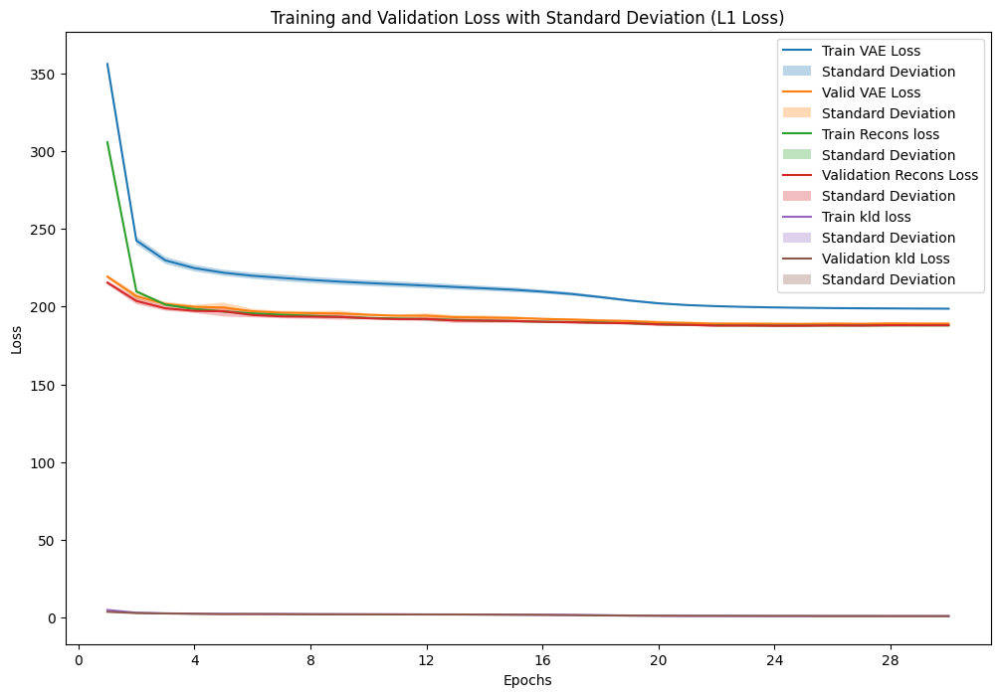

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_4_3.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_4_3 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_4_3_3 = VAE_plot_results(fold_results_4_3, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_4_3_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_4_3_3['epochs'])
    VAE_plot_mean_std(result_data_4_3_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_4_3_3['epochs'])
    VAE_plot_mean_std(result_data_4_3_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_4_3_3['epochs'])
    VAE_plot_mean_std(result_data_4_3_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_4_3_3['epochs'])
    VAE_plot_mean_std(result_data_4_3_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_4_3_3['epochs'])
    VAE_plot_mean_std(result_data_4_3_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_4_3_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_4_3_3['valid_metrics'],
    result_data_4_3_3['test_metrics'],
    result_data_4_3_3['valid_result'],
    result_data_4_3_3['test_result'],
    result_data_4_3_3['recons_valid_result'],
    result_data_4_3_3['recons_test_result'],
    result_data_4_3_3['kld_valid_result'],
    result_data_4_3_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.135152           0.135261           189.104795     188.786892              188.043799        188.043799             1.060996       1.060490
Standard Deviation                 0.000440           0.000198             0.678758       0.327114                0.677385          0.677385             0.031833       0.028079

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.135046,0.135236,189.167611,188.960223
1,2,0.135228,0.135448,189.002449,188.844832
2,3,0.135892,0.135674,190.457773,189.560997
3,4,0.134767,0.135171,188.453015,188.458232
4,5,0.134972,0.135196,188.690608,188.614754
5,6,0.135205,0.134982,189.430551,188.308725
6,7,0.134984,0.134976,188.792533,188.601991
7,8,0.135993,0.135350,190.125578,188.745657
8,9,0.134906,0.135252,188.686081,188.799371
9,10,0.134525,0.135329,188.241750,188.974137


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_4_3 = sum(p.numel() for p in models_4_3[0].parameters())
print(f"Number of parameters in the model: {total_params_4_3}")

Number of parameters in the model: 5492


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


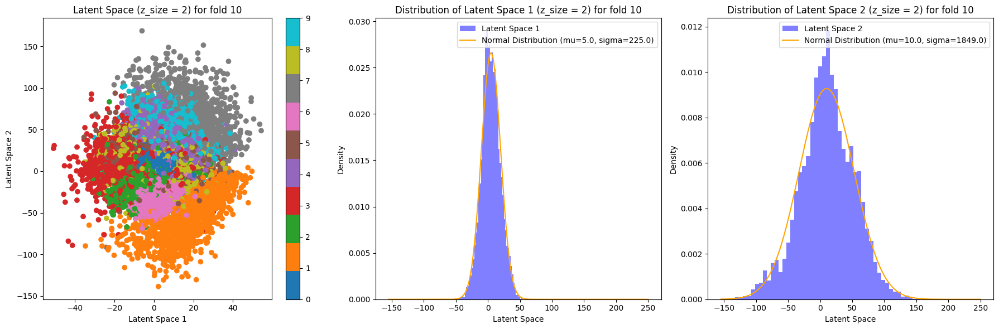

In [ ]:
x = np.linspace(-155, 250, 1000)
set_2_mean = torch.tensor([[5,10]], dtype=torch.float32)

std_2 = torch.tensor([[15,43]], dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_4_3[9], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

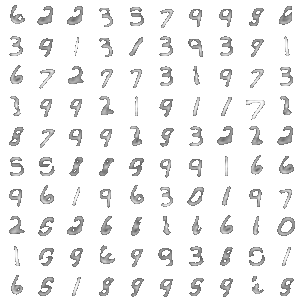

In [ ]:
set_2_mean = torch.tensor([[5,10]], dtype=torch.float32)

std_2 = torch.tensor([[15,43]], dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_4_3[9], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

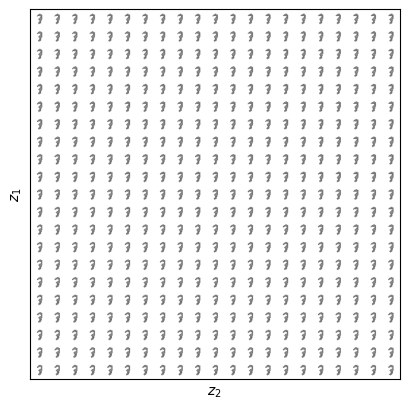

In [ ]:
VAE_visualize_latent_space(models_4_3[1], device)

### Experiment 3.4 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=32, activation is RELU
- Loss: Bernoulli likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_4_4 = 'VAE'
model_config_4_4 = {'D_x': 784, 'n_layers': 2, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
#set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
set_2_mean = torch.tensor([5,10], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)
#set_2_mean = torch.tensor([-5,-1], dtype=torch.float32)

#std_2 = torch.ones((1, 2), dtype=torch.float32)
std_2 = torch.tensor([15,43], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_4_4, fold_results_4_4 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_4_4),
                                                model_config=model_config_4_4,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=10,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })

Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:227.973247, Training Recons Loss: 208.757307, Training KLD Loss: 1.921594
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.06334937863210414, 'L1 Loss': 0.14026972746595423, 'BCE': 0.24942667148214706}, Validation VAE Loss: {'MSE': 197.4448208098716, 'L1 Loss': 197.31081033260264, 'BCE': 197.30253844565533}, Validation Recons Loss: {'MSE': 195.69279301420173, 'L1 Loss': 195.55878269926032, 'BCE': 195.550510812313}, Validation KLD Loss: {'MSE': 1.752027564860405, 'L1 Loss': 1.752027564860405, 'BCE': 1.752027564860405}
Train Fold/Epoch: 1/2, Training Loss:208.990192, Training Recons Loss: 192.734387, Training KLD Loss: 1.625581
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.06051371535880769, 'L1 Loss': 0.134056382198283, 'BCE': 0.23999777880120785}, Validation VAE Loss: {'MSE': 189.94

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_4_4.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_4_4.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_4_4, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_4_4, f)


## Visualizing reconstructions for all fold

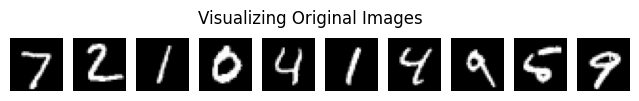

Visualizing reconstructions for fold 1


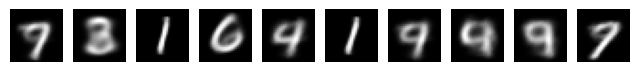

Visualizing reconstructions for fold 2


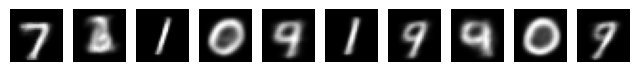

Visualizing reconstructions for fold 3


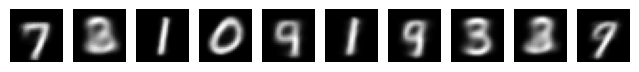

Visualizing reconstructions for fold 4


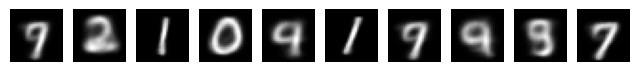

Visualizing reconstructions for fold 5


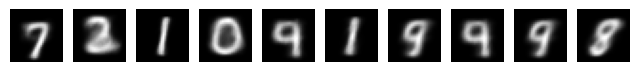

Visualizing reconstructions for fold 6


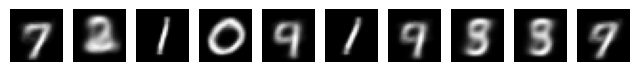

Visualizing reconstructions for fold 7


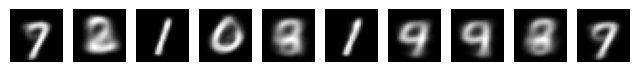

Visualizing reconstructions for fold 8


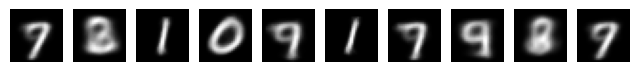

Visualizing reconstructions for fold 9


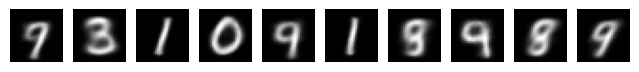

Visualizing reconstructions for fold 10


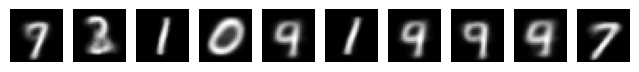

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_4_4.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_4_4 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_4_4):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

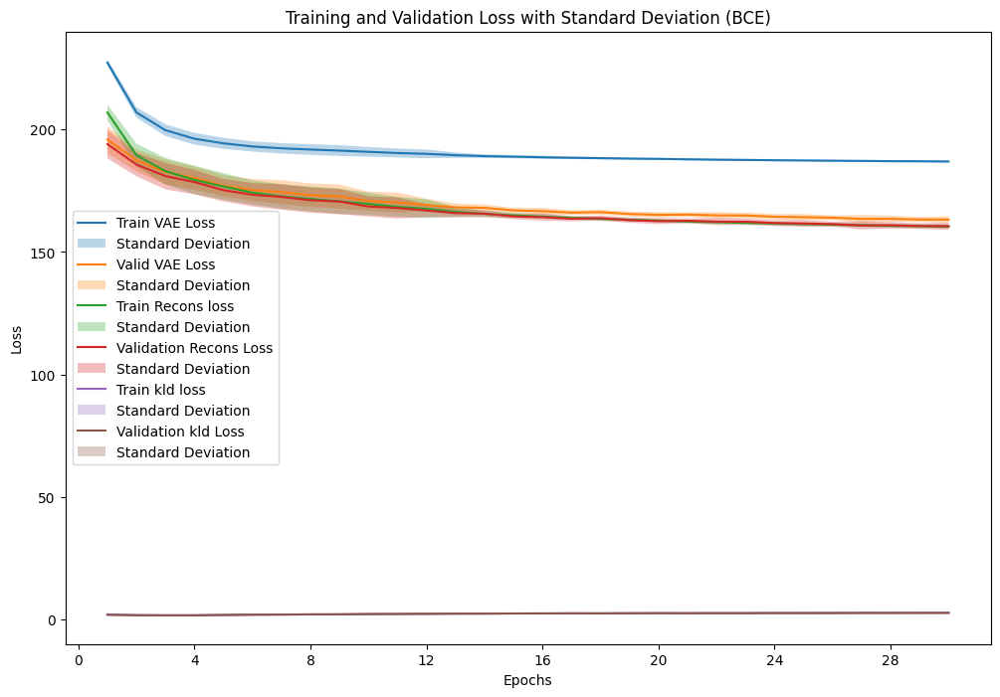

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_4_4.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_4_4 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_4_4_1 = VAE_plot_results(fold_results_4_4, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_4_4_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_4_4_1['epochs'])
    VAE_plot_mean_std(result_data_4_4_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_4_4_1['epochs'])
    VAE_plot_mean_std(result_data_4_4_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_4_4_1['epochs'])
    VAE_plot_mean_std(result_data_4_4_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_4_4_1['epochs'])
    VAE_plot_mean_std(result_data_4_4_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_4_4_1['epochs'])
    VAE_plot_mean_std(result_data_4_4_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_4_4_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_4_4_1['valid_metrics'],
    result_data_4_4_1['test_metrics'],
    result_data_4_4_1['valid_result'],
    result_data_4_4_1['test_result'],
    result_data_4_4_1['recons_valid_result'],
    result_data_4_4_1['recons_test_result'],
    result_data_4_4_1['kld_valid_result'],
    result_data_4_4_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.204742           0.204592           163.191639     163.054529              160.517354        160.517354             2.674286       2.654364
Standard Deviation                 0.001767           0.001593             1.285564       1.146795                1.385213          1.385213             0.109981       0.111459

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.203550,0.203230,162.351768,162.077429
1,2,0.205192,0.205605,163.518910,163.809964
2,3,0.205566,0.204011,163.789246,162.549390
3,4,0.201115,0.201681,160.595510,161.020332
4,5,0.202889,0.203062,161.788156,161.906107
5,6,0.207350,0.207052,165.070813,164.806564
6,7,0.205907,0.205592,164.013309,163.751002
7,8,0.206606,0.205582,164.645187,163.804827
8,9,0.204044,0.203851,162.684788,162.531240
9,10,0.205196,0.206256,163.458707,164.288432


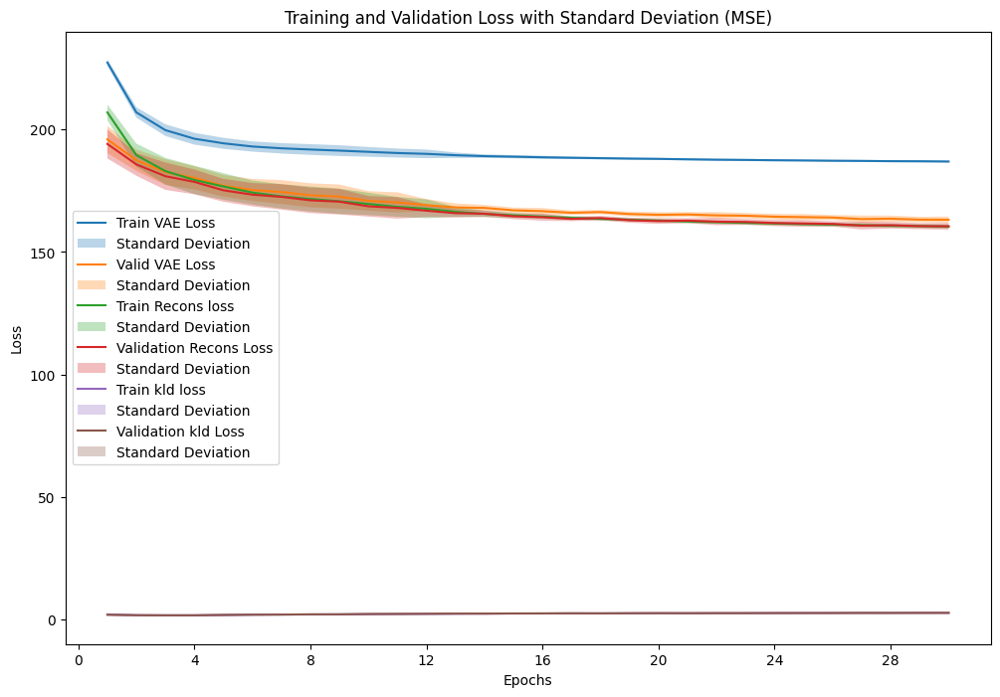

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_4_4.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_4_4 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_4_4_2 = VAE_plot_results(fold_results_4_4, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_4_4_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_4_4_2['epochs'])
    VAE_plot_mean_std(result_data_4_4_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_4_4_2['epochs'])
    VAE_plot_mean_std(result_data_4_4_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_4_4_2['epochs'])
    VAE_plot_mean_std(result_data_4_4_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_4_4_2['epochs'])
    VAE_plot_mean_std(result_data_4_4_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_4_4_2['epochs'])
    VAE_plot_mean_std(result_data_4_4_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_4_4_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_4_4_2['valid_metrics'],
    result_data_4_4_2['test_metrics'],
    result_data_4_4_2['valid_result'],
    result_data_4_4_2['test_result'],
    result_data_4_4_2['recons_valid_result'],
    result_data_4_4_2['recons_test_result'],
    result_data_4_4_2['kld_valid_result'],
    result_data_4_4_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.048473           0.048555           163.164569     163.058885              160.490283        160.490283             2.674286       2.654364
Standard Deviation                 0.000616           0.000571             1.288881       1.113385                1.389883          1.389883             0.109981       0.111459

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.047891,0.048211,161.857514,162.079986
1,2,0.048947,0.049025,163.588455,163.455078
2,3,0.048614,0.048424,163.707490,163.012206
3,4,0.047182,0.047467,160.613562,161.029711
4,5,0.047905,0.047944,162.072293,161.794723
5,6,0.049117,0.049214,165.039850,164.767559
6,7,0.048957,0.048959,164.119868,163.893944
7,8,0.049035,0.048915,164.589750,163.996186
8,9,0.048190,0.048157,162.688509,162.583217
9,10,0.048896,0.049237,163.368395,163.976241


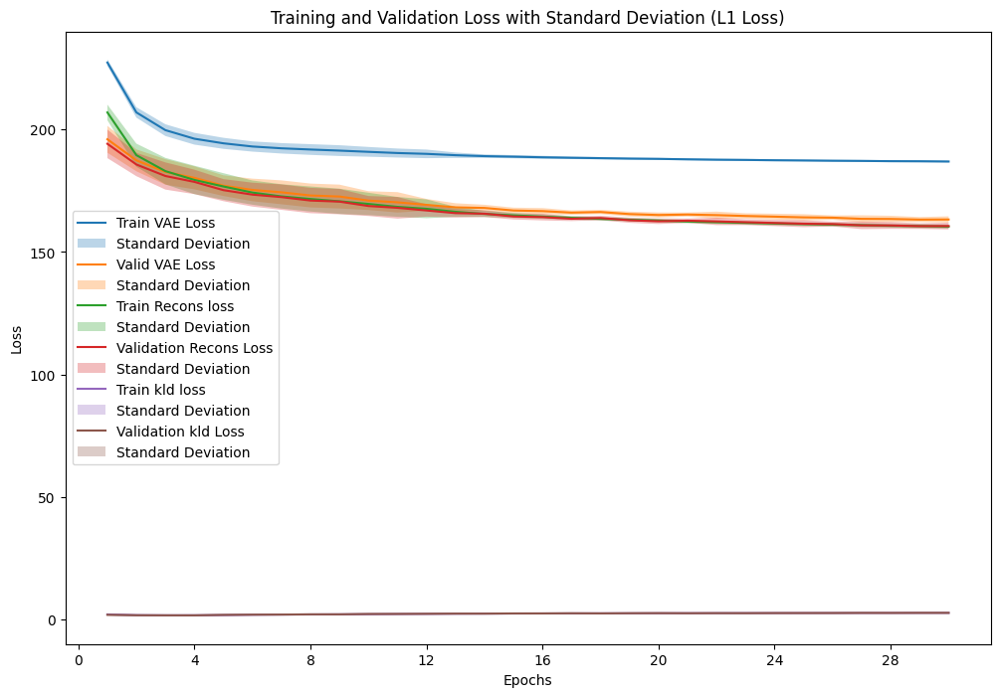

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_4_4.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_4_4 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_4_4_3 = VAE_plot_results(fold_results_4_4, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_4_4_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_4_4_3['epochs'])
    VAE_plot_mean_std(result_data_4_4_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_4_4_3['epochs'])
    VAE_plot_mean_std(result_data_4_4_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_4_4_3['epochs'])
    VAE_plot_mean_std(result_data_4_4_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_4_4_3['epochs'])
    VAE_plot_mean_std(result_data_4_4_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_4_4_3['epochs'])
    VAE_plot_mean_std(result_data_4_4_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_4_4_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_4_4_3['valid_metrics'],
    result_data_4_4_3['test_metrics'],
    result_data_4_4_3['valid_result'],
    result_data_4_4_3['test_result'],
    result_data_4_4_3['recons_valid_result'],
    result_data_4_4_3['recons_test_result'],
    result_data_4_4_3['kld_valid_result'],
    result_data_4_4_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.111333           0.111700           163.123325     163.051458              160.449039        160.449039             2.674286       2.654364
Standard Deviation                 0.000977           0.000952             1.322091       1.202143                1.421167          1.421167             0.109981       0.111459

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.110840,0.110980,162.311132,161.742419
1,2,0.111298,0.111988,163.458334,163.857952
2,3,0.111467,0.111379,163.908040,162.887851
3,4,0.109750,0.110700,160.277334,161.018726
4,5,0.110367,0.110560,162.066490,161.732610
5,6,0.112763,0.112927,164.927508,164.622324
6,7,0.112018,0.112285,163.774474,163.577111
7,8,0.112654,0.112808,164.750979,164.200891
8,9,0.110233,0.110465,162.417005,162.481741
9,10,0.111939,0.112907,163.341949,164.392957


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_4_4 = sum(p.numel() for p in models_4_4[0].parameters())
print(f"Number of parameters in the model: {total_params_4_4}")

Number of parameters in the model: 620156


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


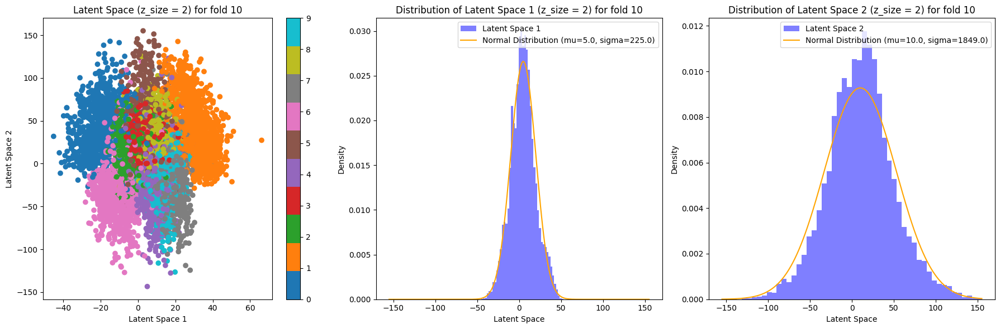

In [ ]:
x = np.linspace(-155, 155, 1000)
set_2_mean = torch.tensor([[5,10]], dtype=torch.float32)

std_2 = torch.tensor([[15,43]], dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_4_4[3], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

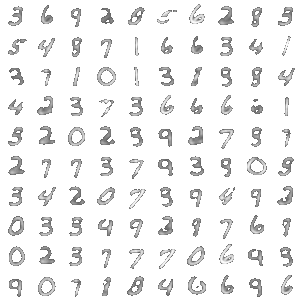

In [ ]:
set_2_mean = torch.tensor([[5,10]], dtype=torch.float32)

std_2 = torch.tensor([[15,43]], dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_4_4[3], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

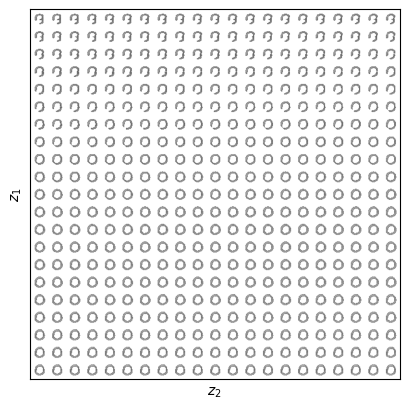

In [ ]:
VAE_visualize_latent_space(models_4_4[1], device)

### Experiments 2 : VAE with n_layers =2

- We evaluate the performance of both the autoencoder and the variational autoencoder by systematically varying the latent space dimensionality (Dz) across different values, specifically {2,16, 32}. Additionally, for this assessment, we set the number of layers (n_layer) to be equal to 2, considering likelihoods modeled as Gaussian and Bernoulli.

## Test 3 VAE: MSE

### Experiment 3.1 : AE with 2 layer

- Model: VAE of 2 layer, D_x=784, D_z=2, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

### Experiment 3.1 : AE with 2 layer

- Model: VAE of 2 layer, D_x=784, D_z=2, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_6 = 'VAE'
model_config_3_6 = {'D_x': 784, 'n_layers': 1, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
#set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
set_2_mean = torch.tensor([-10,16], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)
#set_2_mean = torch.tensor([-5,-1], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)
#std_2 = torch.tensor([10,20], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_3_6, fold_results_3_6 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_6),
                                                model_config=model_config_3_6,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=10,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })

Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:647.236427, Training Recons Loss: 391.347830, Training KLD Loss: 25.588860
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.07043626658776973, 'L1 Loss': 0.16027792717548126, 'BCE': 0.2777329233098537}, Validation VAE Loss: {'MSE': 228.00116275219207, 'L1 Loss': 227.8680596858897, 'BCE': 227.96116378459524}, Validation Recons Loss: {'MSE': 217.78261144110496, 'L1 Loss': 217.64950821247507, 'BCE': 217.74261263583568}, Validation KLD Loss: {'MSE': 10.218551275577951, 'L1 Loss': 10.218551275577951, 'BCE': 10.218551275577951}
Train Fold/Epoch: 1/2, Training Loss:310.177976, Training Recons Loss: 214.977544, Training KLD Loss: 9.520043
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.06861823880450522, 'L1 Loss': 0.15476561749869205, 'BCE': 0.2701959351592876}, Validation VAE Loss: {'MSE': 

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_6.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_6.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_6, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_6, f)


## Visualizing reconstructions for all fold

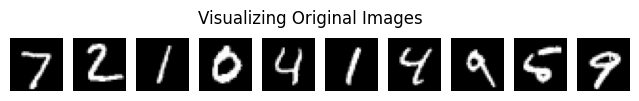

Visualizing reconstructions for fold 1


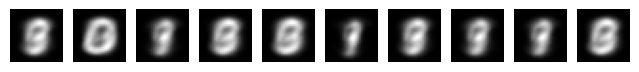

Visualizing reconstructions for fold 2


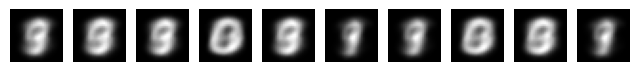

Visualizing reconstructions for fold 3


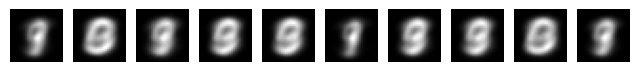

Visualizing reconstructions for fold 4


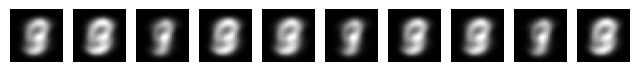

Visualizing reconstructions for fold 5


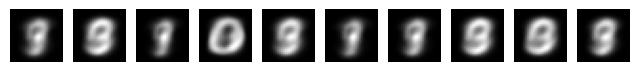

Visualizing reconstructions for fold 6


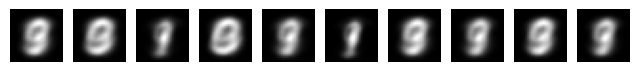

Visualizing reconstructions for fold 7


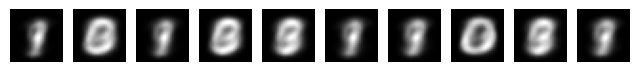

Visualizing reconstructions for fold 8


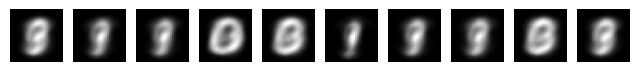

Visualizing reconstructions for fold 9


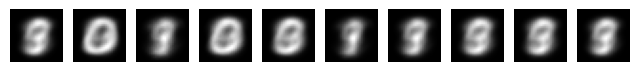

Visualizing reconstructions for fold 10


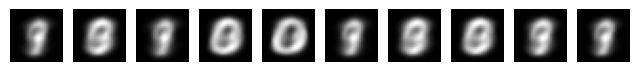

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_6.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_6 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_6):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

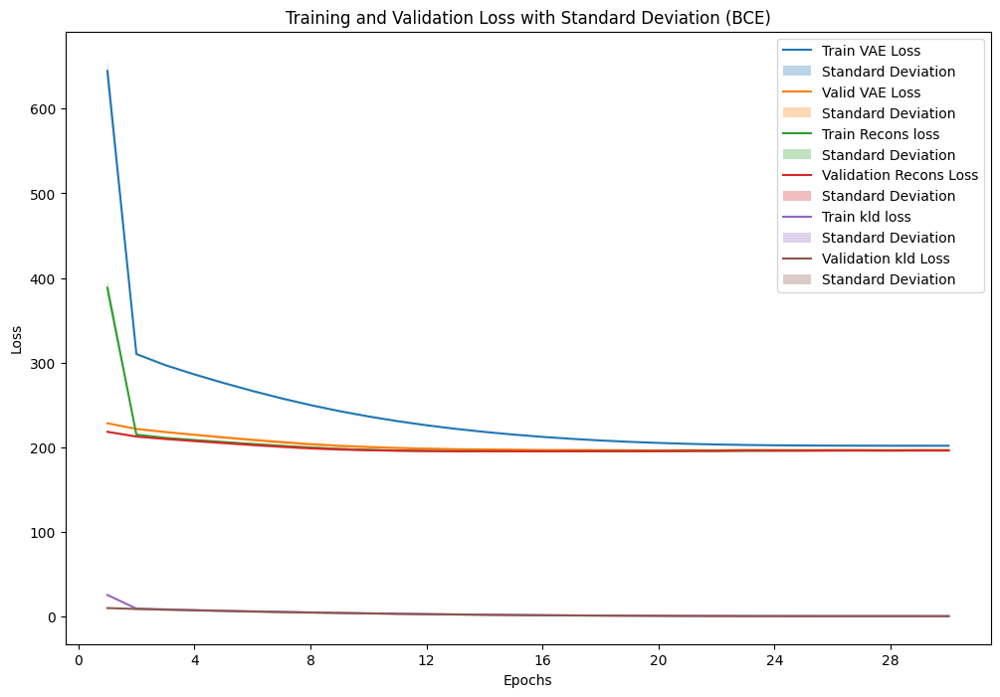

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_6.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_6 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_6_1 = VAE_plot_results(fold_results_3_6, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_6_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_6_1['epochs'])
    VAE_plot_mean_std(result_data_3_6_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_6_1['epochs'])
    VAE_plot_mean_std(result_data_3_6_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_6_1['epochs'])
    VAE_plot_mean_std(result_data_3_6_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_6_1['epochs'])
    VAE_plot_mean_std(result_data_3_6_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_6_1['epochs'])
    VAE_plot_mean_std(result_data_3_6_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_6_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_6_1['valid_metrics'],
    result_data_3_6_1['test_metrics'],
    result_data_3_6_1['valid_result'],
    result_data_3_6_1['test_result'],
    result_data_3_6_1['recons_valid_result'],
    result_data_3_6_1['recons_test_result'],
    result_data_3_6_1['kld_valid_result'],
    result_data_3_6_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.250399           0.249738           196.867472      196.36017              196.313108        196.313108             0.554363       0.565315
Standard Deviation                 0.000866           0.000500             0.672470        0.35675                0.678902          0.678902             0.033167       0.035287

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.249816,0.249834,196.395068,196.428049
1,2,0.250359,0.249814,196.819414,196.409659
2,3,0.250072,0.249049,196.675451,195.871660
3,4,0.250028,0.249832,196.564070,196.423659
4,5,0.249771,0.249317,196.387844,196.055506
5,6,0.250540,0.249017,197.028040,195.847979
6,7,0.250845,0.249856,197.202729,196.443117
7,8,0.252676,0.250230,198.635334,196.707642
8,9,0.250534,0.250759,196.918782,197.094073
9,10,0.249353,0.249676,196.047982,196.320355


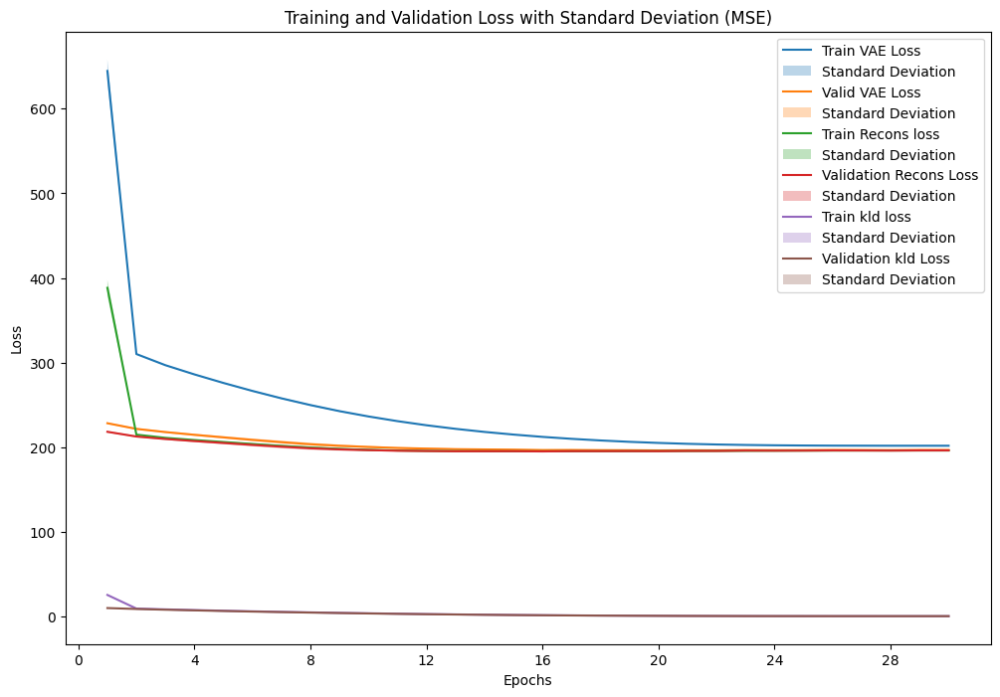

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_6.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_6 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_6_2 = VAE_plot_results(fold_results_3_6, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_6_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_6_2['epochs'])
    VAE_plot_mean_std(result_data_3_6_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_6_2['epochs'])
    VAE_plot_mean_std(result_data_3_6_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_6_2['epochs'])
    VAE_plot_mean_std(result_data_3_6_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_6_2['epochs'])
    VAE_plot_mean_std(result_data_3_6_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_6_2['epochs'])
    VAE_plot_mean_std(result_data_3_6_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_6_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_6_2['valid_metrics'],
    result_data_3_6_2['test_metrics'],
    result_data_3_6_2['valid_result'],
    result_data_3_6_2['test_result'],
    result_data_3_6_2['recons_valid_result'],
    result_data_3_6_2['recons_test_result'],
    result_data_3_6_2['kld_valid_result'],
    result_data_3_6_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.063254           0.063321           196.875752     196.398565              196.321389        196.321389             0.554363       0.565315
Standard Deviation                 0.000311           0.000204             0.731371       0.392328                0.732386          0.732386             0.033167       0.035287

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.062970,0.063238,196.367219,196.270829
1,2,0.063317,0.063335,196.955645,196.417988
2,3,0.063238,0.063087,196.907582,195.878408
3,4,0.063129,0.063274,196.695870,196.365024
4,5,0.062949,0.063174,196.255476,196.076170
5,6,0.063290,0.063108,197.165377,195.978399
6,7,0.063459,0.063388,197.190030,196.603238
7,8,0.064038,0.063524,198.745471,196.795483
8,9,0.063230,0.063809,196.531125,197.273621
9,10,0.062915,0.063274,195.943729,196.326495


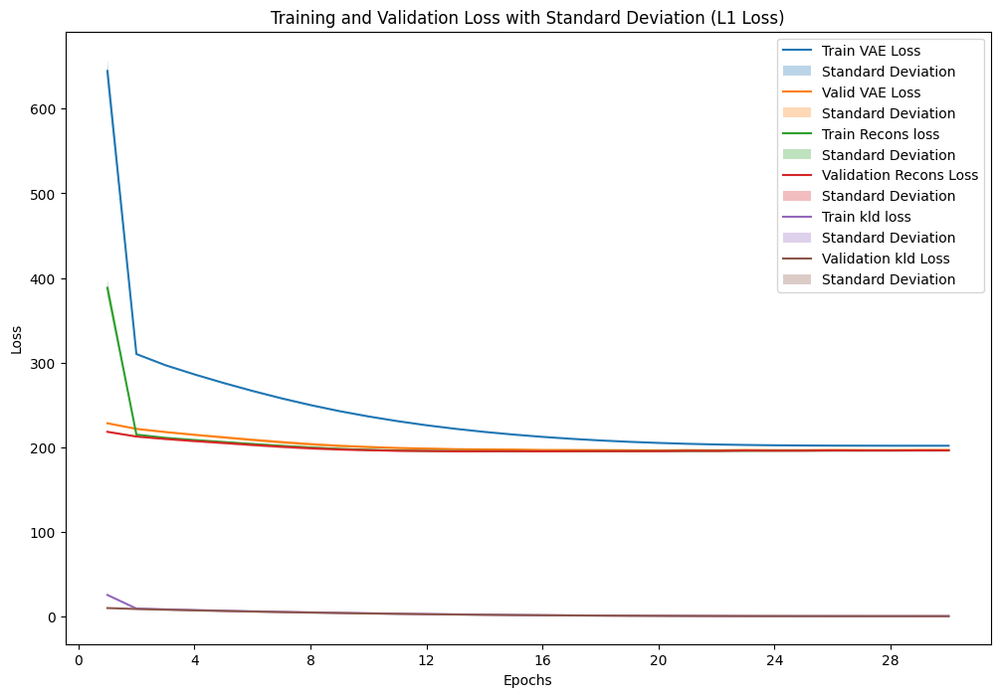

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_6.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_6 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_6_3 = VAE_plot_results(fold_results_3_6, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_6_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_6_3['epochs'])
    VAE_plot_mean_std(result_data_3_6_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_6_3['epochs'])
    VAE_plot_mean_std(result_data_3_6_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_6_3['epochs'])
    VAE_plot_mean_std(result_data_3_6_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_6_3['epochs'])
    VAE_plot_mean_std(result_data_3_6_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_6_3['epochs'])
    VAE_plot_mean_std(result_data_3_6_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_6_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_6_3['valid_metrics'],
    result_data_3_6_3['test_metrics'],
    result_data_3_6_3['valid_result'],
    result_data_3_6_3['test_result'],
    result_data_3_6_3['recons_valid_result'],
    result_data_3_6_3['recons_test_result'],
    result_data_3_6_3['kld_valid_result'],
    result_data_3_6_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.141957           0.142054           196.858019     196.324513              196.303656        196.303656             0.554363       0.565315
Standard Deviation                 0.000483           0.000375             0.760272       0.396626                0.763270          0.763270             0.033167       0.035287

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.142127,0.142943,196.286082,196.508526
1,2,0.142358,0.142357,196.901474,196.245291
2,3,0.142102,0.141815,196.837821,195.808946
3,4,0.142042,0.142277,196.704237,196.394173
4,5,0.141612,0.141711,196.491538,196.031239
5,6,0.141949,0.141779,196.954798,195.785185
6,7,0.141648,0.141610,197.154369,196.515211
7,8,0.143007,0.142041,198.856393,196.688958
8,9,0.141151,0.141901,196.601399,197.146117
9,10,0.141577,0.142109,195.792077,196.121487


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_6 = sum(p.numel() for p in models_3_6[0].parameters())
print(f"Number of parameters in the model: {total_params_3_6}")

Number of parameters in the model: 5492


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


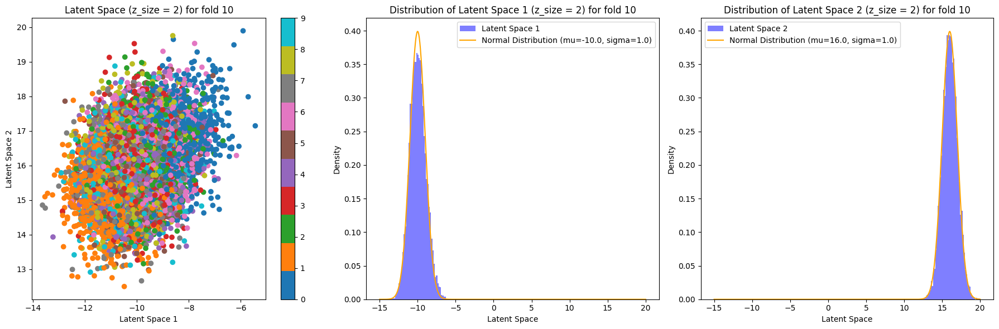

In [ ]:
x = np.linspace(-15, 20, 1000)
set_2_mean = torch.tensor([[-10,16]], dtype=torch.float32)


std_2 = torch.ones((1, 2), dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_6[9], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

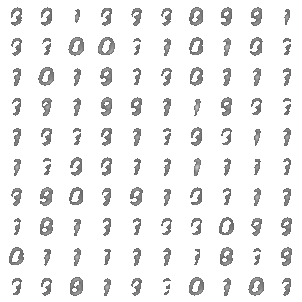

In [ ]:
set_2_mean = torch.tensor([[-10,16]], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_6[9], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

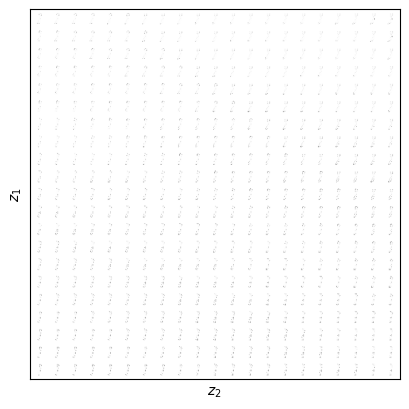

In [ ]:
VAE_visualize_latent_space(models_3_6[1], device)

### Experiment 3.2 : AE with 2 layer

- Model: VAE of 2 layer, D_x=784, D_z=16, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_7 = 'VAE'
model_config_3_7 = {'D_x': 784, 'n_layers': 2, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
#set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
set_2_mean = torch.tensor([-10,16], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)
#set_2_mean = torch.tensor([-5,-1], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)
#std_2 = torch.tensor([10,20], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_3_7, fold_results_3_7 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_7),
                                                model_config=model_config_3_7,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=10,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })

Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:289.550889, Training Recons Loss: 201.571450, Training KLD Loss: 8.797944
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.06093041309492385, 'L1 Loss': 0.13696998769932606, 'BCE': 0.24539425937419243}, Validation VAE Loss: {'MSE': 194.82874346793966, 'L1 Loss': 194.6481516411964, 'BCE': 195.00253166036404}, Validation Recons Loss: {'MSE': 192.21531076634184, 'L1 Loss': 192.03471893959858, 'BCE': 192.38909912109375}, Validation KLD Loss: {'MSE': 2.6134325367339115, 'L1 Loss': 2.6134325367339115, 'BCE': 2.6134325367339115}
Train Fold/Epoch: 1/2, Training Loss:205.993125, Training Recons Loss: 192.979288, Training KLD Loss: 1.301384
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.0615120113609319, 'L1 Loss': 0.1401099017325868, 'BCE': 0.24568812660080322}, Validation VAE Loss: {'MSE': 1

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_7.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_7.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_7, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_7, f)


## Visualizing reconstructions for all fold

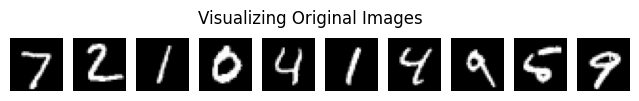

Visualizing reconstructions for fold 1


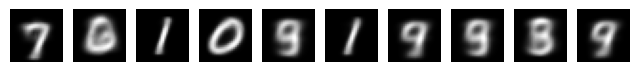

Visualizing reconstructions for fold 2


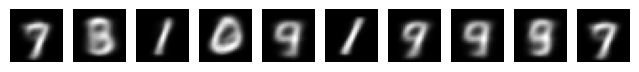

Visualizing reconstructions for fold 3


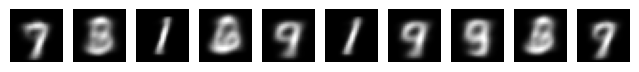

Visualizing reconstructions for fold 4


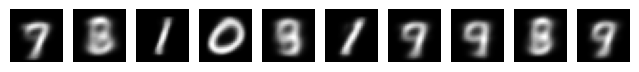

Visualizing reconstructions for fold 5


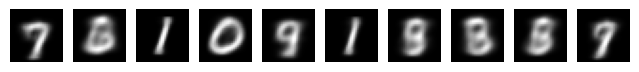

Visualizing reconstructions for fold 6


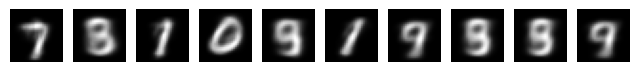

Visualizing reconstructions for fold 7


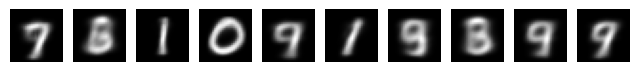

Visualizing reconstructions for fold 8


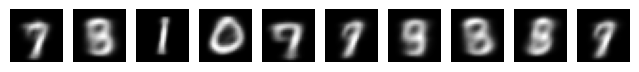

Visualizing reconstructions for fold 9


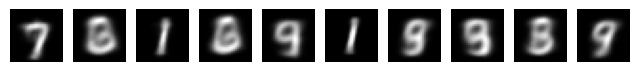

Visualizing reconstructions for fold 10


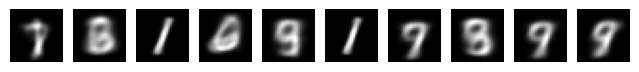

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_7.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_7 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_7):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

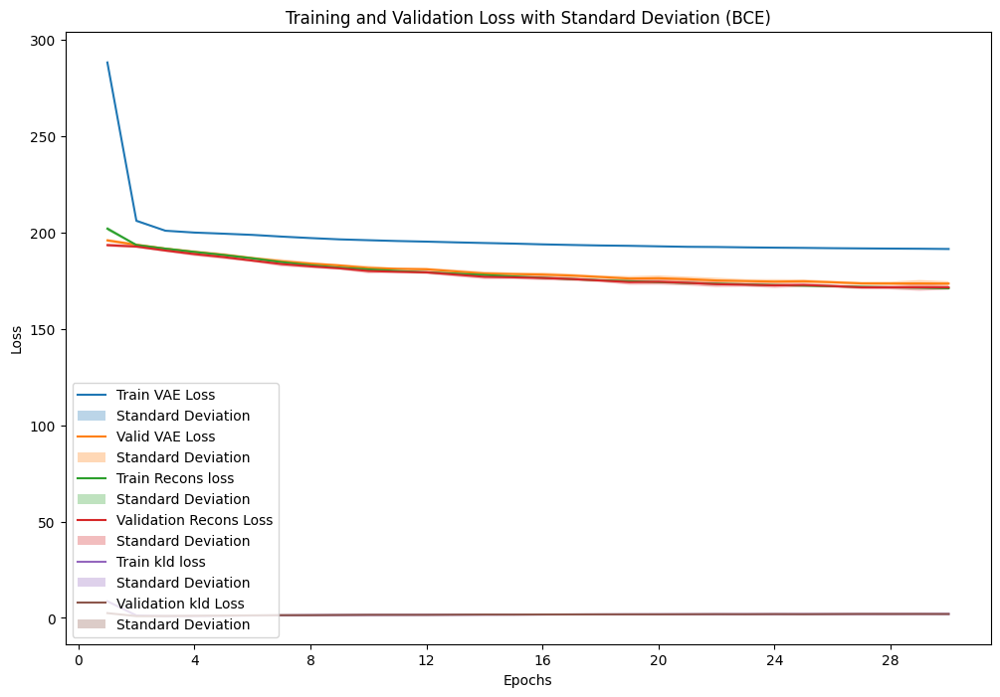

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_7.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_7 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_7_1 = VAE_plot_results(fold_results_3_7, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_7_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_7_1['epochs'])
    VAE_plot_mean_std(result_data_3_7_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_7_1['epochs'])
    VAE_plot_mean_std(result_data_3_7_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_7_1['epochs'])
    VAE_plot_mean_std(result_data_3_7_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_7_1['epochs'])
    VAE_plot_mean_std(result_data_3_7_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_7_1['epochs'])
    VAE_plot_mean_std(result_data_3_7_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_7_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_7_1['valid_metrics'],
    result_data_3_7_1['test_metrics'],
    result_data_3_7_1['valid_result'],
    result_data_3_7_1['test_result'],
    result_data_3_7_1['recons_valid_result'],
    result_data_3_7_1['recons_test_result'],
    result_data_3_7_1['kld_valid_result'],
    result_data_3_7_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.218713           0.218705           173.475043     173.457440              171.471236        171.471236             2.003807       1.992773
Standard Deviation                 0.001436           0.001300             1.087242       0.980803                1.125523          1.125523             0.077566       0.068244

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.218469,0.217921,173.261586,172.835432
1,2,0.218161,0.217642,173.057197,172.644984
2,3,0.219067,0.219179,173.904293,173.957076
3,4,0.220052,0.220329,174.400298,174.607871
4,5,0.221398,0.221509,175.499911,175.591561
5,6,0.219955,0.219208,174.405782,173.806576
6,7,0.216279,0.216967,171.668168,172.184015
7,8,0.218900,0.218071,173.660384,172.973229
8,9,0.217814,0.218267,172.745360,173.096932
9,10,0.217038,0.217958,172.147453,172.876725


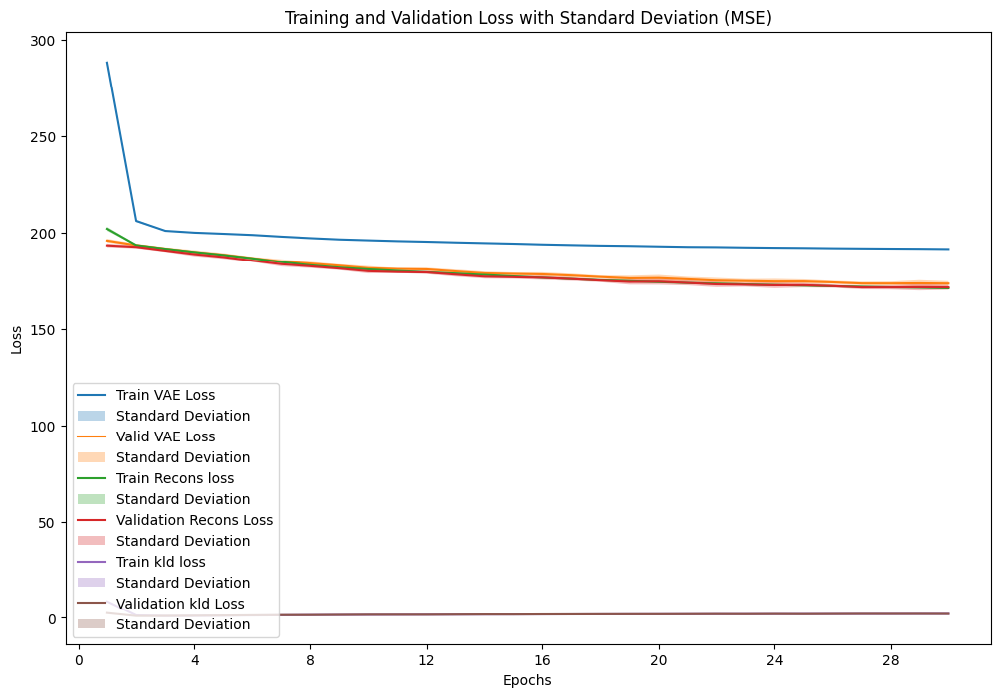

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_7.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_7 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_7_2 = VAE_plot_results(fold_results_3_7, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_7_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_7_2['epochs'])
    VAE_plot_mean_std(result_data_3_7_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_7_2['epochs'])
    VAE_plot_mean_std(result_data_3_7_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_7_2['epochs'])
    VAE_plot_mean_std(result_data_3_7_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_7_2['epochs'])
    VAE_plot_mean_std(result_data_3_7_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_7_2['epochs'])
    VAE_plot_mean_std(result_data_3_7_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_7_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_7_2['valid_metrics'],
    result_data_3_7_2['test_metrics'],
    result_data_3_7_2['valid_result'],
    result_data_3_7_2['test_result'],
    result_data_3_7_2['recons_valid_result'],
    result_data_3_7_2['recons_test_result'],
    result_data_3_7_2['kld_valid_result'],
    result_data_3_7_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.053248           0.053449           173.425313     173.486203              171.421506        171.421506             2.003807       1.992773
Standard Deviation                 0.000480           0.000401             1.207852       0.964018                1.238289          1.238289             0.077566       0.068244

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.052913,0.053337,172.676425,173.128113
1,2,0.053120,0.053212,172.986639,172.792269
2,3,0.053560,0.053628,174.167881,173.931351
3,4,0.053833,0.053960,174.707995,174.671351
4,5,0.054052,0.054293,175.412186,175.515796
5,6,0.053601,0.053571,174.454872,173.870454
6,7,0.052628,0.052858,171.801152,172.082210
7,8,0.053274,0.053198,173.842230,172.966551
8,9,0.052954,0.053242,172.499859,172.982489
9,10,0.052546,0.053195,171.703893,172.921446


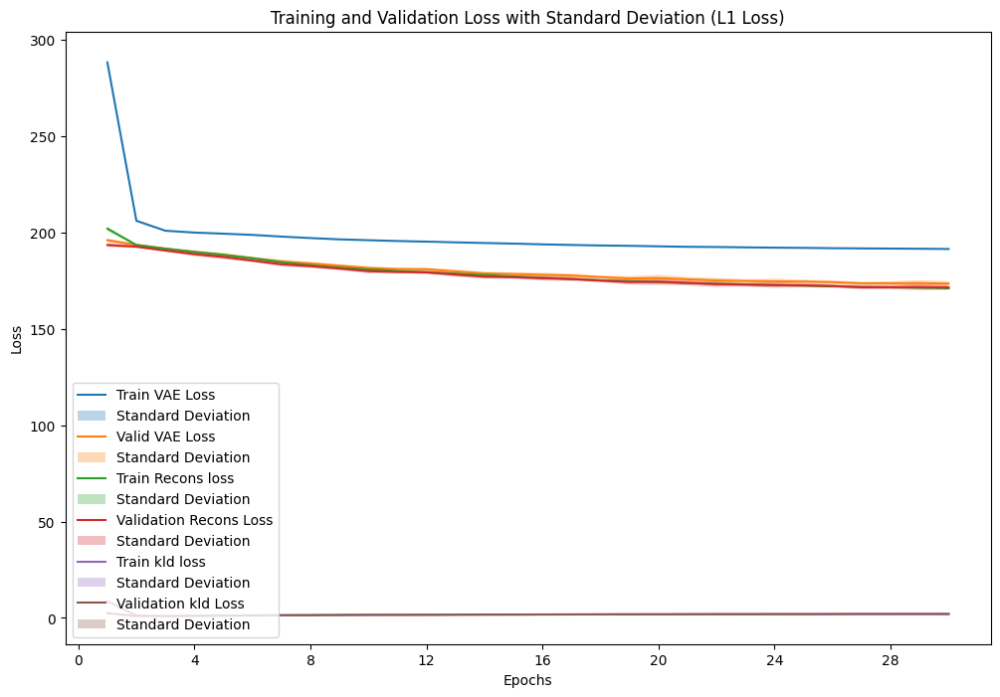

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_7.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_7 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_7_3 = VAE_plot_results(fold_results_3_7, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_7_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_7_3['epochs'])
    VAE_plot_mean_std(result_data_3_7_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_7_3['epochs'])
    VAE_plot_mean_std(result_data_3_7_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_7_3['epochs'])
    VAE_plot_mean_std(result_data_3_7_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_7_3['epochs'])
    VAE_plot_mean_std(result_data_3_7_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_7_3['epochs'])
    VAE_plot_mean_std(result_data_3_7_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_7_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_7_3['valid_metrics'],
    result_data_3_7_3['test_metrics'],
    result_data_3_7_3['valid_result'],
    result_data_3_7_3['test_result'],
    result_data_3_7_3['recons_valid_result'],
    result_data_3_7_3['recons_test_result'],
    result_data_3_7_3['kld_valid_result'],
    result_data_3_7_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.121503           0.121955           173.475646     173.582866              171.471839        171.471839             2.003807       1.992773
Standard Deviation                 0.001255           0.001060             1.115716       0.956610                1.146903          1.146903             0.077566       0.068244

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.121330,0.121688,172.964989,172.857979
1,2,0.120427,0.120744,173.141174,172.866989
2,3,0.121423,0.121736,174.065869,174.148617
3,4,0.122378,0.122860,174.265057,174.501859
4,5,0.124538,0.124615,175.601740,175.649997
5,6,0.121573,0.121921,174.485694,174.276812
6,7,0.120220,0.121043,171.876453,172.489039
7,8,0.122135,0.122038,173.784476,173.061984
8,9,0.119993,0.120999,172.482881,173.081557
9,10,0.121010,0.121906,172.088131,172.893823


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_7 = sum(p.numel() for p in models_3_7[0].parameters())
print(f"Number of parameters in the model: {total_params_3_7}")

Number of parameters in the model: 620156


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


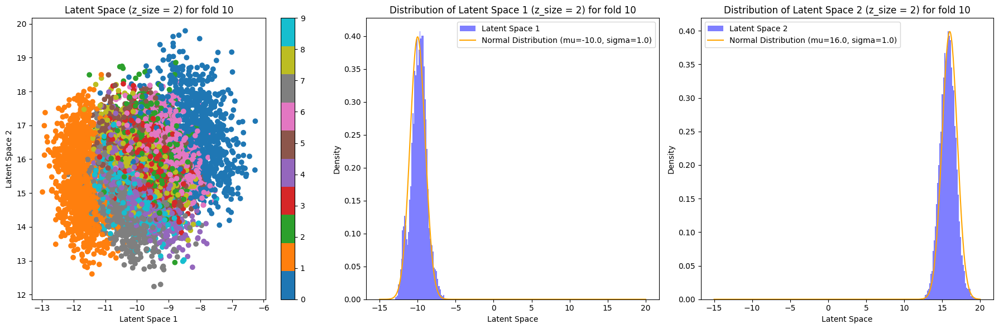

In [ ]:
x = np.linspace(-15, 20, 1000)
set_2_mean = torch.tensor([[-10,16]], dtype=torch.float32)


std_2 = torch.ones((1, 2), dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_7[6], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

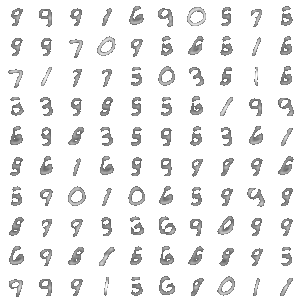

In [ ]:
set_2_mean = torch.tensor([[-10,16]], dtype=torch.float32)


std_2 = torch.ones((1, 2), dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_7[6], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

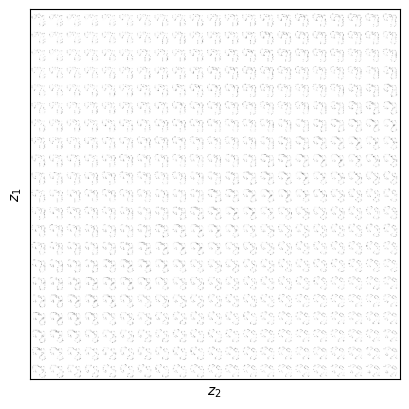

In [ ]:
VAE_visualize_latent_space(models_3_7[1], device)

### Experiment 3.3 : AE with 2 layer

- Model: VAE of 2 layer, D_x=784, D_z=32, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_8 = 'VAE'
model_config_3_8 = {'D_x': 784, 'n_layers': 1, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'gaussian'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
#set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
#set_2_mean = torch.tensor([-10,16], dtype=torch.float32)
set_2_mean = torch.randn([1, 2], dtype=torch.float32)
#set_2_mean = torch.tensor([-5,-1], dtype=torch.float32)

#std_2 = torch.ones((1, 2), dtype=torch.float32)
#std_2 = torch.tensor([10,20], dtype=torch.float32)
std_2 = torch.randn([1, 2], dtype=torch.float32)
models_3_8, fold_results_3_8 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_8),
                                                model_config=model_config_3_8,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=10,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })

Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:112.033235, Training Recons Loss: 106.886692, Training KLD Loss: 0.514654
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.08474399894475937, 'L1 Loss': 0.23769208043813705, 'BCE': 0.3511993799437868}, Validation VAE Loss: {'MSE': 66.8124920053685, 'L1 Loss': 66.68228961051778, 'BCE': 66.78261387601812}, Validation Recons Loss: {'MSE': 66.43929513971857, 'L1 Loss': 66.30909266370408, 'BCE': 66.40941696978629}, Validation KLD Loss: {'MSE': 0.3731968662840255, 'L1 Loss': 0.3731968662840255, 'BCE': 0.3731968662840255}
Train Fold/Epoch: 1/2, Training Loss:63.169282, Training Recons Loss: 60.561327, Training KLD Loss: 0.260796
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.07275849279571087, 'L1 Loss': 0.1966131202718045, 'BCE': 0.3065824610121707}, Validation VAE Loss: {'MSE': 57.2022491

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_8.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_8.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_8, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_8, f)


## Visualizing reconstructions for all fold

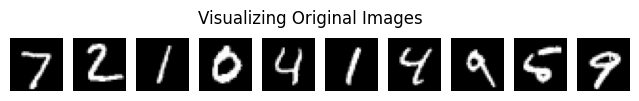

Visualizing reconstructions for fold 1


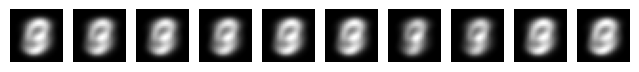

Visualizing reconstructions for fold 2


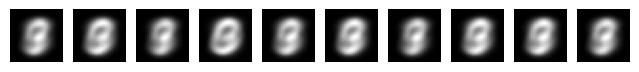

Visualizing reconstructions for fold 3


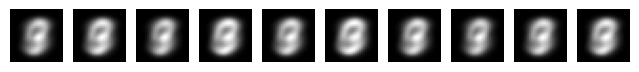

Visualizing reconstructions for fold 4


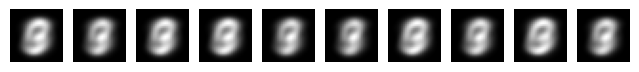

Visualizing reconstructions for fold 5


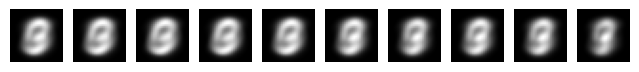

Visualizing reconstructions for fold 6


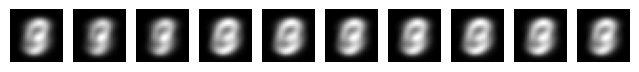

Visualizing reconstructions for fold 7


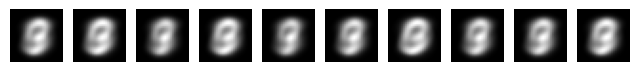

Visualizing reconstructions for fold 8


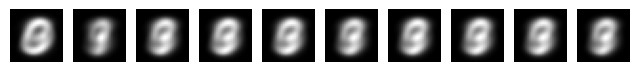

Visualizing reconstructions for fold 9


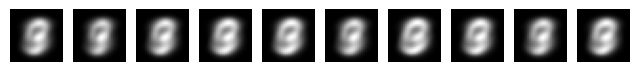

Visualizing reconstructions for fold 10


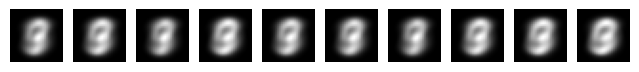

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_8.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_8 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_8):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

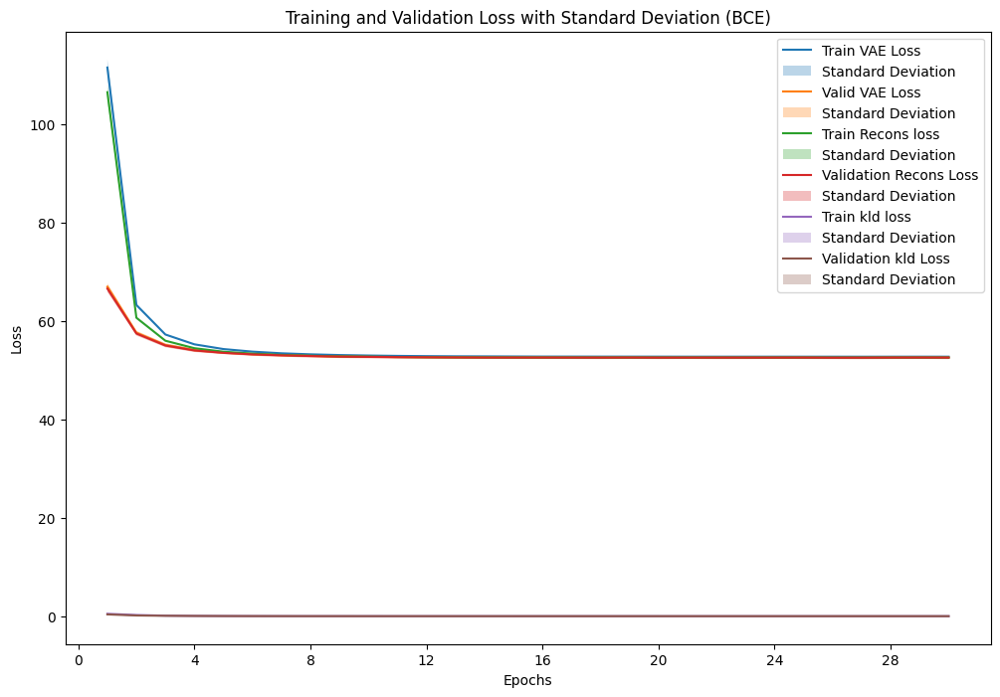

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_8.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_8 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_8_1 = VAE_plot_results(fold_results_3_8, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_8_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_8_1['epochs'])
    VAE_plot_mean_std(result_data_3_8_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_8_1['epochs'])
    VAE_plot_mean_std(result_data_3_8_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_8_1['epochs'])
    VAE_plot_mean_std(result_data_3_8_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_8_1['epochs'])
    VAE_plot_mean_std(result_data_3_8_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_8_1['epochs'])
    VAE_plot_mean_std(result_data_3_8_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_8_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_8_1['valid_metrics'],
    result_data_3_8_1['test_metrics'],
    result_data_3_8_1['valid_result'],
    result_data_3_8_1['test_result'],
    result_data_3_8_1['recons_valid_result'],
    result_data_3_8_1['recons_test_result'],
    result_data_3_8_1['kld_valid_result'],
    result_data_3_8_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.262330           0.261913            52.586795      52.737657               52.567315         52.567315              0.01948       0.020170
Standard Deviation                 0.001132           0.000072             0.305298       0.018887                0.304661          0.304661              0.00129       0.001233

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.261456,0.261989,52.319265,52.756872
1,2,0.261915,0.261930,52.461766,52.744991
2,3,0.263460,0.261787,52.909002,52.713201
3,4,0.262045,0.261818,52.511609,52.710781
4,5,0.261436,0.262035,52.277563,52.773241
5,6,0.263226,0.261921,52.771596,52.747781
6,7,0.262461,0.261852,52.689539,52.716990
7,8,0.264816,0.261931,53.254032,52.734593
8,9,0.261667,0.261941,52.448268,52.741779
9,10,0.260821,0.261926,52.225314,52.736337


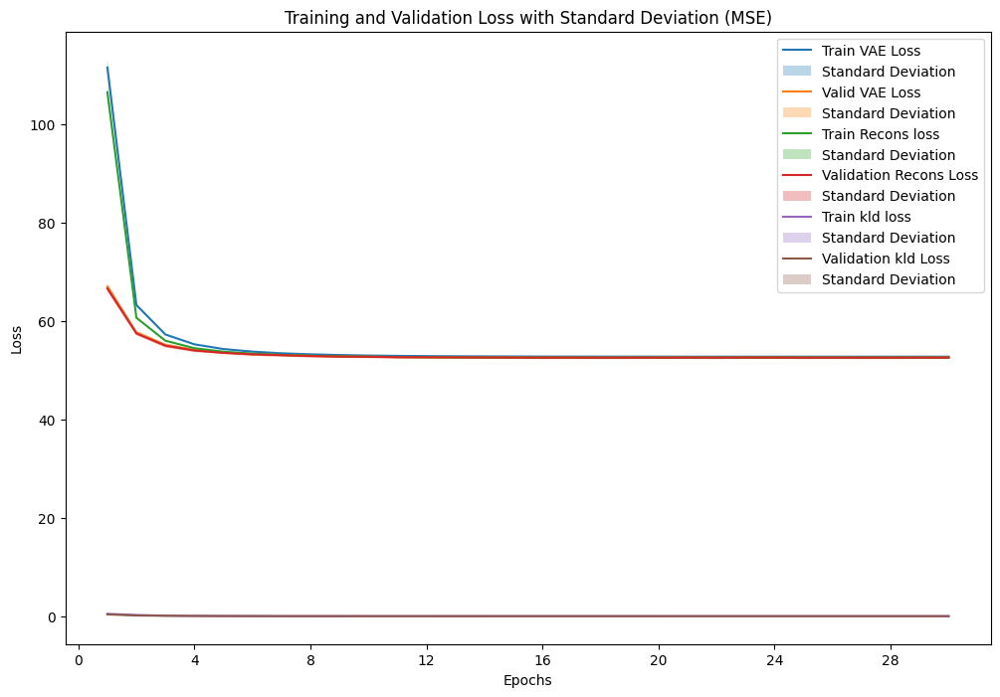

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_8.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_8 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_8_2 = VAE_plot_results(fold_results_3_8, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_8_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_8_2['epochs'])
    VAE_plot_mean_std(result_data_3_8_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_8_2['epochs'])
    VAE_plot_mean_std(result_data_3_8_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_8_2['epochs'])
    VAE_plot_mean_std(result_data_3_8_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_8_2['epochs'])
    VAE_plot_mean_std(result_data_3_8_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_8_2['epochs'])
    VAE_plot_mean_std(result_data_3_8_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_8_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_8_2['valid_metrics'],
    result_data_3_8_2['test_metrics'],
    result_data_3_8_2['valid_result'],
    result_data_3_8_2['test_result'],
    result_data_3_8_2['recons_valid_result'],
    result_data_3_8_2['recons_test_result'],
    result_data_3_8_2['kld_valid_result'],
    result_data_3_8_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.067027           0.067260            52.569026      52.751936               52.549546         52.549546              0.01948       0.020170
Standard Deviation                 0.000362           0.000033             0.284688       0.025976                0.284064          0.284064              0.00129       0.001233

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.066687,0.067222,52.303400,52.723575
1,2,0.066900,0.067265,52.469794,52.756792
2,3,0.067427,0.067225,52.884663,52.725938
3,4,0.066922,0.067292,52.486380,52.777484
4,5,0.066664,0.067325,52.282100,52.801006
5,6,0.067234,0.067273,52.730692,52.762110
6,7,0.067136,0.067277,52.655590,52.766319
7,8,0.067826,0.067249,53.194811,52.742834
8,9,0.066839,0.067264,52.420276,52.753642
9,10,0.066639,0.067208,52.262557,52.709663


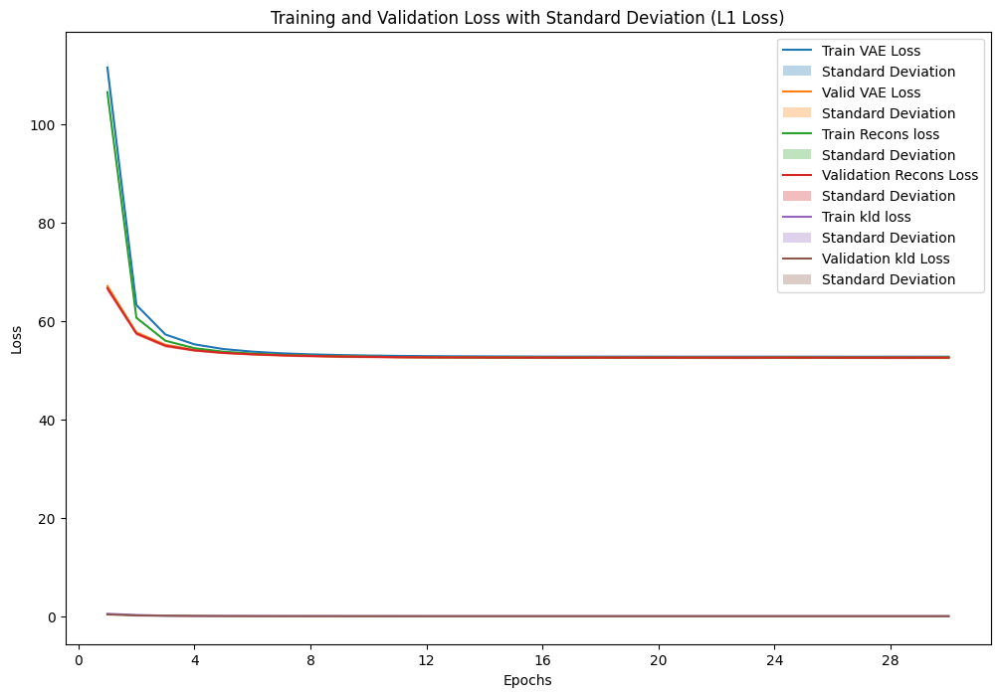

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_8.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_8 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_8_3 = VAE_plot_results(fold_results_3_8, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_8_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_8_3['epochs'])
    VAE_plot_mean_std(result_data_3_8_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_8_3['epochs'])
    VAE_plot_mean_std(result_data_3_8_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_8_3['epochs'])
    VAE_plot_mean_std(result_data_3_8_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_8_3['epochs'])
    VAE_plot_mean_std(result_data_3_8_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_8_3['epochs'])
    VAE_plot_mean_std(result_data_3_8_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_8_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_8_3['valid_metrics'],
    result_data_3_8_3['test_metrics'],
    result_data_3_8_3['valid_result'],
    result_data_3_8_3['test_result'],
    result_data_3_8_3['recons_valid_result'],
    result_data_3_8_3['recons_test_result'],
    result_data_3_8_3['kld_valid_result'],
    result_data_3_8_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.149626           0.149848            52.569369      52.742156               52.549889         52.549889              0.01948       0.020170
Standard Deviation                 0.000324           0.000133             0.275760       0.024748                0.275139          0.275139              0.00129       0.001233

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.149354,0.149894,52.298342,52.719928
1,2,0.149449,0.149876,52.468692,52.724481
2,3,0.149898,0.149565,52.887976,52.731686
3,4,0.149468,0.149850,52.479924,52.742639
4,5,0.149188,0.149859,52.290853,52.771129
5,6,0.149883,0.149945,52.731856,52.760231
6,7,0.149697,0.149759,52.659405,52.699311
7,8,0.150349,0.149706,53.164138,52.754158
8,9,0.149582,0.150043,52.429266,52.786340
9,10,0.149392,0.149981,52.283235,52.731660


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_8 = sum(p.numel() for p in models_3_8[0].parameters())
print(f"Number of parameters in the model: {total_params_3_8}")

Number of parameters in the model: 5492


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


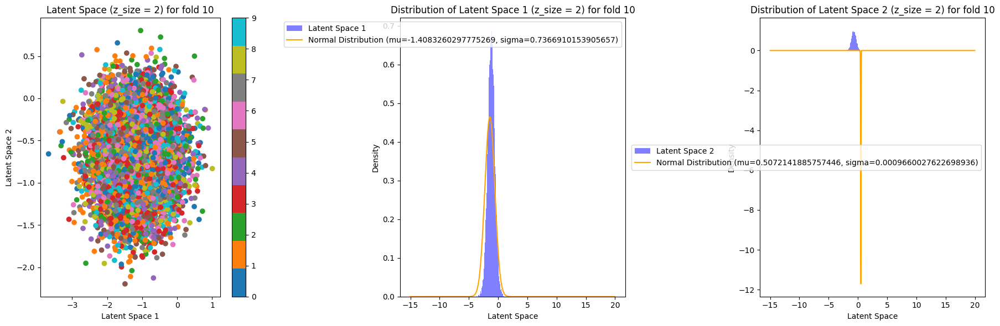

In [ ]:
x = np.linspace(-15, 20, 1000)
set_2_mean = torch.randn([1, 2], dtype=torch.float32)

std_2 = torch.randn([1, 2], dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_8[9], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

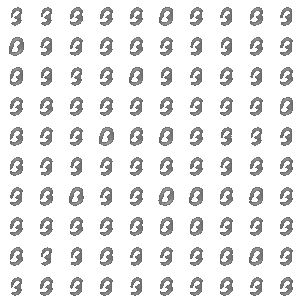

In [ ]:
set_2_mean = torch.randn([1, 2], dtype=torch.float32)

std_2 = torch.randn([1, 2], dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_8[9], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

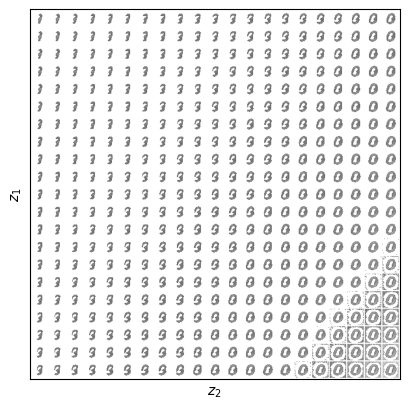

In [ ]:
VAE_visualize_latent_space(models_3_8[1], device)

### Experiment 3.3 : AE with 2 layer

- Model: VAE of 2 layer, D_x=784, D_z=32, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_9 = 'VAE'
model_config_3_9 = {'D_x': 784, 'n_layers': 2, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
#set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
#set_2_mean = torch.tensor([-10,16], dtype=torch.float32)
set_2_mean = torch.randn([1, 2], dtype=torch.float32)
#set_2_mean = torch.tensor([-5,-1], dtype=torch.float32)

#std_2 = torch.ones((1, 2), dtype=torch.float32)
#std_2 = torch.tensor([10,20], dtype=torch.float32)
std_2 = torch.randn([1, 2], dtype=torch.float32)
models_3_9, fold_results_3_9 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_9),
                                                model_config=model_config_3_9,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=10,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })

Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:207.519358, Training Recons Loss: 197.074988, Training KLD Loss: 1.044437
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.05896108874932249, 'L1 Loss': 0.1353846344541996, 'BCE': 0.23777474764179676}, Validation VAE Loss: {'MSE': 187.38996822276013, 'L1 Loss': 187.46220430414726, 'BCE': 187.52748042979138}, Validation Recons Loss: {'MSE': 186.27788965752785, 'L1 Loss': 186.35012573891498, 'BCE': 186.4154018645591}, Validation KLD Loss: {'MSE': 1.1120787890667612, 'L1 Loss': 1.1120787890667612, 'BCE': 1.1120787890667612}
Train Fold/Epoch: 1/2, Training Loss:195.301822, Training Recons Loss: 180.965909, Training KLD Loss: 1.433591
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.05528396169872994, 'L1 Loss': 0.1263777547060175, 'BCE': 0.22564931372378735}, Validation VAE Loss: {'MSE': 1

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_9.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_9.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_9, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_9, f)


## Visualizing reconstructions for all fold

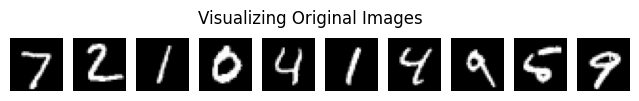

Visualizing reconstructions for fold 1


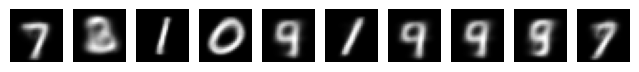

Visualizing reconstructions for fold 2


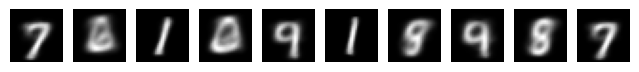

Visualizing reconstructions for fold 3


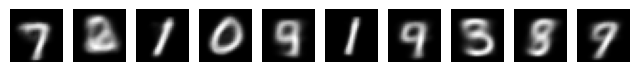

Visualizing reconstructions for fold 4


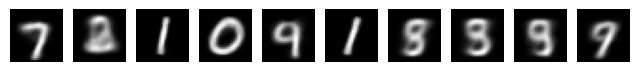

Visualizing reconstructions for fold 5


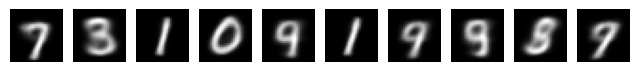

Visualizing reconstructions for fold 6


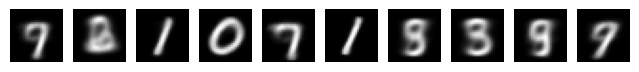

Visualizing reconstructions for fold 7


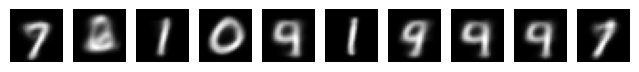

Visualizing reconstructions for fold 8


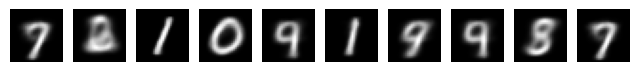

Visualizing reconstructions for fold 9


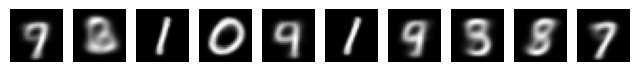

Visualizing reconstructions for fold 10


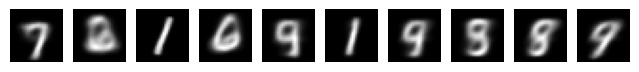

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_9.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_9 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_9):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

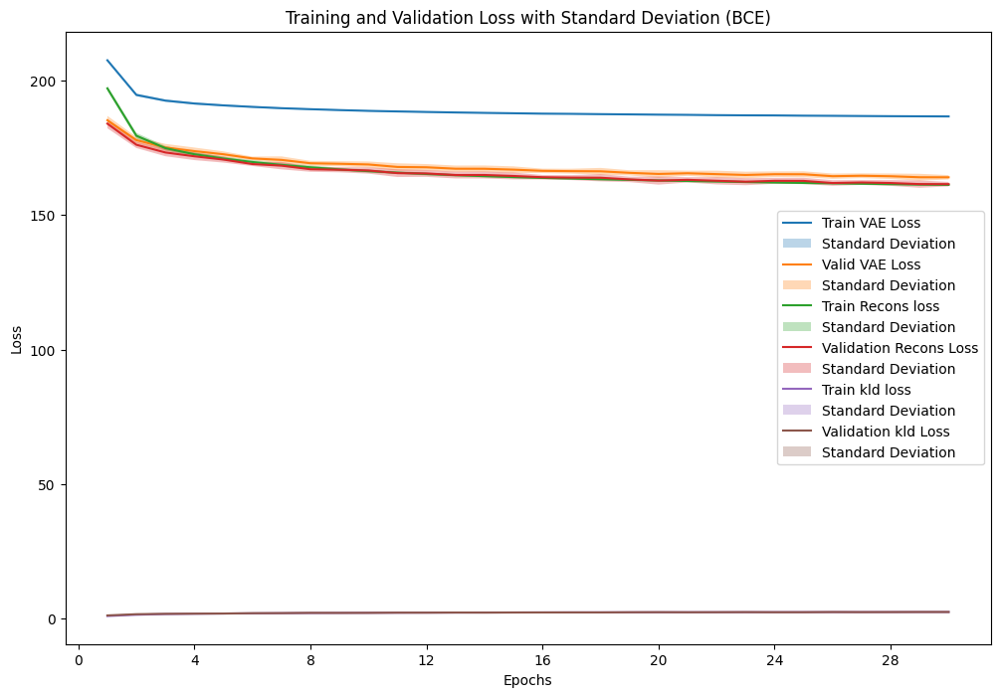

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_9.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_9 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_9_1 = VAE_plot_results(fold_results_3_9, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_9_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_9_1['epochs'])
    VAE_plot_mean_std(result_data_3_9_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_9_1['epochs'])
    VAE_plot_mean_std(result_data_3_9_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_9_1['epochs'])
    VAE_plot_mean_std(result_data_3_9_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_9_1['epochs'])
    VAE_plot_mean_std(result_data_3_9_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_9_1['epochs'])
    VAE_plot_mean_std(result_data_3_9_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_9_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_9_1['valid_metrics'],
    result_data_3_9_1['test_metrics'],
    result_data_3_9_1['valid_result'],
    result_data_3_9_1['test_result'],
    result_data_3_9_1['recons_valid_result'],
    result_data_3_9_1['recons_test_result'],
    result_data_3_9_1['kld_valid_result'],
    result_data_3_9_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.205991           0.205607           164.046322     163.732828              161.497321        161.497321             2.549001       2.536700
Standard Deviation                 0.001061           0.000560             0.815869       0.418101                0.832010          0.832010             0.041105       0.041684

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.205747,0.205052,163.898339,163.351585
1,2,0.206437,0.206204,164.432590,164.248077
2,3,0.207717,0.206516,165.378099,164.413448
3,4,0.205020,0.205017,163.306567,163.288541
4,5,0.205383,0.204838,163.552306,163.132196
5,6,0.206014,0.205316,164.118860,163.547933
6,7,0.204766,0.205314,163.116384,163.518318
7,8,0.208028,0.206077,165.576283,164.030150
8,9,0.205828,0.206165,163.858674,164.113525
9,10,0.204974,0.205574,163.225123,163.684509


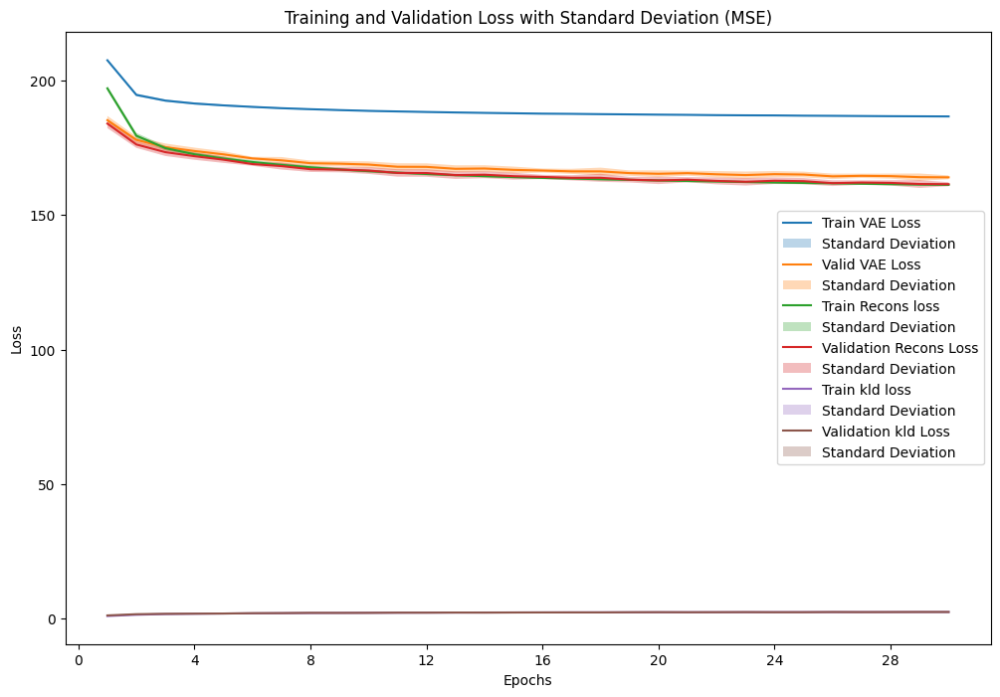

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_9.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_9 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_9_2 = VAE_plot_results(fold_results_3_9, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_9_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_9_2['epochs'])
    VAE_plot_mean_std(result_data_3_9_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_9_2['epochs'])
    VAE_plot_mean_std(result_data_3_9_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_9_2['epochs'])
    VAE_plot_mean_std(result_data_3_9_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_9_2['epochs'])
    VAE_plot_mean_std(result_data_3_9_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_9_2['epochs'])
    VAE_plot_mean_std(result_data_3_9_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_9_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_9_2['valid_metrics'],
    result_data_3_9_2['test_metrics'],
    result_data_3_9_2['valid_result'],
    result_data_3_9_2['test_result'],
    result_data_3_9_2['recons_valid_result'],
    result_data_3_9_2['recons_test_result'],
    result_data_3_9_2['kld_valid_result'],
    result_data_3_9_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.048804           0.048843           164.017441     163.791553              161.468439        161.468439             2.549001       2.536700
Standard Deviation                 0.000340           0.000181             0.768015       0.423969                0.786541          0.786541             0.041105       0.041684

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.048689,0.048815,163.908523,163.712344
1,2,0.048768,0.048889,164.361690,164.240103
2,3,0.049351,0.049146,165.248865,164.557728
3,4,0.048280,0.048645,162.939355,163.311508
4,5,0.048801,0.048558,163.825823,163.189456
5,6,0.048699,0.048732,163.885514,163.477617
6,7,0.048603,0.048752,163.517222,163.673375
7,8,0.049350,0.049069,165.211693,164.142056
8,9,0.049077,0.049040,164.369529,164.100855
9,10,0.048423,0.048784,162.906192,163.510491


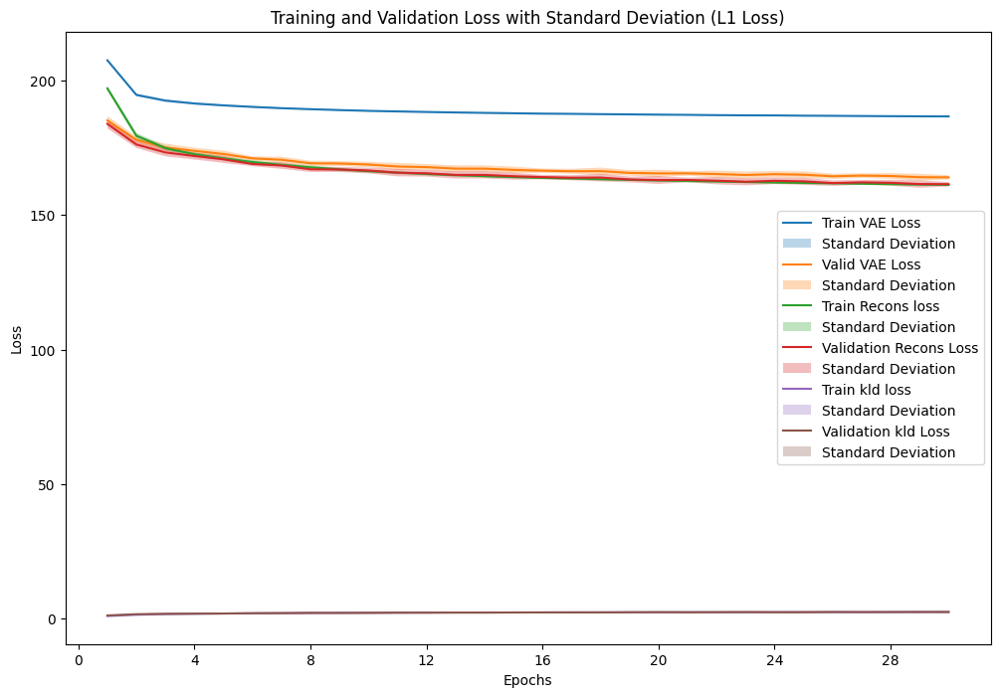

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_9.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_9 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_9_3 = VAE_plot_results(fold_results_3_9, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_9_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_9_3['epochs'])
    VAE_plot_mean_std(result_data_3_9_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_9_3['epochs'])
    VAE_plot_mean_std(result_data_3_9_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_9_3['epochs'])
    VAE_plot_mean_std(result_data_3_9_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_9_3['epochs'])
    VAE_plot_mean_std(result_data_3_9_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_9_3['epochs'])
    VAE_plot_mean_std(result_data_3_9_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_9_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_9_3['valid_metrics'],
    result_data_3_9_3['test_metrics'],
    result_data_3_9_3['valid_result'],
    result_data_3_9_3['test_result'],
    result_data_3_9_3['recons_valid_result'],
    result_data_3_9_3['recons_test_result'],
    result_data_3_9_3['kld_valid_result'],
    result_data_3_9_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.112513           0.112601           164.053419     163.702636              161.504418        161.504418             2.549001       2.536700
Standard Deviation                 0.000730           0.000591             0.857828       0.441707                0.873170          0.873170             0.041105       0.041684

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.111896,0.111822,164.292915,163.393214
1,2,0.112464,0.112661,164.541344,164.218504
2,3,0.114326,0.114015,165.373503,164.234950
3,4,0.112009,0.112150,163.096124,163.130177
4,5,0.112769,0.112523,163.674039,163.267886
5,6,0.112249,0.112304,163.765711,163.280633
6,7,0.111673,0.112075,163.306574,163.466017
7,8,0.113186,0.112496,165.569775,163.995640
8,9,0.112312,0.112924,164.009021,164.385843
9,10,0.112242,0.113040,162.905186,163.653492


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_9 = sum(p.numel() for p in models_3_9[0].parameters())
print(f"Number of parameters in the model: {total_params_3_9}")

Number of parameters in the model: 620156


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


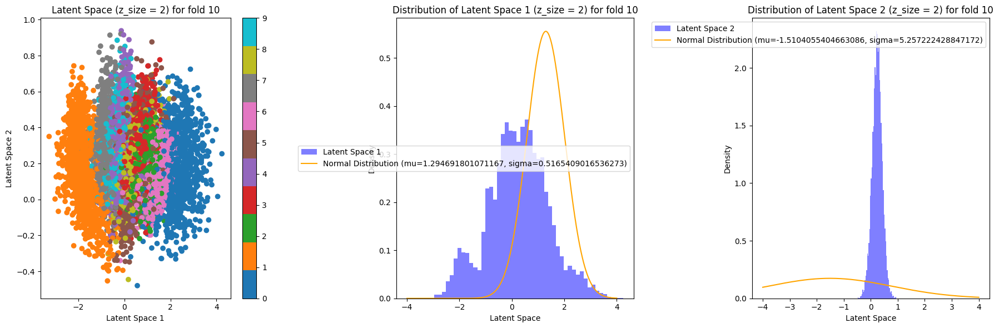

In [ ]:
x = np.linspace(-4, 4, 1000)
set_2_mean = torch.randn([1, 2], dtype=torch.float32)

std_2 = torch.randn([1, 2], dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_9[6], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

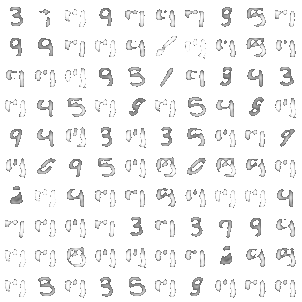

In [ ]:
set_2_mean = torch.randn([1, 2], dtype=torch.float32)

std_2 = torch.randn([1, 2], dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_9[6], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

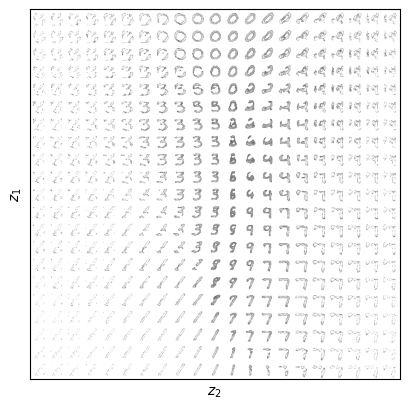

In [ ]:
VAE_visualize_latent_space(models_3_9[1], device)

### Experiment 3.1 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=2, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_10 = 'VAE'
model_config_3_10 = {'D_x': 784, 'n_layers': 1, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
#set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
set_2_mean = torch.tensor([1,1], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)
#std_2 = torch.tensor([0.5,0.2], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_3_10, fold_results_3_10 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_10),
                                                model_config=model_config_3_10,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=1,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })


Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:326.955908, Training Recons Loss: 308.210325, Training KLD Loss: 18.745584
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.06798738122303435, 'L1 Loss': 0.16703257265877217, 'BCE': 0.2760210536578868}, Validation VAE Loss: {'MSE': 237.46026091879986, 'L1 Loss': 237.24371824873253, 'BCE': 237.51682151632107}, Validation Recons Loss: {'MSE': 216.34394625399975, 'L1 Loss': 216.1274034216049, 'BCE': 216.40050685152093}, Validation KLD Loss: {'MSE': 21.11631462421823, 'L1 Loss': 21.11631462421823, 'BCE': 21.11631462421823}
Train Fold/Epoch: 1/2, Training Loss:227.267741, Training Recons Loss: 208.796881, Training KLD Loss: 18.470860
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.0629188642302092, 'L1 Loss': 0.15117778042529492, 'BCE': 0.25688172591493486}, Validation VAE Loss: {'MSE': 21

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_10.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_10.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_10, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_10, f)


## Visualizing reconstructions for all fold

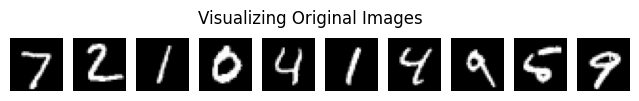

Visualizing reconstructions for fold 1


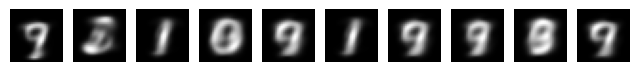

Visualizing reconstructions for fold 2


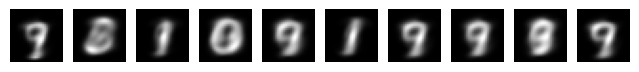

Visualizing reconstructions for fold 3


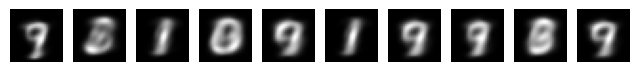

Visualizing reconstructions for fold 4


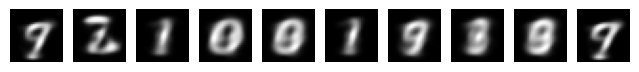

Visualizing reconstructions for fold 5


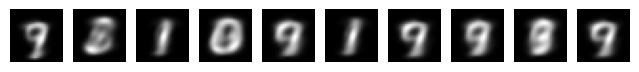

Visualizing reconstructions for fold 6


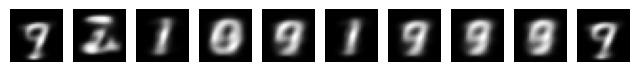

Visualizing reconstructions for fold 7


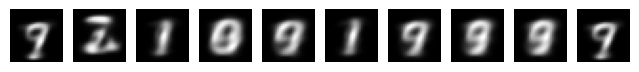

Visualizing reconstructions for fold 8


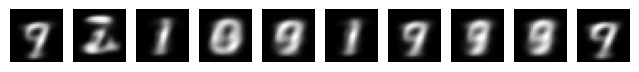

Visualizing reconstructions for fold 9


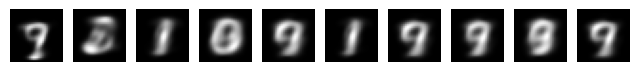

Visualizing reconstructions for fold 10


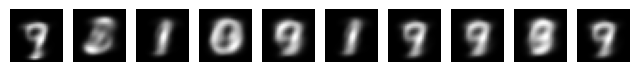

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_10.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_10 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_10):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

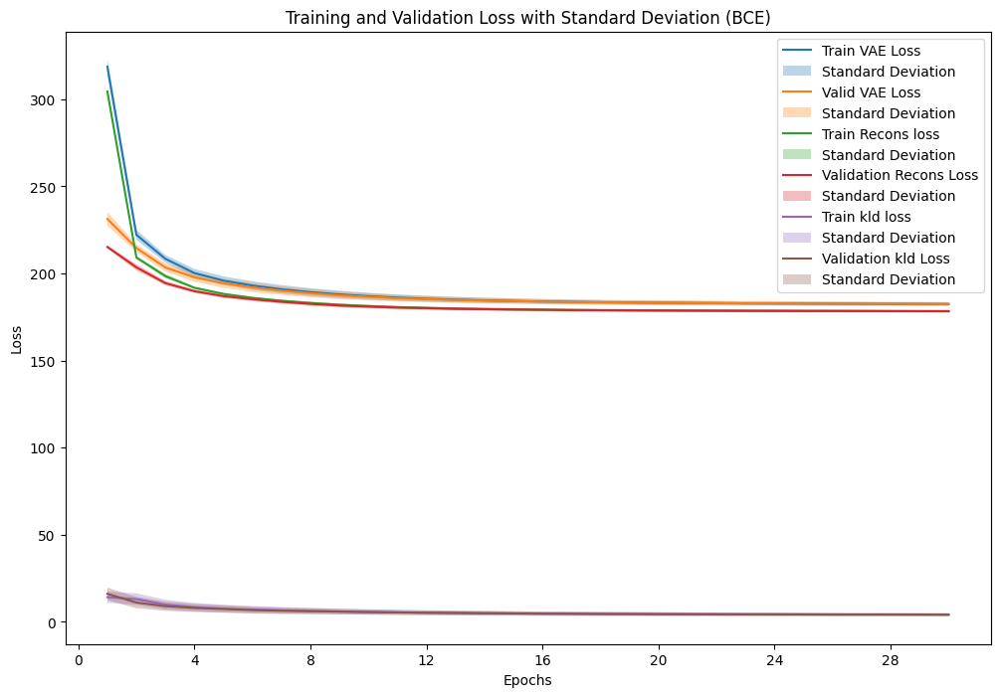

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_10.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_10 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_10_1 = VAE_plot_results(fold_results_3_10, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_10_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_10_1['epochs'])
    VAE_plot_mean_std(result_data_3_10_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_10_1['epochs'])
    VAE_plot_mean_std(result_data_3_10_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_10_1['epochs'])
    VAE_plot_mean_std(result_data_3_10_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_10_1['epochs'])
    VAE_plot_mean_std(result_data_3_10_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_10_1['epochs'])
    VAE_plot_mean_std(result_data_3_10_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_10_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_10_1['valid_metrics'],
    result_data_3_10_1['test_metrics'],
    result_data_3_10_1['valid_result'],
    result_data_3_10_1['test_result'],
    result_data_3_10_1['recons_valid_result'],
    result_data_3_10_1['recons_test_result'],
    result_data_3_10_1['kld_valid_result'],
    result_data_3_10_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.227441           0.226279           182.447064     181.559853              178.313404        178.313404             4.133660       4.156815
Standard Deviation                 0.001013           0.000261             1.206108       0.803955                0.793984          0.793984             0.817119       0.817112

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.226818,0.226176,183.651579,183.173368
1,2,0.226942,0.226339,181.668213,181.201023
2,3,0.227865,0.226124,182.412815,181.069477
3,4,0.228295,0.227009,182.563400,181.587165
4,5,0.227090,0.226082,181.835352,181.085330
5,6,0.228648,0.226253,184.960223,183.103464
6,7,0.227837,0.226335,182.322418,181.175085
7,8,0.229015,0.226058,183.318184,181.009343
8,9,0.226081,0.226132,180.993957,181.059655
9,10,0.225814,0.226286,180.744500,181.134618


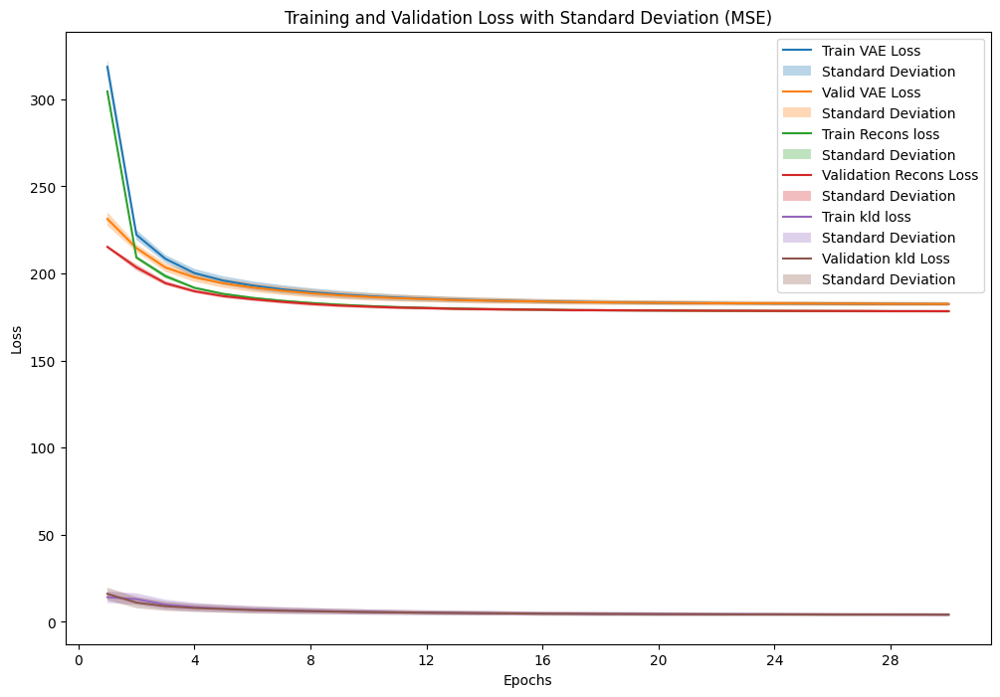

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_10.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_10 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_10_2 = VAE_plot_results(fold_results_3_10, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_10_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_10_2['epochs'])
    VAE_plot_mean_std(result_data_3_10_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_10_2['epochs'])
    VAE_plot_mean_std(result_data_3_10_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_10_2['epochs'])
    VAE_plot_mean_std(result_data_3_10_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_10_2['epochs'])
    VAE_plot_mean_std(result_data_3_10_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_10_2['epochs'])
    VAE_plot_mean_std(result_data_3_10_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_10_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_10_2['valid_metrics'],
    result_data_3_10_2['test_metrics'],
    result_data_3_10_2['valid_result'],
    result_data_3_10_2['test_result'],
    result_data_3_10_2['recons_valid_result'],
    result_data_3_10_2['recons_test_result'],
    result_data_3_10_2['kld_valid_result'],
    result_data_3_10_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.056007           0.055758           182.466652     181.570408              178.332992        178.332992             4.133660       4.156815
Standard Deviation                 0.000278           0.000077             1.195533       0.798974                0.787034          0.787034             0.817119       0.817112

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.055717,0.055698,183.663327,183.140397
1,2,0.055917,0.055812,181.695481,181.204881
2,3,0.056234,0.055763,182.460712,181.125468
3,4,0.056140,0.055934,182.523614,181.632805
4,5,0.055910,0.055700,181.845778,181.115771
5,6,0.056210,0.055693,184.947406,183.130764
6,7,0.056154,0.055735,182.382613,181.163015
7,8,0.056518,0.055703,183.348287,181.013576
8,9,0.055645,0.055703,181.018084,181.059268
9,10,0.055622,0.055841,180.781224,181.118130


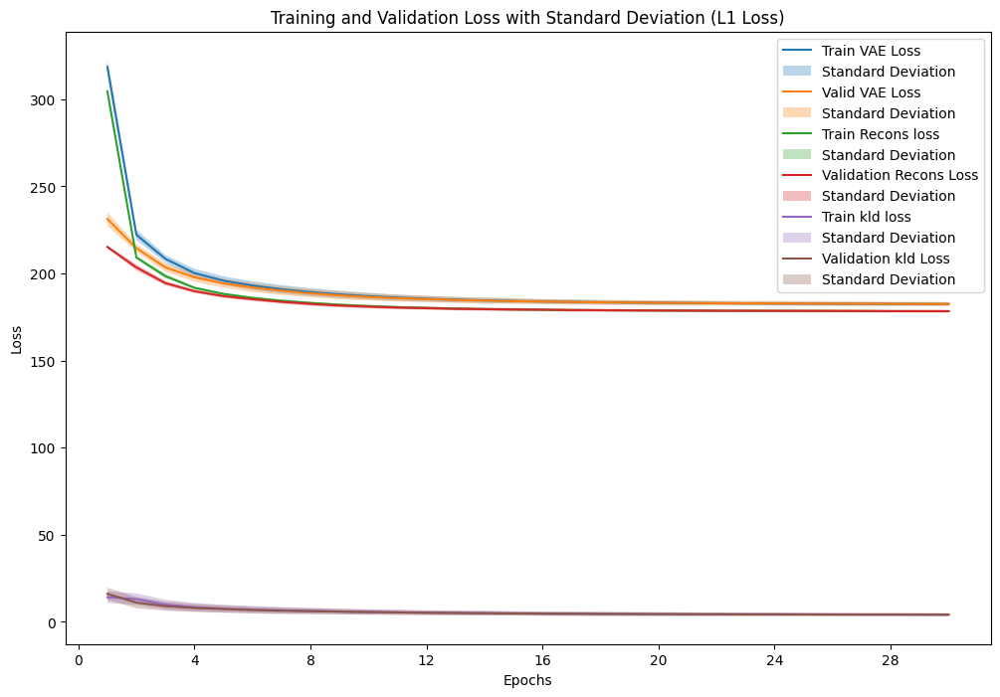

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_10.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_10 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_10_3 = VAE_plot_results(fold_results_3_10, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_10_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_10_3['epochs'])
    VAE_plot_mean_std(result_data_3_10_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_10_3['epochs'])
    VAE_plot_mean_std(result_data_3_10_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_10_3['epochs'])
    VAE_plot_mean_std(result_data_3_10_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_10_3['epochs'])
    VAE_plot_mean_std(result_data_3_10_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_10_3['epochs'])
    VAE_plot_mean_std(result_data_3_10_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_10_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_10_3['valid_metrics'],
    result_data_3_10_3['test_metrics'],
    result_data_3_10_3['valid_result'],
    result_data_3_10_3['test_result'],
    result_data_3_10_3['recons_valid_result'],
    result_data_3_10_3['recons_test_result'],
    result_data_3_10_3['kld_valid_result'],
    result_data_3_10_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.126892           0.126684           182.455085     181.577973              178.321425        178.321425             4.133660       4.156815
Standard Deviation                 0.000642           0.000444             1.191857       0.804101                0.776484          0.776484             0.817119       0.817112

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.126866,0.126944,183.663539,183.185230
1,2,0.126681,0.126722,181.714097,181.203340
2,3,0.126815,0.126293,182.362997,181.098430
3,4,0.127468,0.127424,182.513824,181.670135
4,5,0.126420,0.126196,181.811114,181.096777
5,6,0.127697,0.127048,184.945643,183.113618
6,7,0.127192,0.126821,182.370405,181.160177
7,8,0.127637,0.126553,183.342610,181.062647
8,9,0.126738,0.126989,181.006302,181.036744
9,10,0.125409,0.125847,180.820320,181.152634


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_10 = sum(p.numel() for p in models_3_10[0].parameters())
print(f"Number of parameters in the model: {total_params_3_10}")

Number of parameters in the model: 5492


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


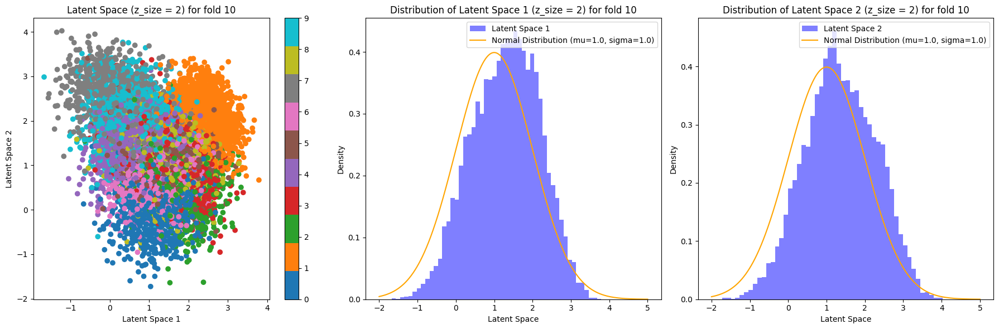

In [ ]:
x = np.linspace(-2, 5, 1000)
set_2_mean = torch.tensor([[1,1]], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_10[9], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

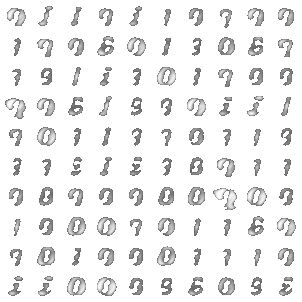

In [ ]:
set_2_mean = torch.tensor([1,1], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_10[9], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

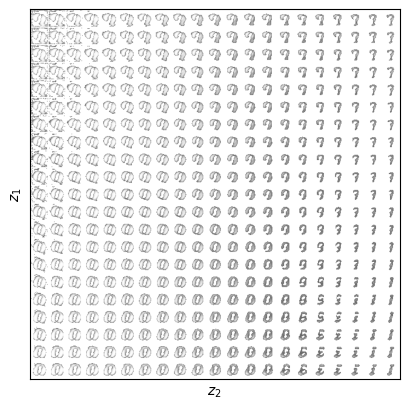

In [ ]:
VAE_visualize_latent_space(models_3_10[1], device)

### Experiment 3.1 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=2, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_10_2 = 'VAE'
model_config_3_10_2 = {'D_x': 784, 'n_layers': 2, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
#set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
set_2_mean = torch.tensor([1,1], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)
#std_2 = torch.tensor([0.5,0.2], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_3_10_2, fold_results_3_10_2 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_10_2),
                                                model_config=model_config_3_10_2,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=1,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })


Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:183.169969, Training Recons Loss: 178.553126, Training KLD Loss: 4.616843
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.0506188571849402, 'L1 Loss': 0.11626360343491778, 'BCE': 0.2112348143090593}, Validation VAE Loss: {'MSE': 170.41573398671252, 'L1 Loss': 170.4157594721368, 'BCE': 170.47282701857546}, Validation Recons Loss: {'MSE': 165.55100185313123, 'L1 Loss': 165.5510273385555, 'BCE': 165.60809456033908}, Validation KLD Loss: {'MSE': 4.864732138654019, 'L1 Loss': 4.864732138654019, 'BCE': 4.864732138654019}
Train Fold/Epoch: 1/2, Training Loss:166.679214, Training Recons Loss: 161.591843, Training KLD Loss: 5.087372
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.04815094656449683, 'L1 Loss': 0.11110236733517748, 'BCE': 0.20367312891052125}, Validation VAE Loss: {'MSE': 164.9

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_10_2.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_10_2.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_10_2, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_10_2, f)


## Visualizing reconstructions for all fold

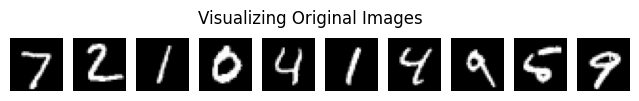

Visualizing reconstructions for fold 1


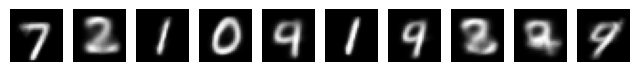

Visualizing reconstructions for fold 2


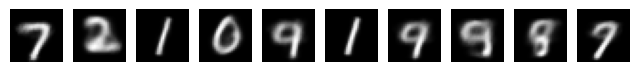

Visualizing reconstructions for fold 3


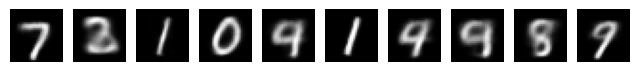

Visualizing reconstructions for fold 4


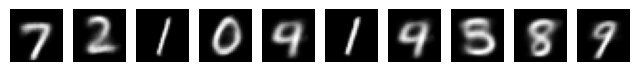

Visualizing reconstructions for fold 5


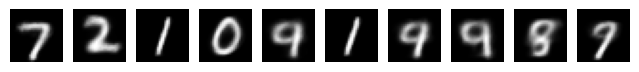

Visualizing reconstructions for fold 6


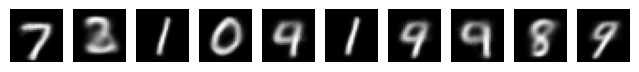

Visualizing reconstructions for fold 7


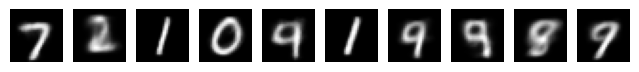

Visualizing reconstructions for fold 8


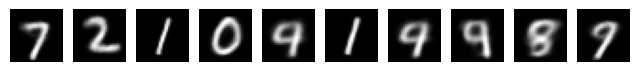

Visualizing reconstructions for fold 9


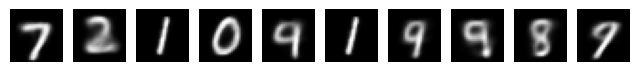

Visualizing reconstructions for fold 10


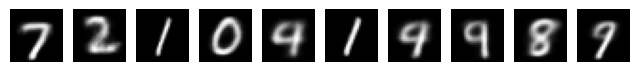

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_10_2.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_10_2 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_10_2):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

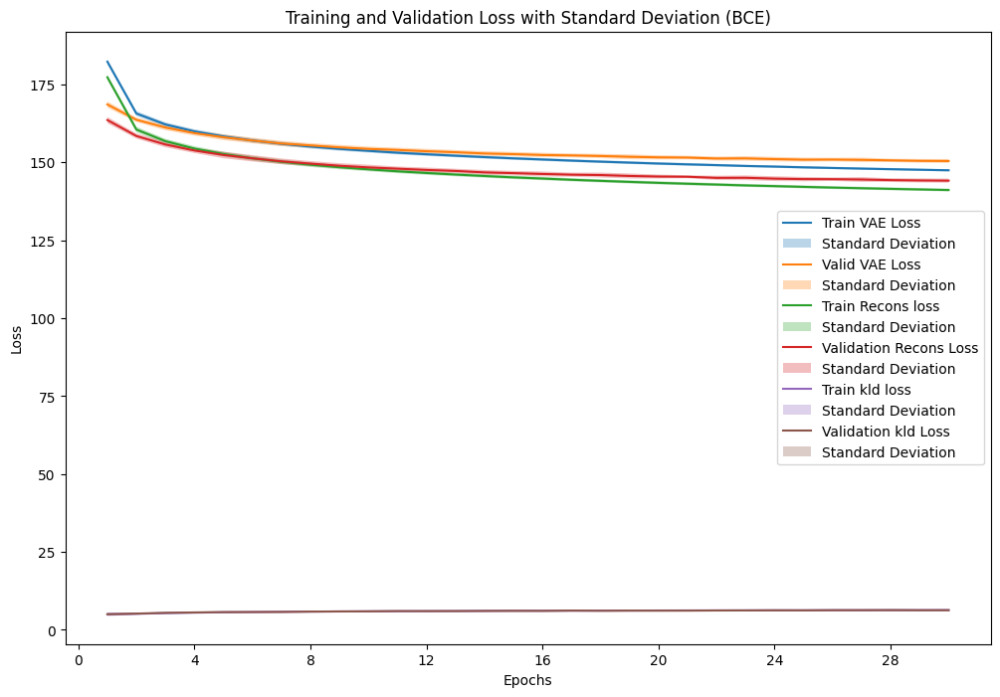

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_10_2.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_10_2 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_10_2_1 = VAE_plot_results(fold_results_3_10_2, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_10_2_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_10_2_1['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_10_2_1['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_10_2_1['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_10_2_1['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_10_2_1['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_10_2_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_10_2_1['valid_metrics'],
    result_data_3_10_2_1['test_metrics'],
    result_data_3_10_2_1['valid_result'],
    result_data_3_10_2_1['test_result'],
    result_data_3_10_2_1['recons_valid_result'],
    result_data_3_10_2_1['recons_test_result'],
    result_data_3_10_2_1['kld_valid_result'],
    result_data_3_10_2_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.183853           0.183547           150.436009     150.186216              144.140454        144.140454             6.295555       6.285115
Standard Deviation                 0.000876           0.000531             0.657923       0.321381                0.687112          0.687112             0.136230       0.134871

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.184904,0.183539,151.226559,150.174454
1,2,0.183062,0.183163,149.765300,149.853799
2,3,0.184520,0.183508,150.814465,149.996897
3,4,0.182961,0.183581,149.802841,150.309143
4,5,0.183000,0.183198,149.836730,149.983218
5,6,0.183983,0.183251,150.716214,150.135270
6,7,0.182632,0.182911,149.684434,149.874855
7,8,0.185327,0.183260,151.667278,149.997409
8,9,0.184393,0.184392,150.732009,150.677375
9,10,0.183744,0.184670,150.114261,150.859737


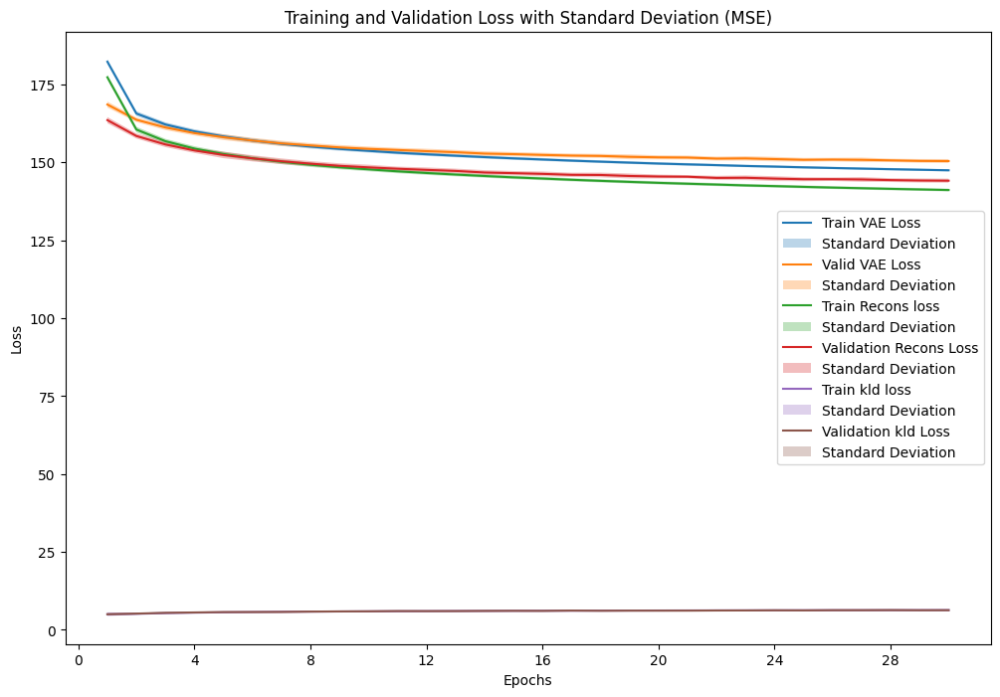

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_10_2.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_10_2 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_10_2_2 = VAE_plot_results(fold_results_3_10_2, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_10_2_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_10_2_2['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_10_2_2['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_10_2_2['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_10_2_2['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_10_2_2['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_10_2_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_10_2_2['valid_metrics'],
    result_data_3_10_2_2['test_metrics'],
    result_data_3_10_2_2['valid_result'],
    result_data_3_10_2_2['test_result'],
    result_data_3_10_2_2['recons_valid_result'],
    result_data_3_10_2_2['recons_test_result'],
    result_data_3_10_2_2['kld_valid_result'],
    result_data_3_10_2_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.041124           0.041120           150.437254     150.200687              144.141699        144.141699             6.295555       6.285115
Standard Deviation                 0.000309           0.000262             0.669782       0.354030                0.697137          0.697137             0.136230       0.134871

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.041297,0.041057,151.187572,150.206156
1,2,0.040880,0.040943,149.776795,149.845354
2,3,0.041285,0.041033,150.791696,149.939415
3,4,0.040931,0.041255,149.746721,150.291508
4,5,0.040927,0.041087,149.839578,149.946040
5,6,0.041013,0.040950,150.769174,150.173816
6,7,0.040588,0.040704,149.681522,149.903351
7,8,0.041745,0.041203,151.681400,150.012256
8,9,0.041181,0.041209,150.834869,150.717741
9,10,0.041394,0.041760,150.063210,150.971232


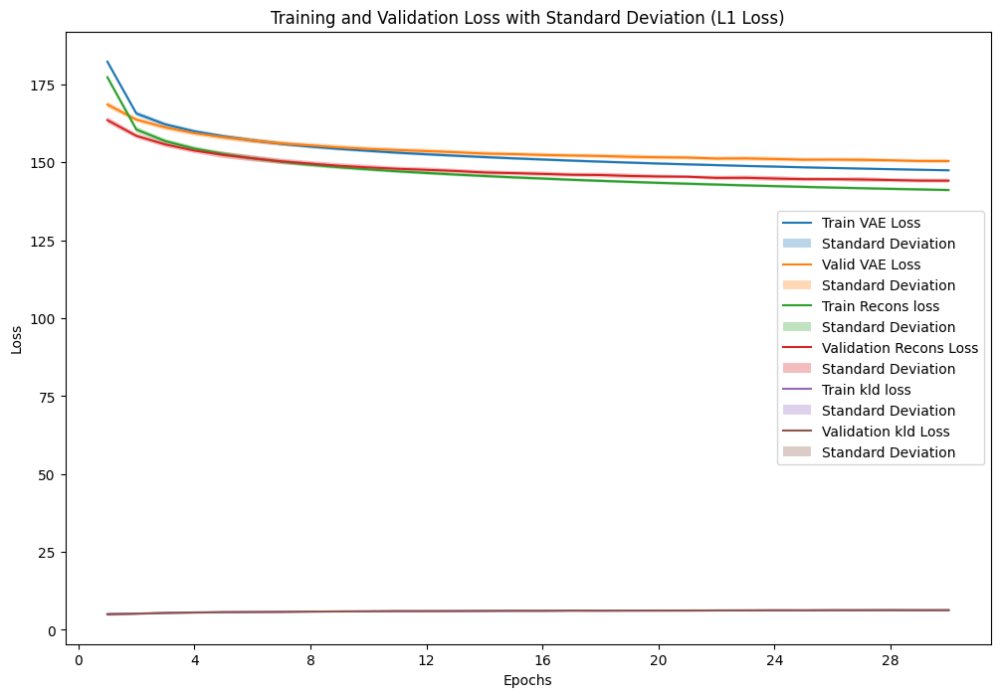

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_10_2.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_10_2 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_10_2_3 = VAE_plot_results(fold_results_3_10_2, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_10_2_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_10_2_3['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_10_2_3['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_10_2_3['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_10_2_3['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_10_2_3['epochs'])
    VAE_plot_mean_std(result_data_3_10_2_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_10_2_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_10_2_3['valid_metrics'],
    result_data_3_10_2_3['test_metrics'],
    result_data_3_10_2_3['valid_result'],
    result_data_3_10_2_3['test_result'],
    result_data_3_10_2_3['recons_valid_result'],
    result_data_3_10_2_3['recons_test_result'],
    result_data_3_10_2_3['kld_valid_result'],
    result_data_3_10_2_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.096626           0.096671           150.431959     150.196483              144.136404        144.136404             6.295555       6.285115
Standard Deviation                 0.000434           0.000346             0.645783       0.335747                0.672292          0.672292             0.136230       0.134871

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.096755,0.096577,151.164657,150.158362
1,2,0.096752,0.096797,149.770440,149.842482
2,3,0.097089,0.096942,150.716412,150.042498
3,4,0.096735,0.096979,149.866074,150.281930
4,5,0.095946,0.096282,149.798837,149.976251
5,6,0.096655,0.096467,150.843315,150.139098
6,7,0.095752,0.096158,149.649089,149.862058
7,8,0.097179,0.096372,151.611560,150.039856
8,9,0.096496,0.096798,150.781068,150.697833
9,10,0.096904,0.097337,150.118143,150.924464


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_10_2 = sum(p.numel() for p in models_3_10_2[0].parameters())
print(f"Number of parameters in the model: {total_params_3_10_2}")

Number of parameters in the model: 620156


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


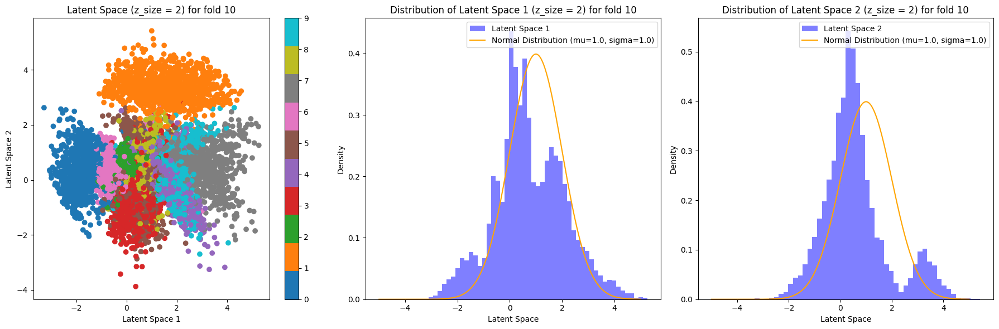

In [ ]:
x = np.linspace(-5, 5, 1000)
set_2_mean = torch.tensor([[1,1]], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_10_2[6], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

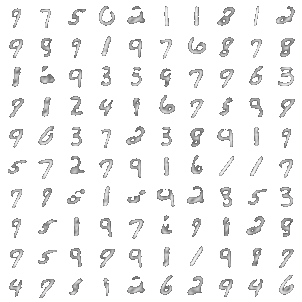

In [ ]:
set_2_mean = torch.tensor([[1,1]], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_10_2[6], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

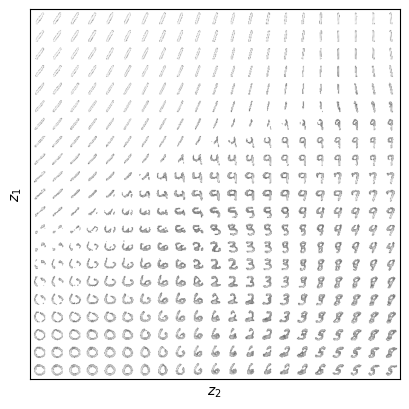

In [ ]:
VAE_visualize_latent_space(models_3_10_2[1], device)

### Experiment 3.1 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=2, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_11 = 'VAE'
model_config_3_11 = {'D_x': 784, 'n_layers': 2, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
#set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
set_2_mean = torch.tensor([15,15], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)
#std_2 = torch.tensor([0.5,0.2], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_3_11, fold_results_3_11 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_11),
                                                model_config=model_config_3_11,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=1,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })


Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:203.428603, Training Recons Loss: 189.058385, Training KLD Loss: 14.370218
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.05513131234081502, 'L1 Loss': 0.12618620130927005, 'BCE': 0.22711792667495442}, Validation VAE Loss: {'MSE': 186.04202254275057, 'L1 Loss': 185.98192953556142, 'BCE': 185.96016011339552}, Validation Recons Loss: {'MSE': 178.14231758929313, 'L1 Loss': 178.08222441977642, 'BCE': 178.06045515993807}, Validation KLD Loss: {'MSE': 7.899705699149599, 'L1 Loss': 7.899705699149599, 'BCE': 7.899705699149599}
Train Fold/Epoch: 1/2, Training Loss:183.094700, Training Recons Loss: 176.652188, Training KLD Loss: 6.442513
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.05352387585221453, 'L1 Loss': 0.12416725478907849, 'BCE': 0.22192115479327262}, Validation VAE Loss: {'MSE': 

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_11.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_11.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_11, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_11, f)


## Visualizing reconstructions for all fold

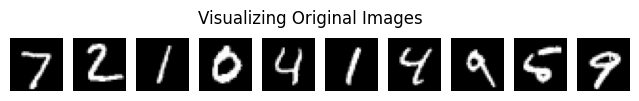

Visualizing reconstructions for fold 1


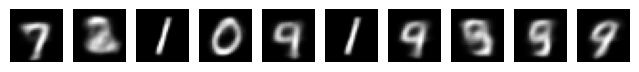

Visualizing reconstructions for fold 2


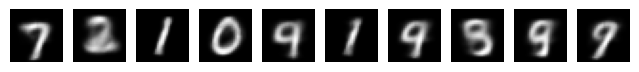

Visualizing reconstructions for fold 3


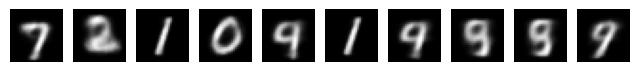

Visualizing reconstructions for fold 4


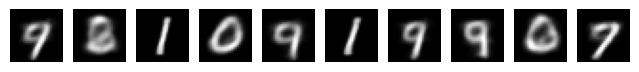

Visualizing reconstructions for fold 5


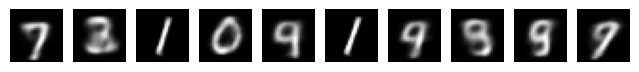

Visualizing reconstructions for fold 6


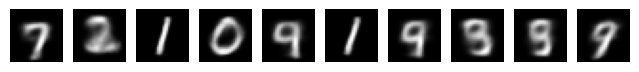

Visualizing reconstructions for fold 7


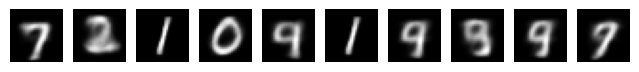

Visualizing reconstructions for fold 8


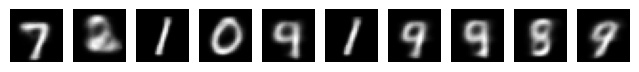

Visualizing reconstructions for fold 9


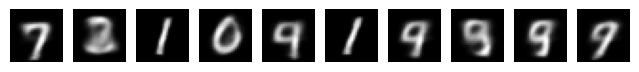

Visualizing reconstructions for fold 10


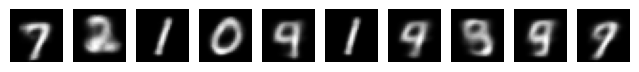

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_11.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_11 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_11):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

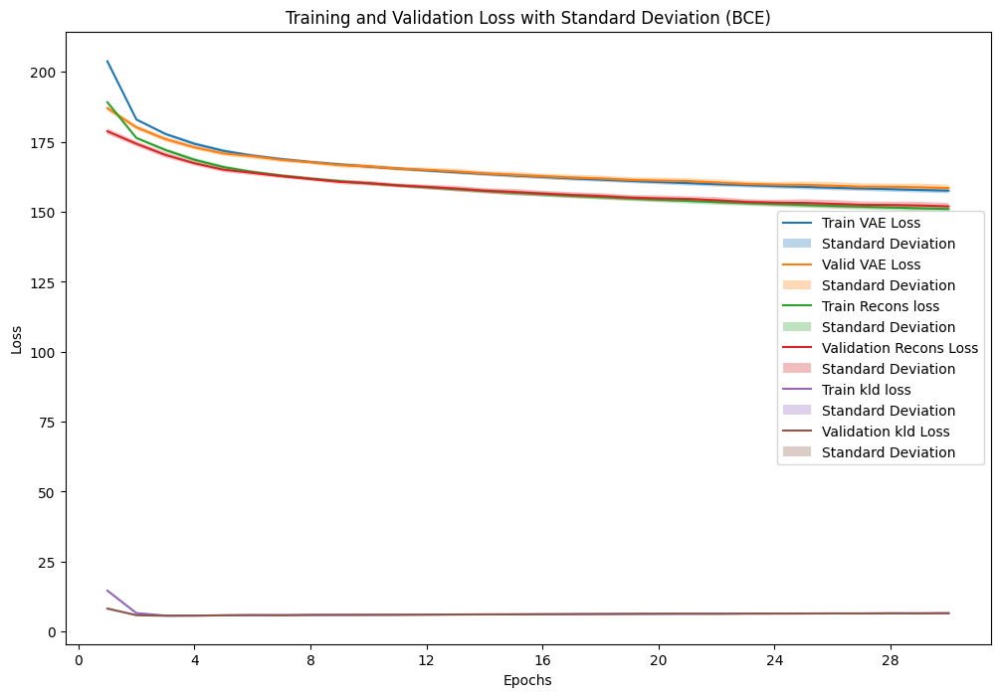

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_11.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_11 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_11_1 = VAE_plot_results(fold_results_3_11, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_11_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_11_1['epochs'])
    VAE_plot_mean_std(result_data_3_11_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_11_1['epochs'])
    VAE_plot_mean_std(result_data_3_11_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_11_1['epochs'])
    VAE_plot_mean_std(result_data_3_11_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_11_1['epochs'])
    VAE_plot_mean_std(result_data_3_11_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_11_1['epochs'])
    VAE_plot_mean_std(result_data_3_11_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_11_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_11_1['valid_metrics'],
    result_data_3_11_1['test_metrics'],
    result_data_3_11_1['valid_result'],
    result_data_3_11_1['test_result'],
    result_data_3_11_1['recons_valid_result'],
    result_data_3_11_1['recons_test_result'],
    result_data_3_11_1['kld_valid_result'],
    result_data_3_11_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.193816           0.193199           158.523453     157.968871              151.951481        151.951481             6.571973       6.501219
Standard Deviation                 0.001571           0.001512             1.164315       1.121181                1.231376          1.231376             0.137696       0.119978

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.195810,0.194836,159.855216,159.041572
1,2,0.191760,0.191301,156.893041,156.502442
2,3,0.193855,0.192690,158.604146,157.550753
3,4,0.196657,0.196870,160.516082,160.678795
4,5,0.193618,0.193398,158.580349,158.347657
5,6,0.194575,0.193226,159.214514,158.048918
6,7,0.193144,0.192717,158.076046,157.645595
7,8,0.194584,0.192092,159.106732,157.065367
8,9,0.192661,0.192153,157.738433,157.259679
9,10,0.191493,0.192701,156.649973,157.547935


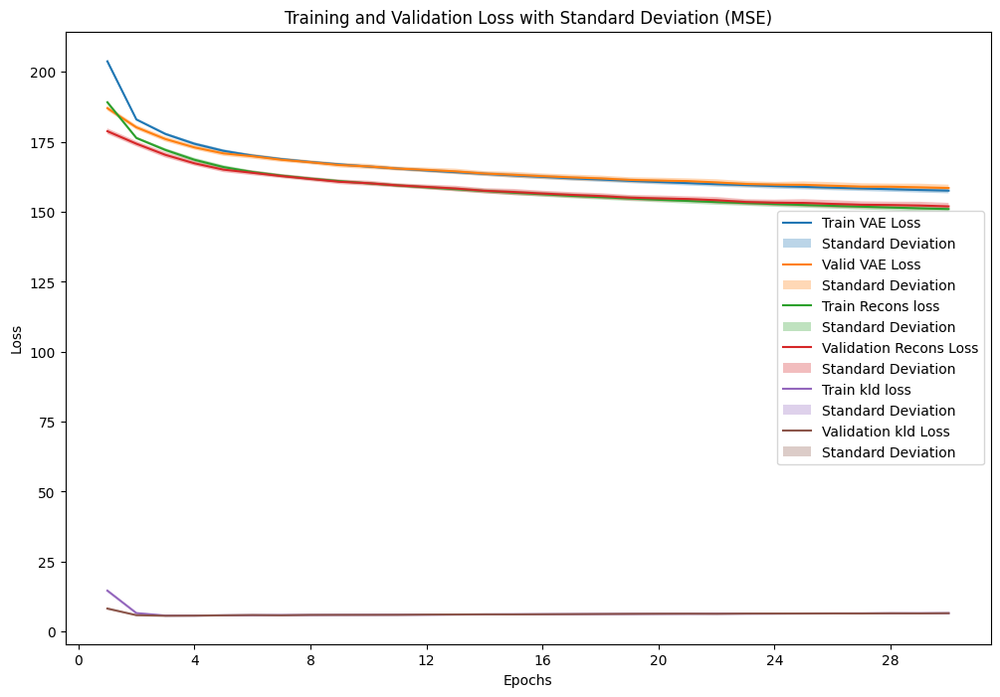

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_11.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_11 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_11_2 = VAE_plot_results(fold_results_3_11, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_11_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_11_2['epochs'])
    VAE_plot_mean_std(result_data_3_11_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_11_2['epochs'])
    VAE_plot_mean_std(result_data_3_11_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_11_2['epochs'])
    VAE_plot_mean_std(result_data_3_11_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_11_2['epochs'])
    VAE_plot_mean_std(result_data_3_11_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_11_2['epochs'])
    VAE_plot_mean_std(result_data_3_11_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_11_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_11_2['valid_metrics'],
    result_data_3_11_2['test_metrics'],
    result_data_3_11_2['valid_result'],
    result_data_3_11_2['test_result'],
    result_data_3_11_2['recons_valid_result'],
    result_data_3_11_2['recons_test_result'],
    result_data_3_11_2['kld_valid_result'],
    result_data_3_11_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.044664           0.044566           158.526853     157.956925               151.95488         151.95488             6.571973       6.501219
Standard Deviation                 0.000554           0.000562             1.206424       1.113040                 1.27396           1.27396             0.137696       0.119978

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.045394,0.045181,159.929928,158.951937
1,2,0.043882,0.043811,156.825931,156.457949
2,3,0.044747,0.044431,158.663393,157.531790
3,4,0.045719,0.045925,160.595062,160.690944
4,5,0.044527,0.044570,158.557160,158.289837
5,6,0.044842,0.044566,159.104058,158.032479
6,7,0.044508,0.044409,158.145215,157.668402
7,8,0.044804,0.044216,159.147341,157.179865
8,9,0.044326,0.044157,157.759207,157.253297
9,10,0.043889,0.044392,156.541236,157.512747


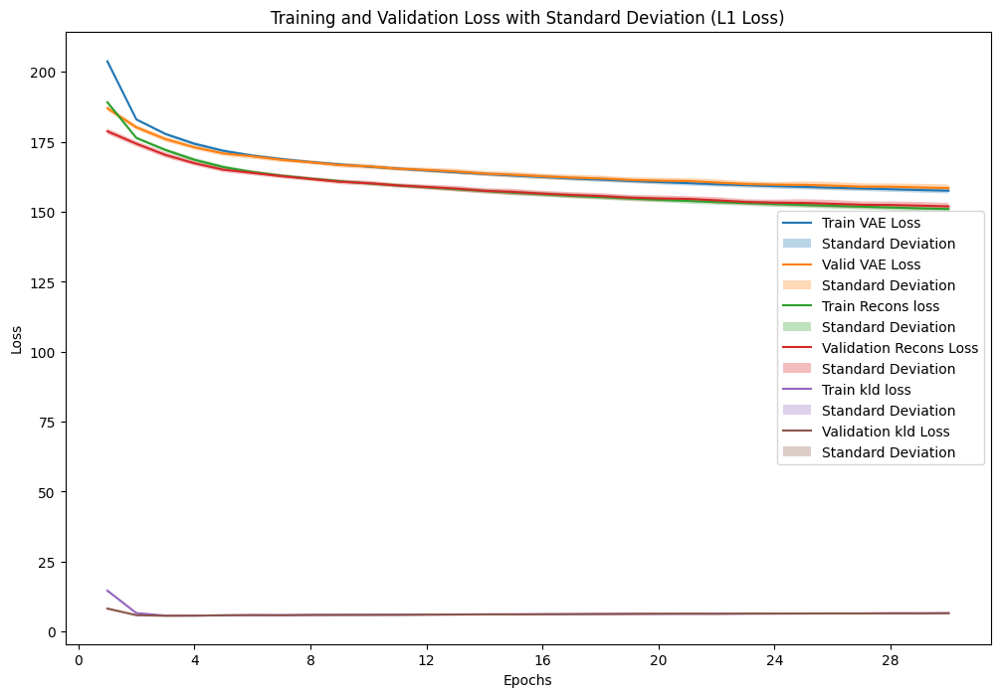

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_11.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_11 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_11_3 = VAE_plot_results(fold_results_3_11, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_11_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_11_3['epochs'])
    VAE_plot_mean_std(result_data_3_11_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_11_3['epochs'])
    VAE_plot_mean_std(result_data_3_11_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_11_3['epochs'])
    VAE_plot_mean_std(result_data_3_11_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_11_3['epochs'])
    VAE_plot_mean_std(result_data_3_11_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_11_3['epochs'])
    VAE_plot_mean_std(result_data_3_11_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_11_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_11_3['valid_metrics'],
    result_data_3_11_3['test_metrics'],
    result_data_3_11_3['valid_result'],
    result_data_3_11_3['test_result'],
    result_data_3_11_3['recons_valid_result'],
    result_data_3_11_3['recons_test_result'],
    result_data_3_11_3['kld_valid_result'],
    result_data_3_11_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.104397           0.104502           158.511694     157.981990              151.939721        151.939721             6.571973       6.501219
Standard Deviation                 0.000792           0.000809             1.192364       1.114781                1.256713          1.256713             0.137696       0.119978

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.105167,0.105358,159.814238,159.052039
1,2,0.103713,0.103881,156.775323,156.466299
2,3,0.103954,0.103734,158.711839,157.544071
3,4,0.105966,0.106266,160.547795,160.677473
4,5,0.104819,0.104983,158.599880,158.317368
5,6,0.104873,0.104743,159.048490,158.063588
6,7,0.104377,0.104510,158.152683,157.678041
7,8,0.104240,0.103517,159.156724,157.156559
8,9,0.103780,0.104019,157.786547,157.309152
9,10,0.103080,0.104014,156.523419,157.555307


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_11 = sum(p.numel() for p in models_3_11[0].parameters())
print(f"Number of parameters in the model: {total_params_3_11}")

Number of parameters in the model: 620156


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


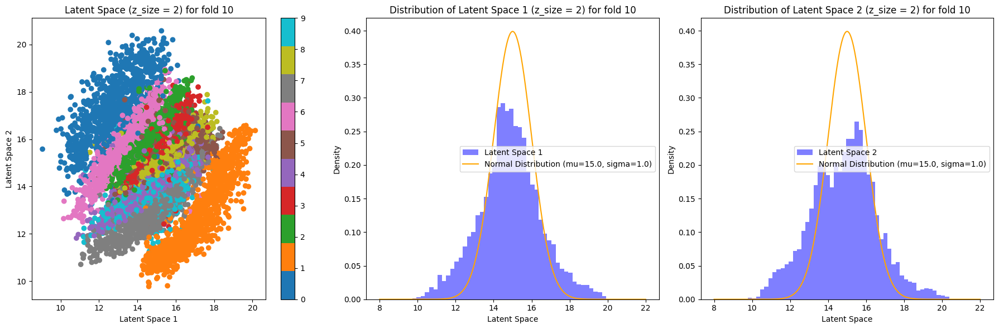

In [ ]:
x = np.linspace(8, 22, 1000)
set_2_mean = torch.tensor([[15,15]], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_11[9], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

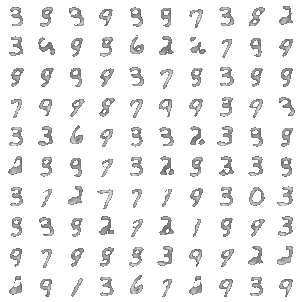

In [ ]:
set_2_mean = torch.tensor([[15,15]], dtype=torch.float32)

std_2 = torch.ones((1, 2), dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_11[9], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

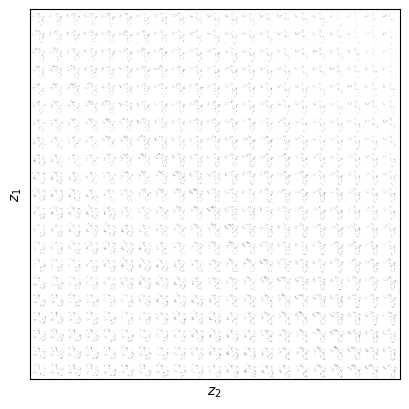

In [ ]:
VAE_visualize_latent_space(models_3_11[1], device)

### Experiment 3.1 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=2, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_12 = 'VAE'
model_config_3_12 = {'D_x': 784, 'n_layers': 2, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
#set_2_mean = torch.tensor([5,10], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)

#std_2 = torch.ones((1, 2), dtype=torch.float32)
std_2 = torch.tensor([4,4], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_3_12, fold_results_3_12 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_12),
                                                model_config=model_config_3_12,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=1,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })


Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:181.806796, Training Recons Loss: 177.119700, Training KLD Loss: 4.687096
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.048813646897039514, 'L1 Loss': 0.1133050320947424, 'BCE': 0.20745006948709488}, Validation VAE Loss: {'MSE': 167.85019375415558, 'L1 Loss': 167.95753673796958, 'BCE': 167.87162650899685}, Validation Recons Loss: {'MSE': 162.61942128932222, 'L1 Loss': 162.7267642731362, 'BCE': 162.6408540441635}, Validation KLD Loss: {'MSE': 5.230772332942232, 'L1 Loss': 5.230772332942232, 'BCE': 5.230772332942232}
Train Fold/Epoch: 1/2, Training Loss:165.248306, Training Recons Loss: 159.920048, Training KLD Loss: 5.328258
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.04706859398395457, 'L1 Loss': 0.10917706422983332, 'BCE': 0.2015013651961976}, Validation VAE Loss: {'MSE': 163.

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_12.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_12.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_12, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_12, f)


## Visualizing reconstructions for all fold

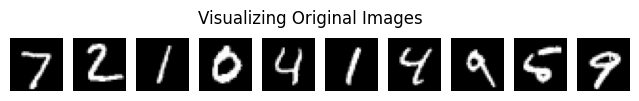

Visualizing reconstructions for fold 1


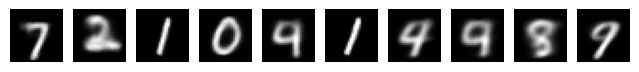

Visualizing reconstructions for fold 2


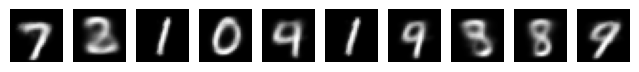

Visualizing reconstructions for fold 3


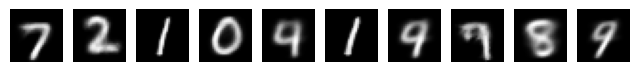

Visualizing reconstructions for fold 4


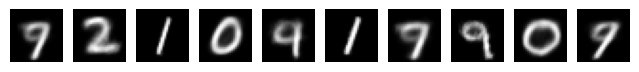

Visualizing reconstructions for fold 5


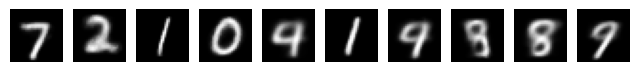

Visualizing reconstructions for fold 6


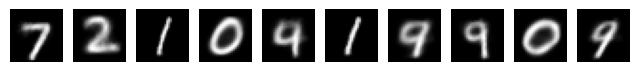

Visualizing reconstructions for fold 7


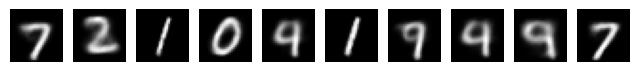

Visualizing reconstructions for fold 8


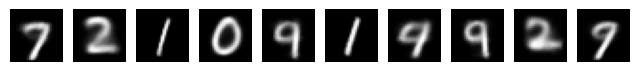

Visualizing reconstructions for fold 9


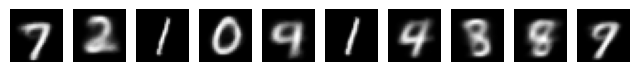

Visualizing reconstructions for fold 10


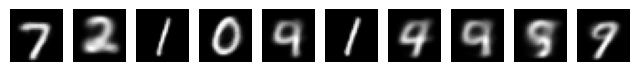

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_12.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_12 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_12):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

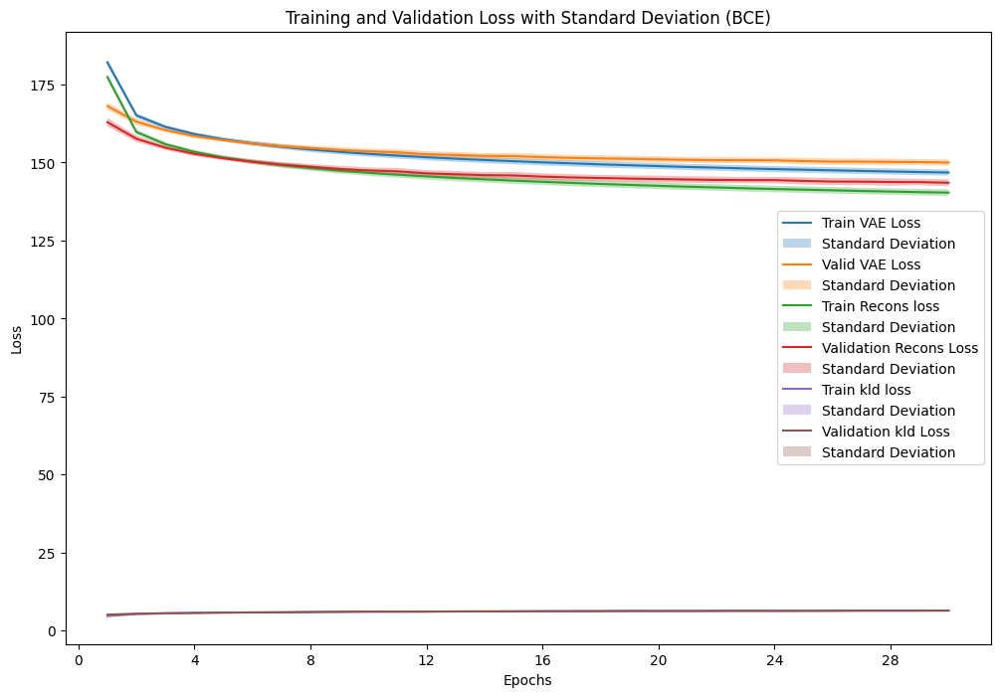

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_12.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_12 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_12_1 = VAE_plot_results(fold_results_3_12, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_12_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_12_1['epochs'])
    VAE_plot_mean_std(result_data_3_12_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_12_1['epochs'])
    VAE_plot_mean_std(result_data_3_12_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_12_1['epochs'])
    VAE_plot_mean_std(result_data_3_12_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_12_1['epochs'])
    VAE_plot_mean_std(result_data_3_12_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_12_1['epochs'])
    VAE_plot_mean_std(result_data_3_12_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_12_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_12_1['valid_metrics'],
    result_data_3_12_1['test_metrics'],
    result_data_3_12_1['valid_result'],
    result_data_3_12_1['test_result'],
    result_data_3_12_1['recons_valid_result'],
    result_data_3_12_1['recons_test_result'],
    result_data_3_12_1['kld_valid_result'],
    result_data_3_12_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.183057           0.183078           149.982427     149.985928              143.516995        143.516995             6.465432       6.452883
Standard Deviation                 0.001362           0.001530             0.971641       1.108568                1.067616          1.067616             0.121224       0.113465

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.183561,0.183136,150.318984,150.005115
1,2,0.182595,0.182006,149.641944,149.166602
2,3,0.182070,0.181167,149.238788,148.503186
3,4,0.185695,0.186503,151.742733,152.364390
4,5,0.182060,0.181886,149.285986,149.130215
5,6,0.184345,0.184541,150.978224,151.132174
6,7,0.181384,0.181979,148.766879,149.183955
7,8,0.183372,0.182692,150.362720,149.784456
8,9,0.184229,0.184360,150.827394,150.943263
9,10,0.181263,0.182510,148.660614,149.645926


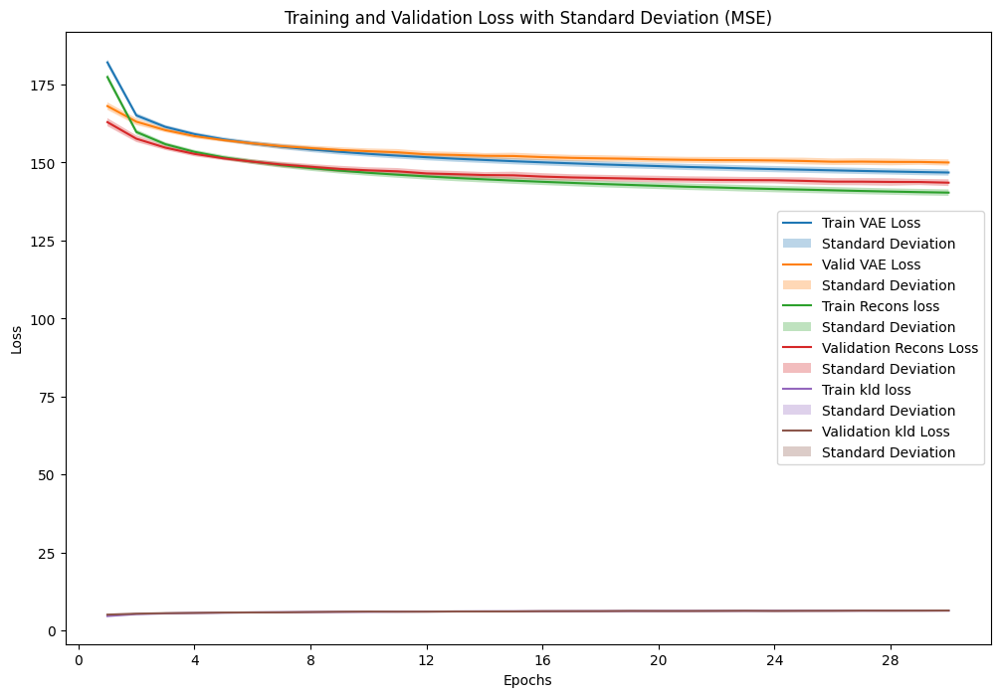

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_12.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_12 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_12_2 = VAE_plot_results(fold_results_3_12, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_12_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_12_2['epochs'])
    VAE_plot_mean_std(result_data_3_12_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_12_2['epochs'])
    VAE_plot_mean_std(result_data_3_12_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_12_2['epochs'])
    VAE_plot_mean_std(result_data_3_12_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_12_2['epochs'])
    VAE_plot_mean_std(result_data_3_12_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_12_2['epochs'])
    VAE_plot_mean_std(result_data_3_12_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_12_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_12_2['valid_metrics'],
    result_data_3_12_2['test_metrics'],
    result_data_3_12_2['valid_result'],
    result_data_3_12_2['test_result'],
    result_data_3_12_2['recons_valid_result'],
    result_data_3_12_2['recons_test_result'],
    result_data_3_12_2['kld_valid_result'],
    result_data_3_12_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.040876           0.040968           150.005272     149.999969              143.539841        143.539841             6.465432       6.452883
Standard Deviation                 0.000539           0.000593             1.005675       1.110329                1.101611          1.101611             0.121224       0.113465

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.040850,0.040857,150.301190,150.034041
1,2,0.040627,0.040483,149.642856,149.168265
2,3,0.040617,0.040361,149.347486,148.547878
3,4,0.041839,0.042221,151.837427,152.394619
4,5,0.040583,0.040666,149.285664,149.164283
5,6,0.041356,0.041602,151.055095,151.169927
6,7,0.040207,0.040406,148.784720,149.178661
7,8,0.040895,0.040842,150.389774,149.801694
8,9,0.041632,0.041599,150.858956,150.927979
9,10,0.040159,0.040643,148.549558,149.612347


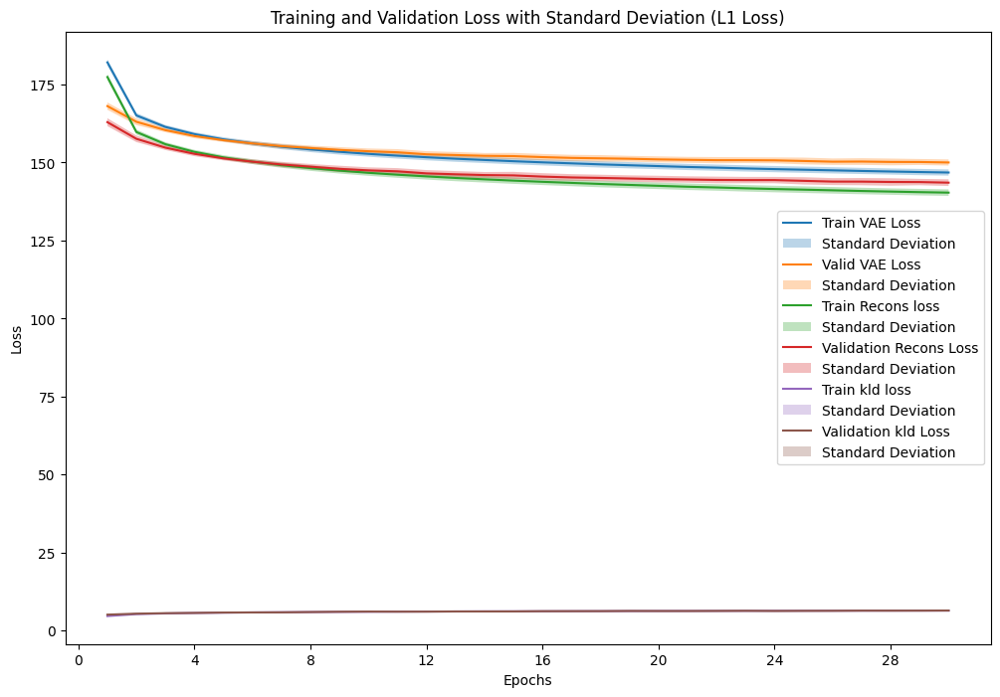

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_12.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_12 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_12_3 = VAE_plot_results(fold_results_3_12, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_12_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_12_3['epochs'])
    VAE_plot_mean_std(result_data_3_12_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_12_3['epochs'])
    VAE_plot_mean_std(result_data_3_12_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_12_3['epochs'])
    VAE_plot_mean_std(result_data_3_12_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_12_3['epochs'])
    VAE_plot_mean_std(result_data_3_12_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_12_3['epochs'])
    VAE_plot_mean_std(result_data_3_12_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_12_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_12_3['valid_metrics'],
    result_data_3_12_3['test_metrics'],
    result_data_3_12_3['valid_result'],
    result_data_3_12_3['test_result'],
    result_data_3_12_3['recons_valid_result'],
    result_data_3_12_3['recons_test_result'],
    result_data_3_12_3['kld_valid_result'],
    result_data_3_12_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.095856           0.096078           150.021380     149.996612              143.555948        143.555948             6.465432       6.452883
Standard Deviation                 0.001088           0.001136             0.986816       1.103738                1.082770          1.082770             0.121224       0.113465

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.096142,0.096194,150.344968,150.016619
1,2,0.095322,0.095300,149.655737,149.241467
2,3,0.094983,0.094746,149.262461,148.517218
3,4,0.098111,0.098362,151.851513,152.434574
4,5,0.095222,0.095371,149.334730,149.165450
5,6,0.096857,0.097121,151.016688,151.058393
6,7,0.094358,0.094913,148.870842,149.212553
7,8,0.095755,0.095468,150.433811,149.786049
8,9,0.096894,0.097461,150.825729,150.921144
9,10,0.094914,0.095840,148.617322,149.612658


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_12 = sum(p.numel() for p in models_3_12[0].parameters())
print(f"Number of parameters in the model: {total_params_3_12}")

Number of parameters in the model: 620156


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


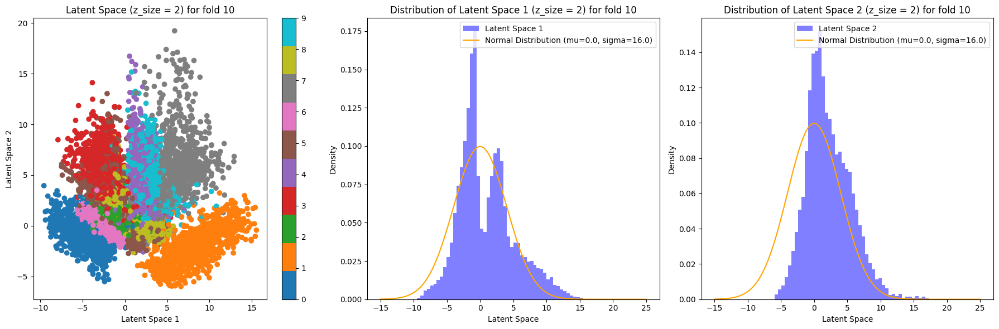

In [ ]:
x = np.linspace(-15, 25, 1000)
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)

std_2 = torch.tensor([[4,4]], dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_12[9], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

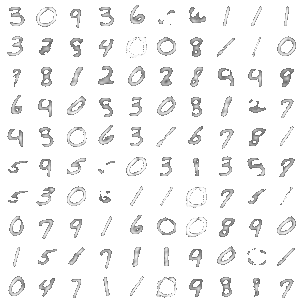

In [ ]:
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)

std_2 = torch.tensor([[4,4]], dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_12[9], mu, std, D_z=2, image_to_sample=100, nrow=10)

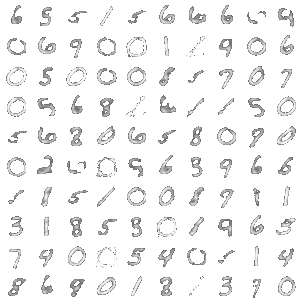

In [ ]:
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)

std_2 = torch.tensor([[4,4]], dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_12[9], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

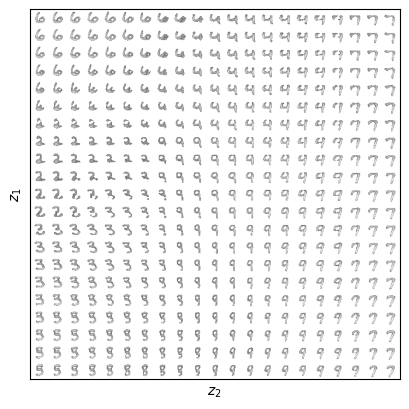

In [ ]:
VAE_visualize_latent_space(models_3_12[1], device)

### Experiment 3.1 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=2, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_13 = 'VAE'
model_config_3_13 = {'D_x': 784, 'n_layers': 2, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
#set_2_mean = torch.tensor([5,10], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)

#std_2 = torch.ones((1, 2), dtype=torch.float32)
std_2 = torch.tensor([1,3], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_3_13, fold_results_3_13 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_13),
                                                model_config=model_config_3_13,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=1,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })


Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:181.650919, Training Recons Loss: 176.610437, Training KLD Loss: 5.040482
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.048565781140264046, 'L1 Loss': 0.11265612488731425, 'BCE': 0.20635275748815943}, Validation VAE Loss: {'MSE': 166.59240073346078, 'L1 Loss': 166.64992929012217, 'BCE': 166.64281317528258}, Validation Recons Loss: {'MSE': 161.73014896473987, 'L1 Loss': 161.78767768372882, 'BCE': 161.78056173121675}, Validation KLD Loss: {'MSE': 4.862252012212226, 'L1 Loss': 4.862252012212226, 'BCE': 4.862252012212226}
Train Fold/Epoch: 1/2, Training Loss:164.444925, Training Recons Loss: 159.360428, Training KLD Loss: 5.084496
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.046833053469023805, 'L1 Loss': 0.10940733337973027, 'BCE': 0.2007955604411186}, Validation VAE Loss: {'MSE': 

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_13.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_13.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_13, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_13, f)


## Visualizing reconstructions for all fold

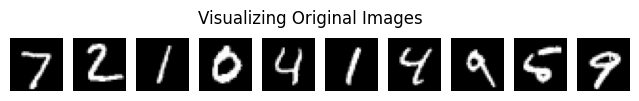

Visualizing reconstructions for fold 1


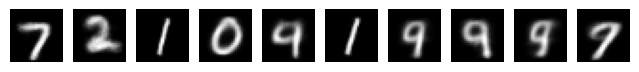

Visualizing reconstructions for fold 2


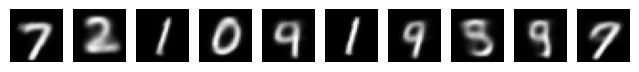

Visualizing reconstructions for fold 3


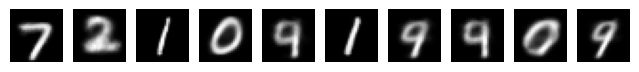

Visualizing reconstructions for fold 4


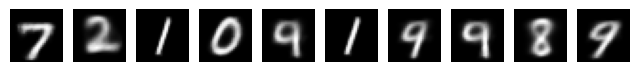

Visualizing reconstructions for fold 5


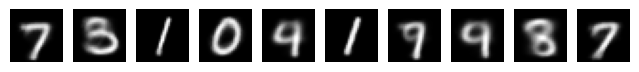

Visualizing reconstructions for fold 6


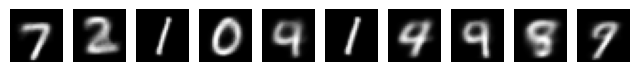

Visualizing reconstructions for fold 7


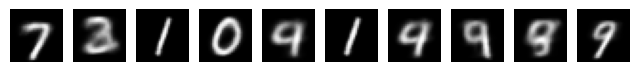

Visualizing reconstructions for fold 8


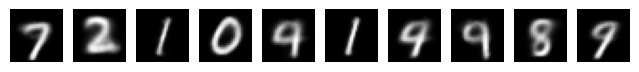

Visualizing reconstructions for fold 9


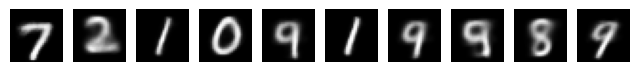

Visualizing reconstructions for fold 10


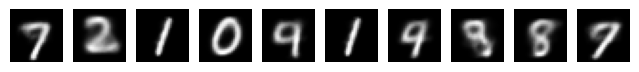

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_13.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_13 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_13):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

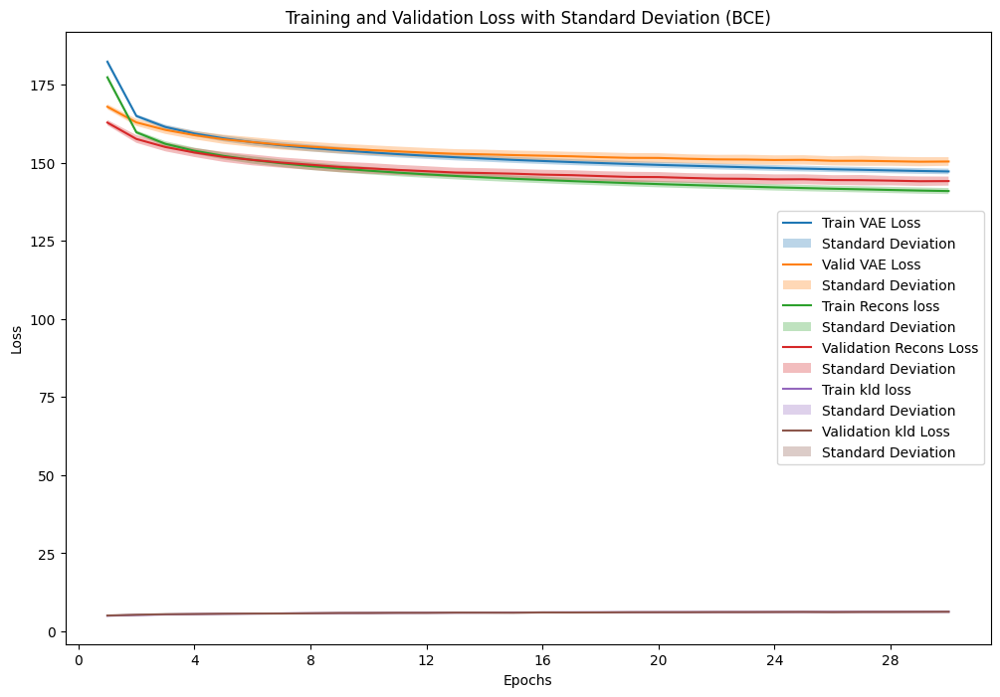

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_13.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_13 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_13_1 = VAE_plot_results(fold_results_3_13, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_13_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_13_1['epochs'])
    VAE_plot_mean_std(result_data_3_13_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_13_1['epochs'])
    VAE_plot_mean_std(result_data_3_13_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_13_1['epochs'])
    VAE_plot_mean_std(result_data_3_13_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_13_1['epochs'])
    VAE_plot_mean_std(result_data_3_13_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_13_1['epochs'])
    VAE_plot_mean_std(result_data_3_13_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_13_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_13_1['valid_metrics'],
    result_data_3_13_1['test_metrics'],
    result_data_3_13_1['valid_result'],
    result_data_3_13_1['test_result'],
    result_data_3_13_1['recons_valid_result'],
    result_data_3_13_1['recons_test_result'],
    result_data_3_13_1['kld_valid_result'],
    result_data_3_13_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.183862           0.183505           150.414122     150.119425              144.148136        144.148136             6.265986       6.251668
Standard Deviation                 0.001836           0.001549             1.370780       1.112668                1.439234          1.439234             0.144335       0.151073

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.184568,0.184606,150.892413,150.916261
1,2,0.183172,0.182664,149.942642,149.536288
2,3,0.187875,0.187103,153.279485,152.639661
3,4,0.182593,0.182015,149.383938,148.956225
4,5,0.184980,0.184932,151.253930,151.200071
5,6,0.182229,0.181865,149.441462,149.150749
6,7,0.182453,0.182306,149.232419,149.092211
7,8,0.185810,0.183717,152.066313,150.414295
8,9,0.183323,0.182868,150.000640,149.623636
9,10,0.181620,0.182972,148.647979,149.664853


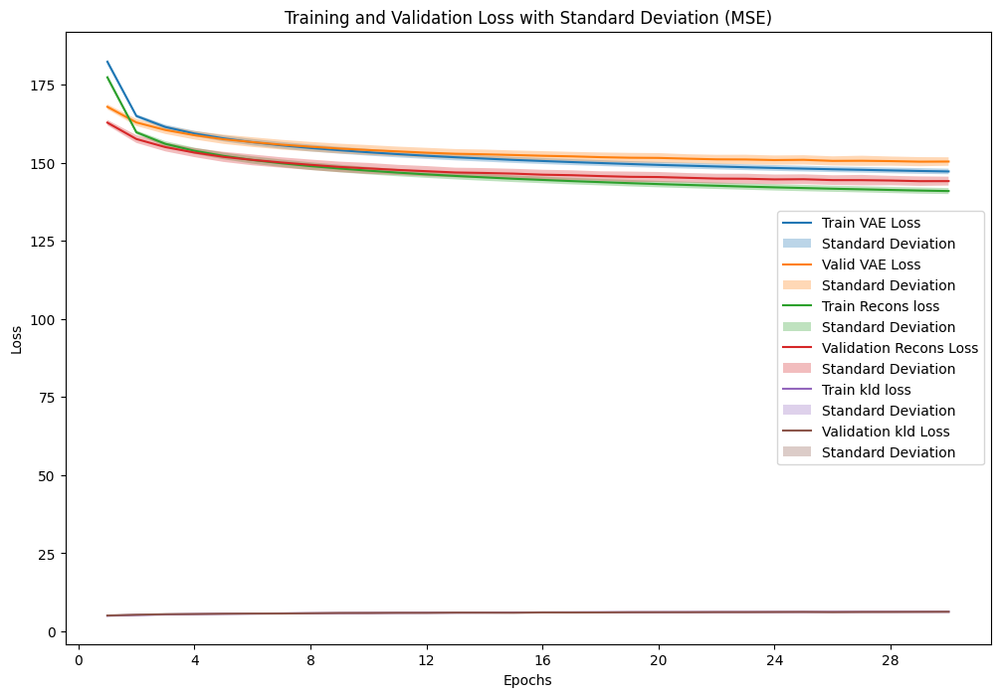

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_13.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_13 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_13_2 = VAE_plot_results(fold_results_3_13, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_13_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_13_2['epochs'])
    VAE_plot_mean_std(result_data_3_13_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_13_2['epochs'])
    VAE_plot_mean_std(result_data_3_13_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_13_2['epochs'])
    VAE_plot_mean_std(result_data_3_13_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_13_2['epochs'])
    VAE_plot_mean_std(result_data_3_13_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_13_2['epochs'])
    VAE_plot_mean_std(result_data_3_13_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_13_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_13_2['valid_metrics'],
    result_data_3_13_2['test_metrics'],
    result_data_3_13_2['valid_result'],
    result_data_3_13_2['test_result'],
    result_data_3_13_2['recons_valid_result'],
    result_data_3_13_2['recons_test_result'],
    result_data_3_13_2['kld_valid_result'],
    result_data_3_13_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.041037           0.041007           150.413667     150.100717              144.147681        144.147681             6.265986       6.251668
Standard Deviation                 0.000642           0.000535             1.395082       1.120558                1.462690          1.462690             0.144335       0.151073

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.041063,0.041227,150.829628,150.859761
1,2,0.040833,0.040706,150.033267,149.535574
2,3,0.042533,0.042307,153.288142,152.628634
3,4,0.040542,0.040446,149.412070,148.978771
4,5,0.041401,0.041494,151.406297,151.256278
5,6,0.040443,0.040513,149.428773,149.095208
6,7,0.040761,0.040713,149.258301,149.059678
7,8,0.041686,0.041146,152.060884,150.389694
8,9,0.040826,0.040703,149.908283,149.588841
9,10,0.040282,0.040808,148.511021,149.614727


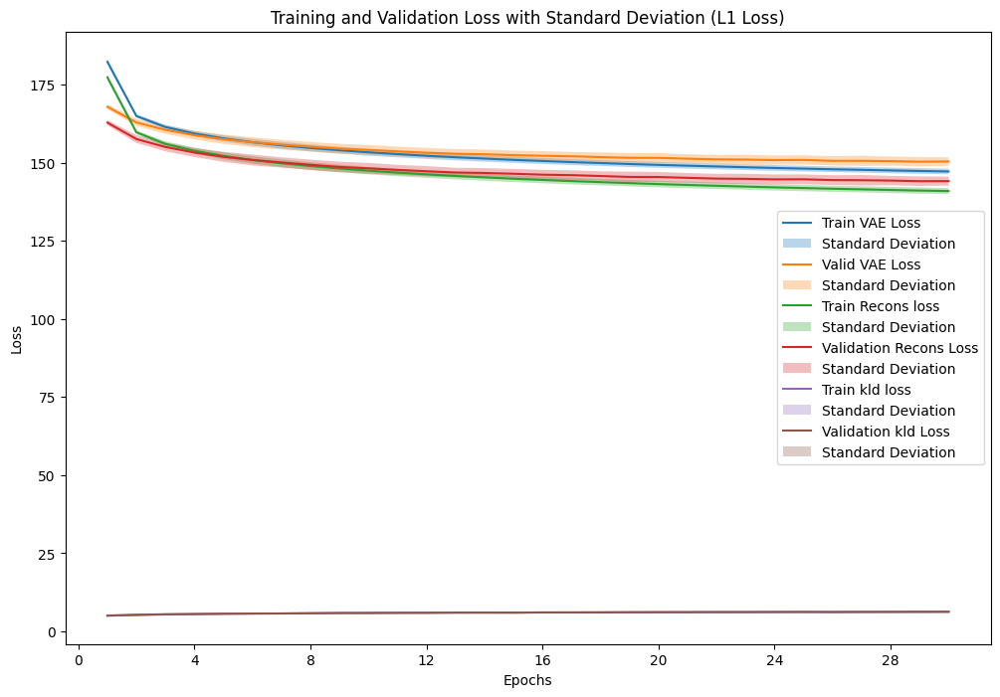

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_13.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_13 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_13_3 = VAE_plot_results(fold_results_3_13, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_13_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_13_3['epochs'])
    VAE_plot_mean_std(result_data_3_13_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_13_3['epochs'])
    VAE_plot_mean_std(result_data_3_13_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_13_3['epochs'])
    VAE_plot_mean_std(result_data_3_13_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_13_3['epochs'])
    VAE_plot_mean_std(result_data_3_13_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_13_3['epochs'])
    VAE_plot_mean_std(result_data_3_13_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_13_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_13_3['valid_metrics'],
    result_data_3_13_3['test_metrics'],
    result_data_3_13_3['valid_result'],
    result_data_3_13_3['test_result'],
    result_data_3_13_3['recons_valid_result'],
    result_data_3_13_3['recons_test_result'],
    result_data_3_13_3['kld_valid_result'],
    result_data_3_13_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.096380           0.096472           150.405188     150.116331              144.139202        144.139202             6.265986       6.251668
Standard Deviation                 0.001051           0.000920             1.354056       1.113669                1.420906          1.420906             0.144335       0.151073

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.096038,0.096477,150.876042,150.834425
1,2,0.095492,0.095488,149.865447,149.543047
2,3,0.098928,0.098729,153.212474,152.679435
3,4,0.095663,0.095615,149.410546,148.989045
4,5,0.097084,0.097331,151.197330,151.206332
5,6,0.095580,0.095653,149.503032,149.132354
6,7,0.096026,0.096039,149.283765,149.123849
7,8,0.097331,0.096669,152.090081,150.410886
8,9,0.096256,0.096278,150.013613,149.598509
9,10,0.095403,0.096440,148.599550,149.645424


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_13 = sum(p.numel() for p in models_3_13[0].parameters())
print(f"Number of parameters in the model: {total_params_3_13}")

Number of parameters in the model: 620156


<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


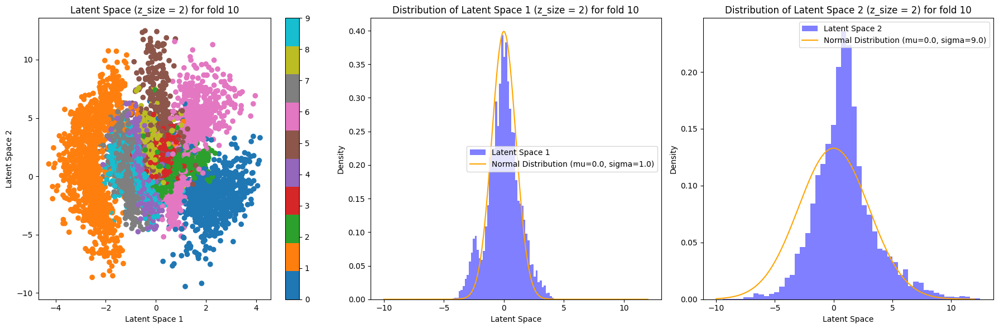

In [ ]:
x = np.linspace(-10, 12, 1000)
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
std_2 = torch.tensor([[1,3]], dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_13[9], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

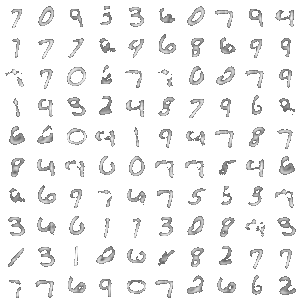

In [ ]:
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
std_2 = torch.tensor([[1,3]], dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_13[9], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

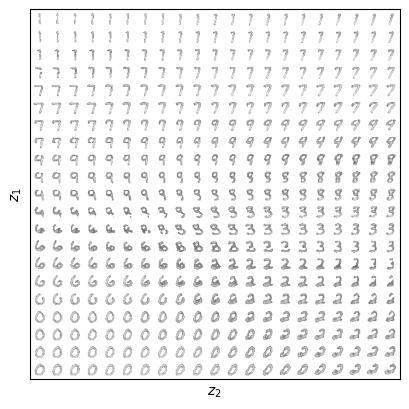

In [ ]:
VAE_visualize_latent_space(models_3_13[9], device)

### Experiment 3.1 : AE with 1 layer

- Model: VAE of 1 layer, D_x=784, D_z=2, activation is RELU
- Loss: Gaussian likelihood
- Training with ADAM, LR=1e-3, for 30 epochs

In [ ]:
#  use gpu if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VAE_model_name_3_14 = 'VAE'
model_config_3_14 = {'D_x': 784, 'n_layers': 2, 'D_z': 2, 'activation': nn.ReLU}
learning_rate = 1e-3
batch_size=64
training_setup = {
    # Adam optimizer with given learning rate
    # 'optimizer' : torch.optim.Adam(
    #     AE_model_1.parameters(), # Model parameters
    #     learning_rate #LR
    #   ),
    'epochs' : 30,
    'criterion' : VAE_criterion,
    'device' : device,
    'VAE_likelihood' : 'bernoulli'
}
# Define a dataset
train_dataset = train_loader.dataset
test_dataset = test_loader.dataset
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
#set_2_mean = torch.tensor([5,10], dtype=torch.float32)
#set_2_mean = torch.randn([1, 2], dtype=torch.float32)

#std_2 = torch.ones((1, 2), dtype=torch.float32)
std_2 = torch.tensor([3,1], dtype=torch.float32)
#std_2 = torch.randn([1, 2], dtype=torch.float32)
models_3_14, fold_results_3_14 = VAE_k_fold_cross_validation(
                                                model_class=getattr(sys.modules[__name__], VAE_model_name_3_14),
                                                model_config=model_config_3_14,
                                                train_dataset =train_dataset,
                                                test_dataset = test_dataset,
                                                VAE_criterion= VAE_criterion,
                                                learning_rate=learning_rate,
                                                training_setup= training_setup,
                                                beta=1,
                                                set_2_mean = set_2_mean,
                                                var_2= torch.pow(std_2, 2),
                                                L=1,
                                                k_folds=10,
                                                batch_size=batch_size,
                                                eval_criterions={
                                                'MSE': torch.nn.MSELoss(),
                                                'L1 Loss': torch.nn.L1Loss(),
                                                'BCE': torch.nn.BCELoss()
                                                      })


Fold 1/10
54000
6000
Dataset MNIST
    Number of datapoints: 10000
    Root location: ./data
    Split: Test
    StandardTransform
Transform: ToTensor()
Train Fold/Epoch: 1/1, Training Loss:182.523565, Training Recons Loss: 177.490692, Training KLD Loss: 5.032872
Validation Fold/Epoch: 1/1,  Validation Loss: {'MSE': 0.04961745052578601, 'L1 Loss': 0.11375580006774436, 'BCE': 0.2082684189081192}, Validation VAE Loss: {'MSE': 168.5989069837205, 'L1 Loss': 168.63667378527052, 'BCE': 168.60755871711893}, Validation Recons Loss: {'MSE': 163.2737894261137, 'L1 Loss': 163.31155622766374, 'BCE': 163.28244099718458}, Validation KLD Loss: {'MSE': 5.325116989460398, 'L1 Loss': 5.325116989460398, 'BCE': 5.325116989460398}
Train Fold/Epoch: 1/2, Training Loss:164.799870, Training Recons Loss: 159.404961, Training KLD Loss: 5.394909
Validation Fold/Epoch: 1/2,  Validation Loss: {'MSE': 0.04709996390057371, 'L1 Loss': 0.10972693847849015, 'BCE': 0.20081289619841475}, Validation VAE Loss: {'MSE': 162.

### Create the directory and save it in My Drive

In [ ]:
# Define the directory path
directory = '/content/drive/MyDrive/Master Thesis/Study the impact of $\\prior$/Prior/experience_3_1/'
# Create the directory
if not os.path.exists(directory):
    os.makedirs(directory)
# Define file paths
models_file_path = os.path.join(directory, 'models_3_14.pkl')
fold_results_file_path = os.path.join(directory, 'fold_results_3_14.pkl')

In [ ]:
# Save models_3_1
with open(models_file_path, 'wb') as f:
    pickle.dump(models_3_14, f)

# Save fold_results_3_1
with open(fold_results_file_path, 'wb') as f:
    pickle.dump(fold_results_3_14, f)


## Visualizing reconstructions for all fold

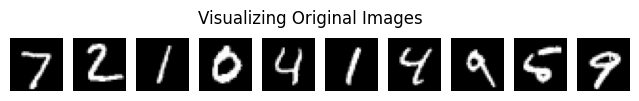

Visualizing reconstructions for fold 1


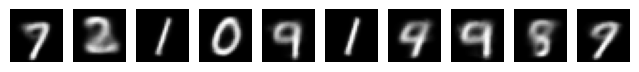

Visualizing reconstructions for fold 2


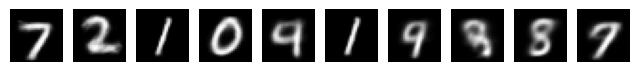

Visualizing reconstructions for fold 3


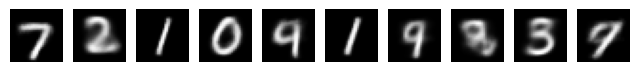

Visualizing reconstructions for fold 4


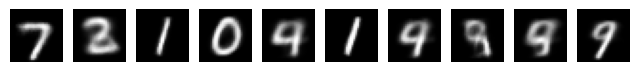

Visualizing reconstructions for fold 5


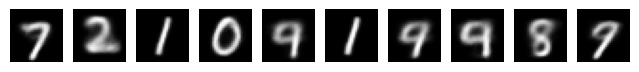

Visualizing reconstructions for fold 6


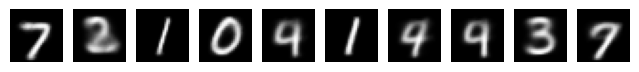

Visualizing reconstructions for fold 7


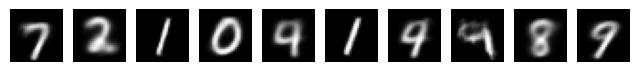

Visualizing reconstructions for fold 8


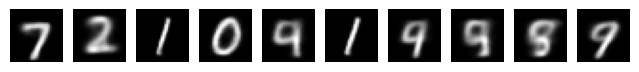

Visualizing reconstructions for fold 9


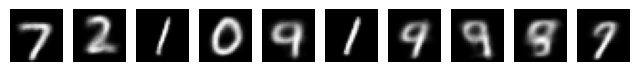

Visualizing reconstructions for fold 10


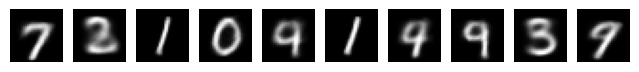

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'models_3_14.pkl')

# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        models_3_14 = pickle.load(f)

    # Iterate over the loaded models
    VAE_visualize_original_images(test_loader, img_shape=(28, 28))
    for fold_index, model_to_visualize in enumerate(models_3_14):
        print(f"Visualizing reconstructions for fold {fold_index + 1}")
        VAE_visualize_reconstructions(model_to_visualize, test_loader, img_shape, L=1, device=device, num_samples=10, fold_index=fold_index + 1, figure_size=(8, 2))

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)

### Plot Training Loss and Validation Loss functions with Standard Deviation

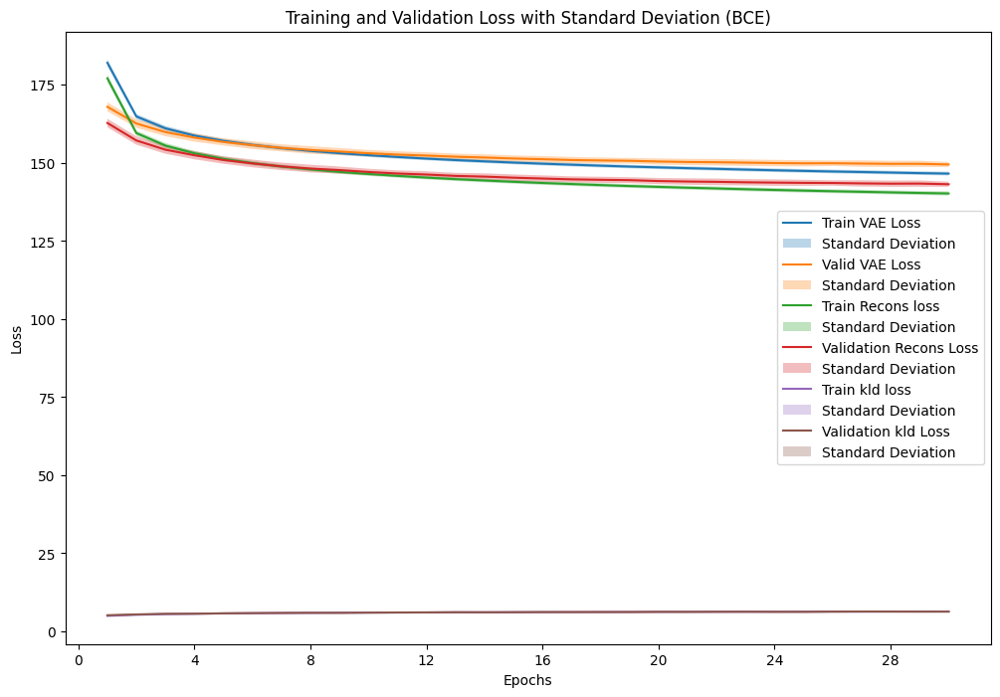

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_14.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_14 = pickle.load(f)

    loss_type_to_plot = 'BCE'   # We can change this to our desired loss type
    result_data_3_14_1 = VAE_plot_results(fold_results_3_14, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_14_1['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_14_1['epochs'])
    VAE_plot_mean_std(result_data_3_14_1['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_14_1['epochs'])
    VAE_plot_mean_std(result_data_3_14_1['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_14_1['epochs'])
    VAE_plot_mean_std(result_data_3_14_1['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_14_1['epochs'])
    VAE_plot_mean_std(result_data_3_14_1['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_14_1['epochs'])
    VAE_plot_mean_std(result_data_3_14_1['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_14_1['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_14_1['valid_metrics'],
    result_data_3_14_1['test_metrics'],
    result_data_3_14_1['valid_result'],
    result_data_3_14_1['test_result'],
    result_data_3_14_1['recons_valid_result'],
    result_data_3_14_1['recons_test_result'],
    result_data_3_14_1['kld_valid_result'],
    result_data_3_14_1['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.182597           0.182280           149.492042     149.220249              143.156016        143.156016             6.336026       6.313073
Standard Deviation                 0.001061           0.000565             0.827428       0.426728                0.831845          0.831845             0.089865       0.086467

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.182622,0.182840,149.504341,149.636050
1,2,0.182525,0.181860,149.384144,148.872933
2,3,0.182840,0.181924,149.564909,148.795998
3,4,0.183048,0.183032,149.870001,149.860373
4,5,0.182665,0.182701,149.447952,149.443504
5,6,0.182920,0.181937,149.735559,148.957248
6,7,0.180998,0.181120,148.451264,148.491644
7,8,0.184798,0.182540,151.299534,149.495574
8,9,0.182810,0.182786,149.668589,149.633010
9,10,0.180743,0.182055,147.994127,149.016160


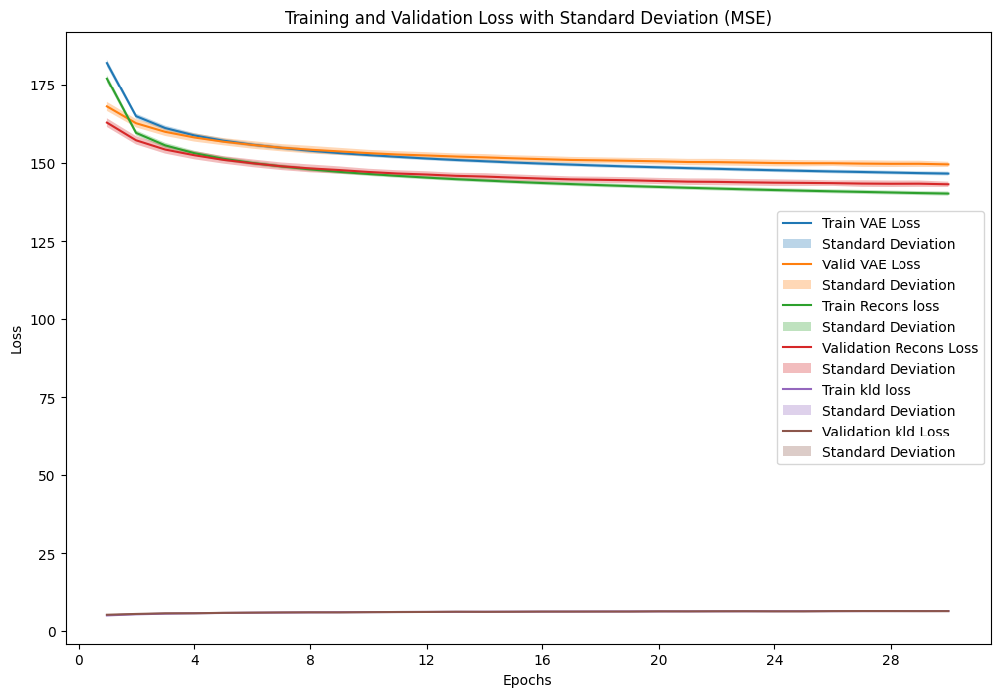

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_14.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_14 = pickle.load(f)

    loss_type_to_plot = 'MSE'   # We can change this to our desired loss type
    result_data_3_14_2 = VAE_plot_results(fold_results_3_14, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_14_2['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_14_2['epochs'])
    VAE_plot_mean_std(result_data_3_14_2['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_14_2['epochs'])
    VAE_plot_mean_std(result_data_3_14_2['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_14_2['epochs'])
    VAE_plot_mean_std(result_data_3_14_2['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_14_2['epochs'])
    VAE_plot_mean_std(result_data_3_14_2['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_14_2['epochs'])
    VAE_plot_mean_std(result_data_3_14_2['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_14_2['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_14_2['valid_metrics'],
    result_data_3_14_2['test_metrics'],
    result_data_3_14_2['valid_result'],
    result_data_3_14_2['test_result'],
    result_data_3_14_2['recons_valid_result'],
    result_data_3_14_2['recons_test_result'],
    result_data_3_14_2['kld_valid_result'],
    result_data_3_14_2['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.040672           0.040652           149.492444     149.196428              143.156419        143.156419             6.336026       6.313073
Standard Deviation                 0.000290           0.000212             0.816633       0.419201                0.821639          0.821639             0.089865       0.086467

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.040574,0.040826,149.451470,149.625554
1,2,0.040621,0.040426,149.463268,148.871641
2,3,0.040676,0.040445,149.533671,148.770908
3,4,0.040845,0.040947,149.896776,149.886894
4,5,0.040651,0.040747,149.421048,149.414361
5,6,0.040793,0.040673,149.772582,148.949949
6,7,0.040182,0.040262,148.437717,148.510946
7,8,0.041179,0.040637,151.276104,149.457624
8,9,0.040975,0.040930,149.630139,149.521043
9,10,0.040230,0.040626,148.041670,148.955355


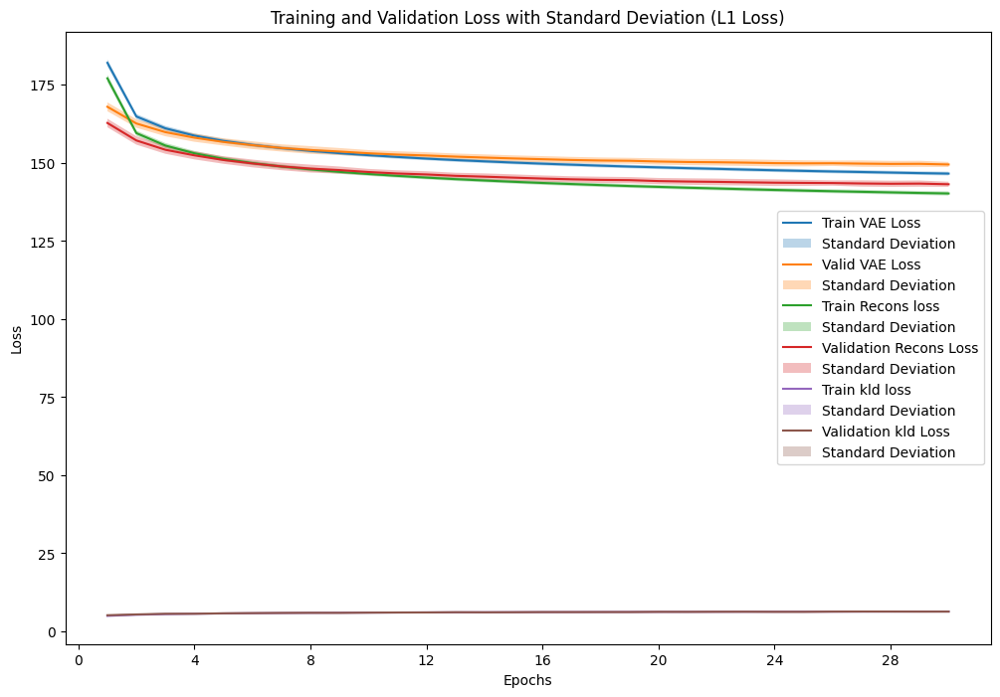

In [ ]:
# Define the directory and file path using raw string literals
directory = r'/content/drive/MyDrive/Master Thesis/Study the impact of $\prior$/Prior/experience_3_1/'
file_path = os.path.join(directory, 'fold_results_3_14.pkl')
# Load the models from the pickle file
try:
    with open(file_path, 'rb') as f:
        fold_results_3_14 = pickle.load(f)

    loss_type_to_plot = 'L1 Loss'   # We can change this to our desired loss type
    result_data_3_14_3 = VAE_plot_results(fold_results_3_14, loss_type_to_plot)

    fig, ax = plt.subplots(figsize=(12, 8))
    VAE_plot_mean_std(result_data_3_14_3['train_losses'], 'Training and Validation Loss', ax, 'Train VAE Loss', result_data_3_14_3['epochs'])
    VAE_plot_mean_std(result_data_3_14_3['val_losses'], 'Training and Validation Loss', ax, 'Valid VAE Loss', result_data_3_14_3['epochs'])
    VAE_plot_mean_std(result_data_3_14_3['train_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Train Recons loss', result_data_3_14_3['epochs'])
    VAE_plot_mean_std(result_data_3_14_3['val_recons_losses'], 'Training and Validation Recontruction Loss', ax, 'Validation Recons Loss', result_data_3_14_3['epochs'])
    VAE_plot_mean_std(result_data_3_14_3['train_kld_losses'], 'Training and Validation KLD Loss', ax, 'Train kld loss', result_data_3_14_3['epochs'])
    VAE_plot_mean_std(result_data_3_14_3['val_kld_losses'], 'Training and Validation KLD Loss', ax, 'Validation kld Loss', result_data_3_14_3['epochs'])
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.set_title(f'Training and Validation Loss with Standard Deviation ({loss_type_to_plot})')
    ax.legend()
    plt.show()

except FileNotFoundError:
    print(f"File '{file_path}' not found.")
except Exception as e:
    print("An error occurred:", e)


In [ ]:
print_evaluation_table(
    result_data_3_14_3['valid_metrics'],
    result_data_3_14_3['test_metrics'],
    result_data_3_14_3['valid_result'],
    result_data_3_14_3['test_result'],
    result_data_3_14_3['recons_valid_result'],
    result_data_3_14_3['recons_test_result'],
    result_data_3_14_3['kld_valid_result'],
    result_data_3_14_3['kld_test_result']
)



Mean and Standard Deviation Table:
            Metric  Validation Metrics Loss  Test Metrics Loss  Validation VAE Loss  Test VAE Loss  Validation Recons Loss  Test Recons Loss  Validation KLD Loss  Test KLD Loss
              Mean                 0.095646           0.095791           149.482170     149.219776              143.146144        143.146144             6.336026       6.313073
Standard Deviation                 0.000634           0.000444             0.815311       0.390418                0.820659          0.820659             0.089865       0.086467

Detailed Evaluation Table:


,Fold,Validation Metrics Loss,Test Metrics Loss,Validation Loss,Test Loss
0,1,0.095450,0.095859,149.416473,149.542815
1,2,0.094874,0.094780,149.394097,148.918507
2,3,0.095870,0.095928,149.577395,148.875201
3,4,0.096070,0.096221,149.836926,149.887113
4,5,0.095938,0.096086,149.454075,149.410305
5,6,0.095883,0.095712,149.768280,148.961000
6,7,0.094884,0.095334,148.452345,148.591702
7,8,0.096981,0.096406,151.250801,149.523236
8,9,0.095667,0.095969,149.670252,149.538961
9,10,0.094837,0.095617,148.001054,148.948922


### Number of parameters

In [ ]:
# Count the number of parameters
total_params_3_14 = sum(p.numel() for p in models_3_14[0].parameters())
print(f"Number of parameters in the model: {total_params_3_14}")

Number of parameters in the model: 620156


<ipython-input-9-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


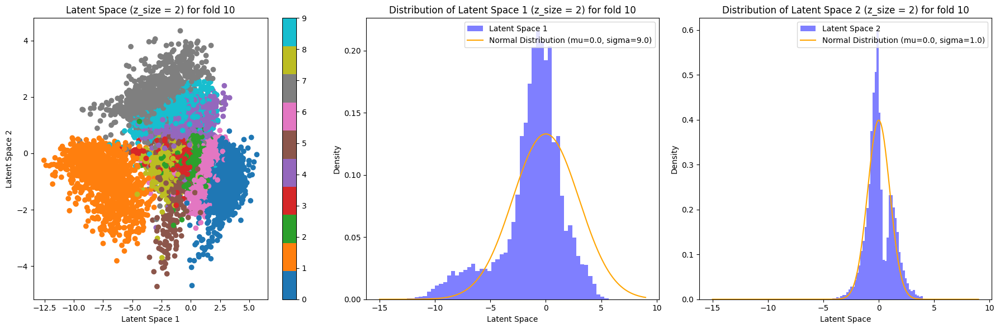

In [ ]:
x = np.linspace(-15, 9, 1000)
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
std_2 = torch.tensor([[3,1]], dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_14[9], mean, std, test_loader, device, x,number_fold=10)

<ipython-input-68-a66faf2092d1>:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('tab10', len(np.unique(labels)))


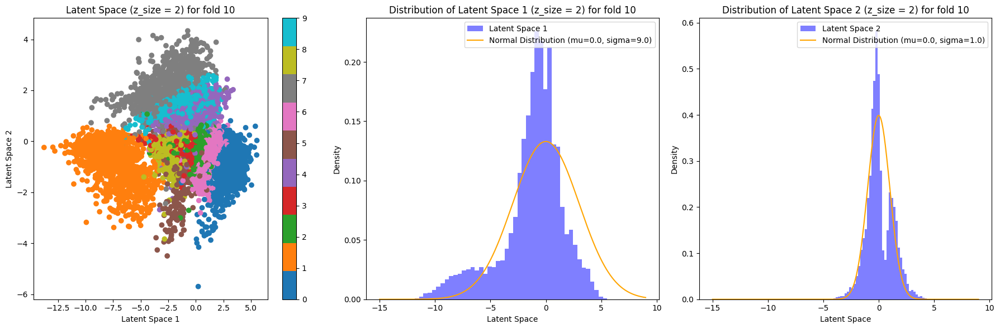

In [ ]:
x = np.linspace(-15, 9, 1000)
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
std_2 = torch.tensor([[3,1]], dtype=torch.float32)

mean = set_2_mean
std = std_2
latent_space_VAE_model(models_3_14[9], mean, std, test_loader, device, x,number_fold=10)

### Sample new data using the decoder.

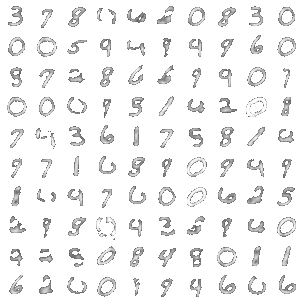

In [ ]:
set_2_mean = torch.zeros((1, 2), dtype=torch.float32)
std_2 = torch.tensor([[3,1]], dtype=torch.float32)

mu = set_2_mean
std = std_2
sample(models_3_14[9], mu, std, D_z=2, image_to_sample=100, nrow=10)

### Examine the influence of different values of the latent vector z on the results.


We can look at how different values in the latent vector z influence the results.

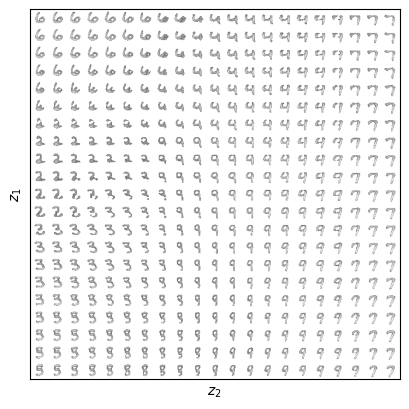

In [ ]:
VAE_visualize_latent_space(models_3_14[1], device)